# W5-H21: Using the GFF3 file that is well annotated, do:

1. Visualize the data as much as you can. How many genes/CDS/exon are listed for ENSEMBL and other datasets?
2. Plot a histogram of length information for a) entire genome, 2) for each source, i.e., ENSEMBL, Havana, etc. separately (can use subplot)
3. Parse the description column: Anything you can visualize? Visualize at least one thing.
4. Bonus question worth one homework score: Based on our dataset, how many transcripts does a gene typically have? What percentage of genes have more than 1 transcript? Hint: You will need to sum up the exon lengths to get the transcripts. You can use external libraries. 

Resources to check out
1. https://daler.github.io/gffutils/
2. http://seqanswers.com/forums/showthread.php?t=4914

In [18]:
import pandas as pd
pd.__version__ # good idea to report it when comparing code from different times
col_names = ['seqid', 'source', 'type', 'start', 'end', 'score', 'strand', 'phase', 'attributes'] #specified in README file
df = pd.read_csv('../datasets/Homo_sapiens.GRCh38.85.gff3.gz', compression='gzip',
                         sep='\t', comment='#', low_memory=False,
                         header=None, names=col_names)

# 1) Visualize the data as much as you can. How many genes/CDS/exon are listed for ENSEMBL and other datasets?

In [9]:
df

,seqid,source,type,start,end,score,strand,phase,attributes
0,1,GRCh38,chromosome,1,248956422,.,.,.,"ID=chromosome:1;Alias=CM000663.2,chr1,NC_00000..."
1,1,.,biological_region,10469,11240,1.3e+03,.,.,external_name=oe %3D 0.79;logic_name=cpg
2,1,.,biological_region,10650,10657,0.999,+,.,logic_name=eponine
3,1,.,biological_region,10655,10657,0.999,-,.,logic_name=eponine
4,1,.,biological_region,10678,10687,0.999,+,.,logic_name=eponine
...,...,...,...,...,...,...,...,...,...
2601844,Y,.,biological_region,26626966,26627137,0.994,-,.,external_name=rank %3D 1;logic_name=firstef
2601845,Y,.,biological_region,26627457,26628186,0.997,+,.,external_name=rank %3D 1;logic_name=firstef
2601846,Y,havana,gene,56855244,56855488,.,+,.,ID=gene:ENSG00000235857;Name=CTBP2P1;biotype=p...
2601847,Y,havana,processed_pseudogene,56855244,56855488,.,+,.,ID=transcript:ENST00000431853;Parent=gene:ENSG...


In [12]:
df_type=df[df.type.isin(['exon','CDS','gene'])]

<AxesSubplot:xlabel='source', ylabel='count'>

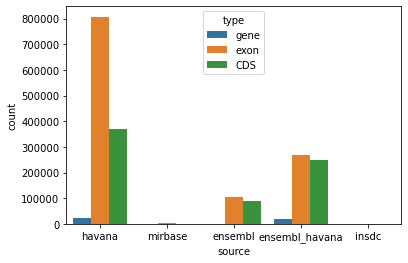

In [13]:
import seaborn as sns
sns.countplot(x="source", data=df_type,hue="type")

The graph above depicts how many genes,exons, and CDS exist in each dataset within the GFF3 file. 

# 2) Plot a histogram of length information for a) entire genome, 2) for each source, i.e., ENSEMBL, Havana, etc. separately (can use subplot)

In [19]:
ndf = df[df.type == 'gene']

In [20]:
import re 
RE_GENE_ID = re.compile(r'gene_id=(?P<gene_id>ENSG.+?);')
def extract_gene_id(attributes_str):
    res = RE_GENE_ID.search(attributes_str)
    return res.group('gene_id')

ndf['gene_id'] = ndf.attributes.apply(extract_gene_id)

<ipython-input-20-539b0e7da8c5>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ndf['gene_id'] = ndf.attributes.apply(extract_gene_id)


In [21]:

RE_GENE_DESC = re.compile(r'description=(?P<description>.+?);')
def extract_gene_desc(attributes_str):
    res = RE_GENE_DESC.search(attributes_str)
    if res is None:
        return ''
    else:
        return res.group('description')

ndf['description'] = ndf.attributes.apply(extract_gene_desc)

<ipython-input-21-c5792d3a9973>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ndf['description'] = ndf.attributes.apply(extract_gene_desc)


In [22]:
# After everything is extracted, we won’t use the attributes column anymore, so let’s drop it to keep things nice and clean with the method .drop:
ndf.drop('attributes', axis=1, inplace=True)
ndf.head()

/mnt/d/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,seqid,source,type,start,end,score,strand,phase,gene_id,description
16,1,havana,gene,11869,14409,.,+,.,ENSG00000223972,DEAD/H-box helicase 11 like 1 [Source:HGNC Sym...
28,1,havana,gene,14404,29570,.,-,.,ENSG00000227232,WAS protein family homolog 7 pseudogene [Sourc...
71,1,havana,gene,52473,53312,.,+,.,ENSG00000268020,olfactory receptor family 4 subfamily G member...
74,1,havana,gene,62948,63887,.,+,.,ENSG00000240361,olfactory receptor family 4 subfamily G member...
77,1,ensembl_havana,gene,69091,70008,.,+,.,ENSG00000186092,olfactory receptor family 4 subfamily F member...


In [24]:
ndf['length'] = ndf.end - ndf.start + 1 

<ipython-input-24-adbe0fdb6d60>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ndf['length'] = ndf.end - ndf.start + 1


In [25]:
ndf

,seqid,source,type,start,end,score,strand,phase,gene_id,description,length
16,1,havana,gene,11869,14409,.,+,.,ENSG00000223972,DEAD/H-box helicase 11 like 1 [Source:HGNC Sym...,2541
28,1,havana,gene,14404,29570,.,-,.,ENSG00000227232,WAS protein family homolog 7 pseudogene [Sourc...,15167
71,1,havana,gene,52473,53312,.,+,.,ENSG00000268020,olfactory receptor family 4 subfamily G member...,840
74,1,havana,gene,62948,63887,.,+,.,ENSG00000240361,olfactory receptor family 4 subfamily G member...,940
77,1,ensembl_havana,gene,69091,70008,.,+,.,ENSG00000186092,olfactory receptor family 4 subfamily F member...,918
...,...,...,...,...,...,...,...,...,...,...,...
2601818,Y,havana,gene,26549425,26549743,.,+,.,ENSG00000224240,cytochrome c%2C somatic pseudogene 49 [Source:...,319
2601821,Y,havana,gene,26586642,26591601,.,-,.,ENSG00000227629,solute carrier family 25 member 15 pseudogene ...,4960
2601826,Y,havana,gene,26594851,26634652,.,-,.,ENSG00000237917,poly(ADP-ribose) polymerase family member 4 ps...,39802
2601841,Y,havana,gene,26626520,26627159,.,-,.,ENSG00000231514,family with sequence similarity 58 member C%2C...,640


# a) Entire Genome Length Histogram

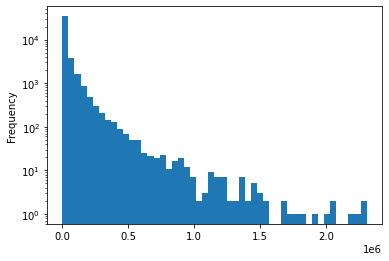

In [32]:
import matplotlib.pyplot as plt
ndf.length.plot(kind='hist', bins=50, logy=True)
plt.show()

# b) Havana Length Histogram

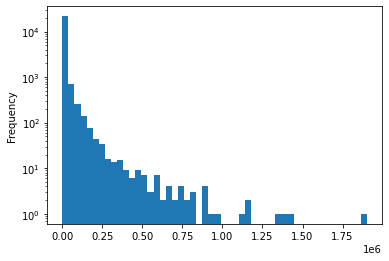

In [34]:
ndf[ndf.source == 'havana'].length.plot(kind='hist', bins=50, logy=True)
plt.show()

# c) Ensembl_Havana Length Histogram

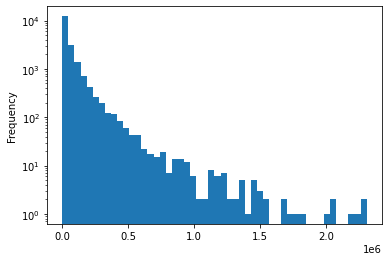

In [35]:
ndf[ndf.source == 'ensembl_havana'].length.plot(kind='hist', bins=50, logy=True)
plt.show()

# d) Ensembl Length Histogram

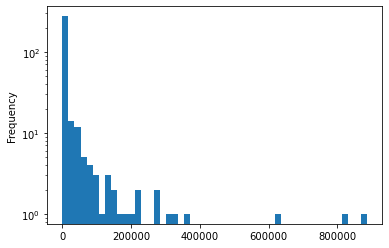

In [36]:
ndf[ndf.source == 'ensembl'].length.plot(kind='hist', bins=50, logy=True)
plt.show()

# e) INSDC Length Histogram

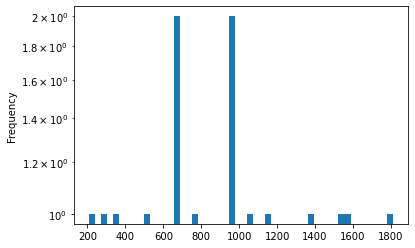

In [37]:
ndf[ndf.source == 'insdc'].length.plot(kind='hist', bins=50, logy=True)
plt.show()

# 3) Parse the description column: Anything you can visualize? Visualize at least one thing.

In [38]:
ndf

,seqid,source,type,start,end,score,strand,phase,gene_id,description,length
16,1,havana,gene,11869,14409,.,+,.,ENSG00000223972,DEAD/H-box helicase 11 like 1 [Source:HGNC Sym...,2541
28,1,havana,gene,14404,29570,.,-,.,ENSG00000227232,WAS protein family homolog 7 pseudogene [Sourc...,15167
71,1,havana,gene,52473,53312,.,+,.,ENSG00000268020,olfactory receptor family 4 subfamily G member...,840
74,1,havana,gene,62948,63887,.,+,.,ENSG00000240361,olfactory receptor family 4 subfamily G member...,940
77,1,ensembl_havana,gene,69091,70008,.,+,.,ENSG00000186092,olfactory receptor family 4 subfamily F member...,918
...,...,...,...,...,...,...,...,...,...,...,...
2601818,Y,havana,gene,26549425,26549743,.,+,.,ENSG00000224240,cytochrome c%2C somatic pseudogene 49 [Source:...,319
2601821,Y,havana,gene,26586642,26591601,.,-,.,ENSG00000227629,solute carrier family 25 member 15 pseudogene ...,4960
2601826,Y,havana,gene,26594851,26634652,.,-,.,ENSG00000237917,poly(ADP-ribose) polymerase family member 4 ps...,39802
2601841,Y,havana,gene,26626520,26627159,.,-,.,ENSG00000231514,family with sequence similarity 58 member C%2C...,640


In [59]:
descript=pd.DataFrame(ndf.groupby('description').count().iloc[:, 0].sort_values().iloc[::-1])

In [63]:
descript=descript.iloc[1: , :]

In [67]:
descript=descript[descript.seqid>1]

In [78]:
descript=descript.reset_index()

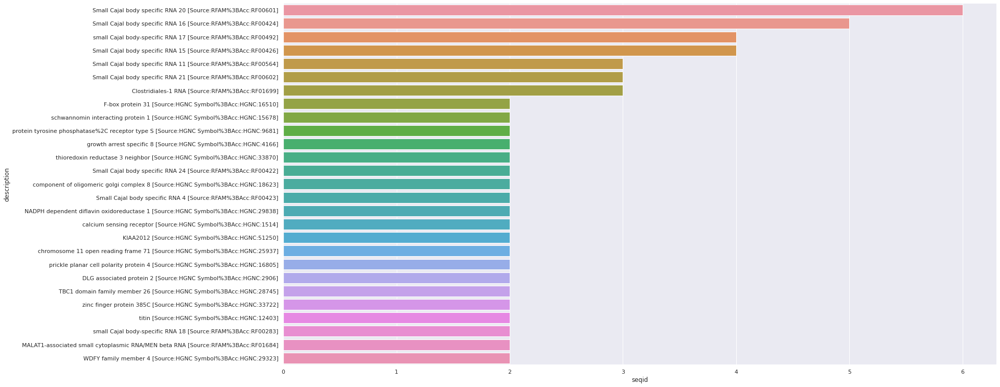

In [88]:
sns.barplot(y="description", x="seqid",data=descript)
sns.set(rc = {'figure.figsize':(25,13)})
sns.despine()

The figure above depicts the most common descriptions in the gff file for genes. It was created by sorting by the description column and removing any descriptiosn with a count value less than or equal to 1, as it is not feasible to graph every description. 

# Bonus question worth one homework score: Based on our dataset, how many transcripts does a gene typically have? What percentage of genes have more than 1 transcript? Hint: You will need to sum up the exon lengths to get the transcripts. You can use external libraries.

In [89]:
!pip install gffutils

     |████████████████████████████████| 1.5 MB 1.0 MB/s eta 0:00:01
     |████████████████████████████████| 100 kB 758 kB/s ta 0:00:01
     |████████████████████████████████| 139 kB 5.0 MB/s eta 0:00:01
  Created wheel for gffutils: filename=gffutils-0.10.1-py3-none-any.whl size=1608576 sha256=6641778cc99a837551bca4f2e4d0195863eb74e84b349fbd0f01b40e4849a35e
  Stored in directory: /home/curryofdoom/.cache/pip/wheels/06/a4/da/2249408eda1228acb63ed541711e6c3223df82f44d21ca4777
  Created wheel for pyfaidx: filename=pyfaidx-0.6.4-py3-none-any.whl size=26534 sha256=93163cc22c7e145fa192e3079743e766b54e9b8ffbe278e8421be0b6a7395212
  Stored in directory: /home/curryofdoom/.cache/pip/wheels/69/1a/ed/3aeabcde729be760a10f763b5a6b0b2c8af3d2023a98be8a61
Successfully built gffutils pyfaidx


In [92]:
!gunzip -c ../datasets/Homo_sapiens.GRCh38.85.gff3.gz 

##gff-version   3
##sequence-region   1 1 248956422
##sequence-region   10 1 133797422
##sequence-region   11 1 135086622
##sequence-region   12 1 133275309
##sequence-region   13 1 114364328
##sequence-region   14 1 107043718
##sequence-region   15 1 101991189
##sequence-region   16 1 90338345
##sequence-region   17 1 83257441
##sequence-region   18 1 80373285
##sequence-region   19 1 58617616
##sequence-region   2 1 242193529
##sequence-region   20 1 64444167
##sequence-region   21 1 46709983
##sequence-region   22 1 50818468
##sequence-region   3 1 198295559
##sequence-region   4 1 190214555
##sequence-region   5 1 181538259
##sequence-region   6 1 170805979
##sequence-region   7 1 159345973
##sequence-region   8 1 145138636
##sequence-region   9 1 138394717
##sequence-region   GL000008.2 1 209709
##sequence-region   GL000009.2 1 201709
##sequence-region   GL000194.1 1 191469
##sequence-region   GL000195.1 1 182896
##sequence-region   GL000205.2 1 185591
##sequence-region   GL000208

1	havana	exon	586821	586955	.	-	.	Parent=transcript:ENST00000417636;Name=ENSE00001647781;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001647781;rank=2;version=1
1	havana	exon	588117	588453	.	-	.	Parent=transcript:ENST00000417636;Name=ENSE00001738702;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001738702;rank=1;version=1
1	ensembl_havana	lincRNA	585990	629008	.	-	.	ID=transcript:ENST00000634833;Parent=gene:ENSG00000230021;Name=RP5-857K21.4-012;biotype=lincRNA;havana_transcript=OTTHUMT00000488646;havana_version=1;tag=basic;transcript_id=ENST00000634833;transcript_support_level=5;version=1
1	havana	exon	585990	586358	.	-	.	Parent=transcript:ENST00000634833;Name=ENSE00003785196;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003785196;rank=6;version=1
1	havana	exon	586821	586955	.	-	.	Parent=transcript:ENST00000634833;Name=ENSE00001647781;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001647781;rank=5;versio

1	havana	exon	1105956	1106049	.	-	.	Parent=transcript:ENST00000462097;Name=ENSE00001856544;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001856544;rank=2;version=1
1	havana	five_prime_UTR	1105956	1106049	.	-	.	Parent=transcript:ENST00000462097
1	havana	exon	1116060	1116356	.	-	.	Parent=transcript:ENST00000462097;Name=ENSE00001639584;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001639584;rank=1;version=1
1	havana	five_prime_UTR	1116060	1116356	.	-	.	Parent=transcript:ENST00000462097
1	ensembl_havana	aberrant_processed_transcript	1087141	1092294	.	-	.	ID=transcript:ENST00000473600;Parent=gene:ENSG00000131591;Name=C1orf159-010;biotype=retained_intron;havana_transcript=OTTHUMT00000002216;havana_version=2;transcript_id=ENST00000473600;transcript_support_level=3;version=1
1	havana	exon	1087141	1087204	.	-	.	Parent=transcript:ENST00000473600;Name=ENSE00001951856;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001951856;rank=5;versi

1	havana	CDS	1290271	1290388	.	+	0	ID=CDS:ENSP00000321594;Parent=transcript:ENST00000325425;protein_id=ENSP00000321594
1	havana	exon	1290477	1290555	.	+	.	Parent=transcript:ENST00000325425;Name=ENSE00003623933;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003623933;rank=11;version=1
1	havana	CDS	1290477	1290555	.	+	2	ID=CDS:ENSP00000321594;Parent=transcript:ENST00000325425;protein_id=ENSP00000321594
1	havana	exon	1290637	1290694	.	+	.	Parent=transcript:ENST00000325425;Name=ENSE00003503328;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003503328;rank=12;version=1
1	havana	CDS	1290637	1290694	.	+	1	ID=CDS:ENSP00000321594;Parent=transcript:ENST00000325425;protein_id=ENSP00000321594
1	havana	exon	1290895	1290953	.	+	.	Parent=transcript:ENST00000325425;Name=ENSE00003689163;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003689163;rank=13;version=1
1	havana	CDS	1290895	1290953	.	+	0	ID=CDS:ENSP00000321594;Parent=transcript:ENST00000325425

1	havana	exon	1517070	1517412	.	+	.	Parent=transcript:ENST00000439513;Name=ENSE00001604321;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001604321;rank=1;version=1
1	havana	exon	1517716	1517775	.	+	.	Parent=transcript:ENST00000439513;Name=ENSE00003608277;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003608277;rank=2;version=1
1	ensembl_havana	aberrant_processed_transcript	1517621	1522780	.	+	.	ID=transcript:ENST00000429957;Parent=gene:ENSG00000197785;Name=ATAD3A-005;biotype=retained_intron;havana_transcript=OTTHUMT00000100309;havana_version=2;transcript_id=ENST00000429957;transcript_support_level=5;version=1
1	havana	exon	1517621	1517775	.	+	.	Parent=transcript:ENST00000429957;Name=ENSE00001707811;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001707811;rank=1;version=1
1	havana	exon	1518921	1518990	.	+	.	Parent=transcript:ENST00000429957;Name=ENSE00003565591;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE0

1	havana	gene	1891471	1892658	.	+	.	ID=gene:ENSG00000231050;Name=RP1-140A9.1;biotype=antisense;gene_id=ENSG00000231050;havana_gene=OTTHUMG00000000941;havana_version=1;logic_name=havana;version=1
1	havana	transcript	1891471	1892658	.	+	.	ID=transcript:ENST00000412228;Parent=gene:ENSG00000231050;Name=RP1-140A9.1-001;biotype=antisense;havana_transcript=OTTHUMT00000002766;havana_version=1;tag=basic;transcript_id=ENST00000412228;transcript_support_level=2;version=1
1	havana	exon	1891471	1891851	.	+	.	Parent=transcript:ENST00000412228;Name=ENSE00001607876;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001607876;rank=1;version=1
1	havana	exon	1892134	1892658	.	+	.	Parent=transcript:ENST00000412228;Name=ENSE00001780565;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001780565;rank=2;version=1
###
1	.	biological_region	1891981	1892348	0.994	+	.	external_name=rank %3D 1;logic_name=firstef
1	.	biological_region	1907620	1908650	1	-	.	external_name=rank %3D 1;

1	havana	exon	3396491	3396593	.	+	.	Parent=transcript:ENST00000511072;Name=ENSE00003700221;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003700221;rank=5;version=1
1	havana	CDS	3396491	3396593	.	+	0	ID=CDS:ENSP00000426975;Parent=transcript:ENST00000511072;protein_id=ENSP00000426975
1	havana	exon	3402791	3402998	.	+	.	Parent=transcript:ENST00000511072;Name=ENSE00003696962;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003696962;rank=6;version=1
1	havana	CDS	3402791	3402998	.	+	2	ID=CDS:ENSP00000426975;Parent=transcript:ENST00000511072;protein_id=ENSP00000426975
1	havana	exon	3404739	3404886	.	+	.	Parent=transcript:ENST00000511072;Name=ENSE00003700688;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003700688;rank=7;version=1
1	havana	CDS	3404739	3404886	.	+	1	ID=CDS:ENSP00000426975;Parent=transcript:ENST00000511072;protein_id=ENSP00000426975
1	havana	exon	3405495	3405648	.	+	.	Parent=transcript:ENST00000511072;Name=ENSE00003700645;con

1	ensembl_havana	exon	6040517	6040645	.	+	.	Parent=transcript:ENST00000164247;Name=ENSE00003476922;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003476922;rank=2;version=1
1	ensembl_havana	CDS	6040569	6040645	.	+	0	ID=CDS:ENSP00000164247;Parent=transcript:ENST00000164247;protein_id=ENSP00000164247
1	ensembl_havana	exon	6041831	6041872	.	+	.	Parent=transcript:ENST00000164247;Name=ENSE00003586294;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003586294;rank=3;version=1
1	ensembl_havana	CDS	6041831	6041872	.	+	1	ID=CDS:ENSP00000164247;Parent=transcript:ENST00000164247;protein_id=ENSP00000164247
1	ensembl_havana	exon	6072755	6072798	.	+	.	Parent=transcript:ENST00000164247;Name=ENSE00003680188;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003680188;rank=4;version=1
1	ensembl_havana	CDS	6072755	6072798	.	+	1	ID=CDS:ENSP00000164247;Parent=transcript:ENST00000164247;protein_id=ENSP00000164247
1	ensembl_havana	exon	6073733	6073770	.	+	.	P

1	havana	exon	6678394	6678467	.	-	.	Parent=transcript:ENST00000485073;Name=ENSE00003470639;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003470639;rank=3;version=1
1	havana	exon	6680908	6681037	.	-	.	Parent=transcript:ENST00000485073;Name=ENSE00003661229;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003661229;rank=2;version=1
1	havana	exon	6701729	6701804	.	-	.	Parent=transcript:ENST00000485073;Name=ENSE00001812875;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001812875;rank=1;version=1
1	ensembl_havana	processed_transcript	6654108	6701823	.	-	.	ID=transcript:ENST00000460594;Parent=gene:ENSG00000007923;Name=DNAJC11-006;biotype=processed_transcript;havana_transcript=OTTHUMT00000004972;havana_version=1;transcript_id=ENST00000460594;transcript_support_level=3;version=5
1	havana	exon	6654108	6654287	.	-	.	Parent=transcript:ENST00000460594;Name=ENSE00001954373;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE0000

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



transcript_id=ENST00000612313;transcript_support_level=4;version=1
1	havana	exon	120985692	120985866	.	-	.	Parent=transcript:ENST00000612313;Name=ENSE00003730096;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003730096;rank=3;version=1
1	havana	exon	121037562	121037797	.	-	.	Parent=transcript:ENST00000612313;Name=ENSE00003729697;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003729697;rank=2;version=1
1	havana	exon	121052026	121052167	.	-	.	Parent=transcript:ENST00000612313;Name=ENSE00003751872;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003751872;rank=1;version=1
1	havana	pseudogenic_transcript	121029592	121042572	.	-	.	ID=transcript:ENST00000636462;Parent=gene:ENSG00000275585;Name=CH17-118O6.3-002;biotype=transcribed_unprocessed_pseudogene;havana_transcript=OTTHUMT00000490464;havana_version=1;tag=basic;transcript_id=ENST00000636462;version=1
1	havana	exon	121029592	121029726	.	-	.	Parent=transcript:ENST00000636462;Name=EN

1	havana	exon	145584756	145584807	.	-	.	Parent=transcript:ENST00000619932;Name=ENSE00003698946;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003698946;rank=10;version=1
1	havana	exon	145586091	145586296	.	-	.	Parent=transcript:ENST00000619932;Name=ENSE00003701646;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003701646;rank=9;version=1
1	havana	exon	145586761	145586833	.	-	.	Parent=transcript:ENST00000619932;Name=ENSE00003695224;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003695224;rank=8;version=1
1	havana	exon	145587887	145588101	.	-	.	Parent=transcript:ENST00000619932;Name=ENSE00003701147;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003701147;rank=7;version=2
1	havana	exon	145588937	145589039	.	-	.	Parent=transcript:ENST00000619932;Name=ENSE00003746026;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003746026;rank=6;version=1
1	havana	exon	145590886	145591095	.	-	.	Parent=transcr

1	ensembl	exon	146976929	146977001	.	+	.	Parent=transcript:ENST00000611443;Name=ENSE00003538544;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003538544;rank=17;version=1
1	ensembl	CDS	146976929	146977001	.	+	2	ID=CDS:ENSP00000481469;Parent=transcript:ENST00000611443;protein_id=ENSP00000481469
1	ensembl	exon	146977466	146977671	.	+	.	Parent=transcript:ENST00000611443;Name=ENSE00003718439;constitutive=1;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003718439;rank=18;version=1
1	ensembl	CDS	146977466	146977671	.	+	1	ID=CDS:ENSP00000481469;Parent=transcript:ENST00000611443;protein_id=ENSP00000481469
1	ensembl	exon	146978959	146979010	.	+	.	Parent=transcript:ENST00000611443;Name=ENSE00003739012;constitutive=1;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003739012;rank=19;version=1
1	ensembl	CDS	146978959	146979010	.	+	2	ID=CDS:ENSP00000481469;Parent=transcript:ENST00000611443;protein_id=ENSP00000481469
1	ensembl	exon	146982928	146983091	.	+	.	Parent=transcript:EN

1	ensembl	exon	148552779	148552830	.	-	.	Parent=transcript:ENST00000581201;Name=ENSE00003688833;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003688833;rank=18;version=1
1	ensembl	CDS	148552779	148552830	.	-	2	ID=CDS:ENSP00000463341;Parent=transcript:ENST00000581201;protein_id=ENSP00000463341
1	ensembl	exon	148575639	148575811	.	-	.	Parent=transcript:ENST00000581201;Name=ENSE00003491316;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003491316;rank=17;version=1
1	ensembl	CDS	148575639	148575811	.	-	1	ID=CDS:ENSP00000463341;Parent=transcript:ENST00000581201;protein_id=ENSP00000463341
1	ensembl	exon	148576410	148576461	.	-	.	Parent=transcript:ENST00000581201;Name=ENSE00003460738;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003460738;rank=16;version=1
1	ensembl	CDS	148576410	148576461	.	-	2	ID=CDS:ENSP00000463341;Parent=transcript:ENST00000581201;protein_id=ENSP00000463341
1	ensembl	exon	148577183	148577355	.	-	.	Parent=transcript:EN

1	ensembl	snRNA_gene	149636766	149636929	.	+	.	ID=gene:ENSG00000206828;Name=U1;biotype=snRNA;description=U1 spliceosomal RNA [Source:RFAM%3BAcc:RF00003];gene_id=ENSG00000206828;logic_name=ncrna;version=1
1	ensembl	snRNA	149636766	149636929	.	+	.	ID=transcript:ENST00000384101;Parent=gene:ENSG00000206828;Name=U1.1-201;biotype=snRNA;tag=basic;transcript_id=ENST00000384101;transcript_support_level=NA;version=1
1	ensembl	exon	149636766	149636929	.	+	.	Parent=transcript:ENST00000384101;Name=ENSE00001807019;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001807019;rank=1;version=1
###
1	.	biological_region	149636823	149637053	0.997	+	.	external_name=rank %3D 1;logic_name=firstef
1	.	biological_region	149639453	149639526	44.7	+	.	external_name=Pseudo;logic_name=trnascan
1	.	biological_region	149646451	149646524	60.6	-	.	external_name=Asn;logic_name=trnascan
1	.	biological_region	149646570	149646782	0.996	-	.	external_name=rank %3D 1;logic_name=firstef
1	.	biological_region	1

1	havana	exon	150512352	150512572	.	+	.	Parent=transcript:ENST00000369047;Name=ENSE00003691809;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003691809;rank=8;version=1
1	havana	CDS	150512352	150512572	.	+	0	ID=CDS:ENSP00000358043;Parent=transcript:ENST00000369047;protein_id=ENSP00000358043
1	havana	exon	150512725	150512812	.	+	.	Parent=transcript:ENST00000369047;Name=ENSE00003500975;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003500975;rank=9;version=1
1	havana	CDS	150512725	150512812	.	+	1	ID=CDS:ENSP00000358043;Parent=transcript:ENST00000369047;protein_id=ENSP00000358043
1	havana	CDS	150513237	150513467	.	+	0	ID=CDS:ENSP00000358043;Parent=transcript:ENST00000369047;protein_id=ENSP00000358043
1	havana	exon	150513237	150513789	.	+	.	Parent=transcript:ENST00000369047;Name=ENSE00001636319;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001636319;rank=10;version=2
1	havana	three_prime_UTR	150513468	150513789	.	+	.	Parent=transcript

1	havana	exon	151055016	151055126	.	-	.	Parent=transcript:ENST00000492796;Name=ENSE00003609119;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003609119;rank=4;version=1
1	havana	exon	151055677	151055993	.	-	.	Parent=transcript:ENST00000492796;Name=ENSE00003678094;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003678094;rank=3;version=1
1	havana	exon	151056651	151056786	.	-	.	Parent=transcript:ENST00000492796;Name=ENSE00001513184;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001513184;rank=2;version=1
1	havana	exon	151059479	151059615	.	-	.	Parent=transcript:ENST00000492796;Name=ENSE00001875320;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001875320;rank=1;version=1
1	ensembl_havana	processed_transcript	151054237	151059773	.	-	.	ID=transcript:ENST00000470278;Parent=gene:ENSG00000197622;Name=CDC42SE1-004;biotype=processed_transcript;havana_transcript=OTTHUMT00000085099;havana_version=1;transcript_id=ENST000

1	havana	exon	151366722	151366904	.	-	.	Parent=transcript:ENST00000493560;Name=ENSE00003545966;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003545966;rank=5;version=1
1	havana	exon	151368199	151368319	.	-	.	Parent=transcript:ENST00000493560;Name=ENSE00003624181;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003624181;rank=4;version=1
1	havana	exon	151369004	151369554	.	-	.	Parent=transcript:ENST00000493560;Name=ENSE00001938404;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001938404;rank=3;version=1
1	havana	exon	151369713	151369769	.	-	.	Parent=transcript:ENST00000493560;Name=ENSE00003611802;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003611802;rank=2;version=1
1	havana	exon	151372638	151372694	.	-	.	Parent=transcript:ENST00000493560;Name=ENSE00001831517;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001831517;rank=1;version=1
1	ensembl_havana	transcript	151364305	151372700	.	-	.	I

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



45	236903981	.	+	.	Parent=transcript:ENST00000535889
1	ensembl_havana	transcript	236795310	236903981	.	+	.	ID=transcript:ENST00000366577;Parent=gene:ENSG00000116984;Name=MTR-001;biotype=protein_coding;ccdsid=CCDS1614.1;havana_transcript=OTTHUMT00000096632;havana_version=2;tag=basic;transcript_id=ENST00000366577;transcript_support_level=1;version=9
1	ensembl_havana	five_prime_UTR	236795310	236795703	.	+	.	Parent=transcript:ENST00000366577
1	ensembl_havana	exon	236795310	236795737	.	+	.	Parent=transcript:ENST00000366577;Name=ENSE00001884168;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00001884168;rank=1;version=1
1	ensembl_havana	CDS	236795704	236795737	.	+	0	ID=CDS:ENSP00000355536;Parent=transcript:ENST00000366577;protein_id=ENSP00000355536
1	ensembl_havana	exon	236803428	236803642	.	+	.	Parent=transcript:ENST00000366577;Name=ENSE00003601386;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003601386;rank=2;version=1
1	ensembl_havana	CDS	236803428	23680

1	ensembl_havana	exon	241562167	241562332	.	+	.	Parent=transcript:ENST00000366559;Name=ENSE00003679153;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003679153;rank=7;version=1
1	ensembl_havana	CDS	241562167	241562332	.	+	1	ID=CDS:ENSP00000355517;Parent=transcript:ENST00000366559;protein_id=ENSP00000355517
1	ensembl_havana	exon	241564987	241565058	.	+	.	Parent=transcript:ENST00000366559;Name=ENSE00003476287;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003476287;rank=8;version=1
1	ensembl_havana	CDS	241564987	241565058	.	+	0	ID=CDS:ENSP00000355517;Parent=transcript:ENST00000366559;protein_id=ENSP00000355517
1	ensembl_havana	exon	241566491	241566612	.	+	.	Parent=transcript:ENST00000366559;Name=ENSE00000961703;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00000961703;rank=9;version=1
1	ensembl_havana	CDS	241566491	241566612	.	+	0	ID=CDS:ENSP00000355517;Parent=transcript:ENST00000366559;protein_id=ENSP00000355517
1	ensembl_havana	exon	

1	havana	exon	243512324	243512426	.	-	.	Parent=transcript:ENST00000366539;Name=ENSE00001069793;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001069793;rank=13;version=1
1	havana	CDS	243512324	243512426	.	-	0	ID=CDS:ENSP00000355497;Parent=transcript:ENST00000366539;protein_id=ENSP00000355497
1	havana	exon	243545510	243545597	.	-	.	Parent=transcript:ENST00000366539;Name=ENSE00001358875;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001358875;rank=12;version=1
1	havana	CDS	243545510	243545597	.	-	1	ID=CDS:ENSP00000355497;Parent=transcript:ENST00000366539;protein_id=ENSP00000355497
1	havana	exon	243552729	243552943	.	-	.	Parent=transcript:ENST00000366539;Name=ENSE00000961620;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00000961620;rank=11;version=1
1	havana	CDS	243552729	243552943	.	-	0	ID=CDS:ENSP00000355497;Parent=transcript:ENST00000366539;protein_id=ENSP00000355497
1	havana	exon	243563720	243563848	.	-	.	Parent=transcript:ENST00000

1	havana	exon	245764041	245764149	.	-	.	Parent=transcript:ENST00000490107;Name=ENSE00003783154;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003783154;rank=11;version=1
1	havana	CDS	245764041	245764149	.	-	1	ID=CDS:ENSP00000419184;Parent=transcript:ENST00000490107;protein_id=ENSP00000419184
1	havana	exon	245858496	245858670	.	-	.	Parent=transcript:ENST00000490107;Name=ENSE00003777951;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003777951;rank=10;version=1
1	havana	CDS	245858496	245858670	.	-	2	ID=CDS:ENSP00000419184;Parent=transcript:ENST00000490107;protein_id=ENSP00000419184
1	havana	exon	245863799	245863886	.	-	.	Parent=transcript:ENST00000490107;Name=ENSE00003783526;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003783526;rank=9;version=1
1	havana	CDS	245863799	245863886	.	-	0	ID=CDS:ENSP00000419184;Parent=transcript:ENST00000490107;protein_id=ENSP00000419184
1	havana	exon	245915530	245915640	.	-	.	Parent=transcript:ENST000004

1	havana	exon	248692120	248692218	.	+	.	Parent=transcript:ENST00000611154;Name=ENSE00003800207;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003800207;rank=2;version=1
1	havana	exon	248692604	248692770	.	+	.	Parent=transcript:ENST00000611154;Name=ENSE00001693068;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001693068;rank=3;version=4
1	havana	exon	248697031	248697207	.	+	.	Parent=transcript:ENST00000611154;Name=ENSE00001670643;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001670643;rank=4;version=3
1	havana	exon	248716565	248716725	.	+	.	Parent=transcript:ENST00000611154;Name=ENSE00003794546;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003794546;rank=5;version=1
1	havana	exon	248743815	248743943	.	+	.	Parent=transcript:ENST00000611154;Name=ENSE00003799826;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003799826;rank=6;version=1
1	havana	pseudogene	248692152	248698932	.	+	.	ID=transc

10	havana	CDS	1183193	1183369	.	-	0	ID=CDS:ENSP00000370706;Parent=transcript:ENST00000381305;protein_id=ENSP00000370706
10	havana	exon	1184861	1185039	.	-	.	Parent=transcript:ENST00000381305;Name=ENSE00003644419;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003644419;rank=3;version=1
10	havana	CDS	1184861	1185039	.	-	2	ID=CDS:ENSP00000370706;Parent=transcript:ENST00000381305;protein_id=ENSP00000370706
10	havana	CDS	1199966	1200035	.	-	0	ID=CDS:ENSP00000370706;Parent=transcript:ENST00000381305;protein_id=ENSP00000370706
10	havana	exon	1199966	1200147	.	-	.	Parent=transcript:ENST00000381305;Name=ENSE00003530939;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003530939;rank=2;version=1
10	havana	five_prime_UTR	1200036	1200147	.	-	.	Parent=transcript:ENST00000381305
10	havana	exon	1200263	1200385	.	-	.	Parent=transcript:ENST00000381305;Name=ENSE00001488123;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001488123;rank=1;version=1
10	h

10	havana	exon	5155675	5155757	.	-	.	Parent=transcript:ENST00000584929;Name=ENSE00002722107;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002722107;rank=8;version=2
10	havana	exon	5157635	5157800	.	-	.	Parent=transcript:ENST00000584929;Name=ENSE00003585736;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003585736;rank=7;version=1
10	havana	exon	5159883	5160005	.	-	.	Parent=transcript:ENST00000584929;Name=ENSE00002716319;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002716319;rank=6;version=2
10	havana	exon	5160812	5160889	.	-	.	Parent=transcript:ENST00000584929;Name=ENSE00003467958;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003467958;rank=5;version=1
10	havana	exon	5161712	5161767	.	-	.	Parent=transcript:ENST00000584929;Name=ENSE00002703476;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002703476;rank=4;version=1
10	havana	exon	5161856	5161972	.	-	.	Parent=transcript:ENST00000584929

10	havana	CDS	6222855	6222984	.	+	0	ID=CDS:ENSP00000369105;Parent=transcript:ENST00000317350;protein_id=ENSP00000369105
10	havana	exon	6223958	6224020	.	+	.	Parent=transcript:ENST00000317350;Name=ENSE00003518628;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003518628;rank=12;version=1
10	havana	CDS	6223958	6224020	.	+	2	ID=CDS:ENSP00000369105;Parent=transcript:ENST00000317350;protein_id=ENSP00000369105
10	havana	exon	6224149	6224213	.	+	.	Parent=transcript:ENST00000317350;Name=ENSE00003497587;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003497587;rank=13;version=1
10	havana	CDS	6224149	6224213	.	+	2	ID=CDS:ENSP00000369105;Parent=transcript:ENST00000317350;protein_id=ENSP00000369105
10	havana	exon	6226192	6226365	.	+	.	Parent=transcript:ENST00000317350;Name=ENSE00003644790;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003644790;rank=14;version=1
10	havana	CDS	6226192	6226365	.	+	0	ID=CDS:ENSP00000369105;Parent=transcript:ENST0000

10	ensembl_havana	exon	6507436	6507496	.	-	.	Parent=transcript:ENST00000263125;Name=ENSE00000689362;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00000689362;rank=4;version=2
10	ensembl_havana	CDS	6507436	6507496	.	-	0	ID=CDS:ENSP00000263125;Parent=transcript:ENST00000263125;protein_id=ENSP00000263125
10	ensembl_havana	exon	6510995	6511194	.	-	.	Parent=transcript:ENST00000263125;Name=ENSE00003603466;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003603466;rank=3;version=1
10	ensembl_havana	CDS	6510995	6511194	.	-	2	ID=CDS:ENSP00000263125;Parent=transcript:ENST00000263125;protein_id=ENSP00000263125
10	ensembl_havana	CDS	6515018	6515135	.	-	0	ID=CDS:ENSP00000263125;Parent=transcript:ENST00000263125;protein_id=ENSP00000263125
10	ensembl_havana	exon	6515018	6515144	.	-	.	Parent=transcript:ENST00000263125;Name=ENSE00003648839;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003648839;rank=2;version=1
10	ensembl_havana	five_prime_UTR	651513

10	ensembl	exon	7640754	7640855	.	-	.	Parent=transcript:ENST00000397145;Name=ENSE00003577280;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003577280;rank=4;version=1
10	ensembl	CDS	7640754	7640855	.	-	1	ID=CDS:ENSP00000380332;Parent=transcript:ENST00000397145;protein_id=ENSP00000380332
10	ensembl	exon	7641927	7642090	.	-	.	Parent=transcript:ENST00000397145;Name=ENSE00003660421;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003660421;rank=3;version=1
10	ensembl	CDS	7641927	7642090	.	-	0	ID=CDS:ENSP00000380332;Parent=transcript:ENST00000397145;protein_id=ENSP00000380332
10	ensembl	exon	7655631	7655675	.	-	.	Parent=transcript:ENST00000397145;Name=ENSE00003689754;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003689754;rank=2;version=1
10	ensembl	CDS	7655631	7655675	.	-	0	ID=CDS:ENSP00000380332;Parent=transcript:ENST00000397145;protein_id=ENSP00000380332
10	ensembl	CDS	7666803	7666892	.	-	0	ID=CDS:ENSP00000380332;Parent=transcript:ENST

10	ensembl_havana	five_prime_UTR	11597635	11597717	.	-	.	Parent=transcript:ENST00000609104
10	ensembl_havana	exon	11611443	11611754	.	-	.	Parent=transcript:ENST00000609104;Name=ENSE00001480257;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001480257;rank=1;version=1
10	ensembl_havana	five_prime_UTR	11611443	11611754	.	-	.	Parent=transcript:ENST00000609104
10	ensembl_havana	transcript	11460510	11532275	.	-	.	ID=transcript:ENST00000277575;Parent=gene:ENSG00000148429;Name=USP6NL-201;biotype=protein_coding;ccdsid=CCDS44357.1;tag=basic;transcript_id=ENST00000277575;transcript_support_level=5;version=5
10	ensembl	three_prime_UTR	11460510	11462440	.	-	.	Parent=transcript:ENST00000277575
10	ensembl	exon	11460510	11463849	.	-	.	Parent=transcript:ENST00000277575;Name=ENSE00001202147;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001202147;rank=14;version=5
10	ensembl	CDS	11462441	11463849	.	-	2	ID=CDS:ENSP00000277575;Parent=transcript:ENST00000277575;protei

10	.	biological_region	13348000	13348257	1	-	.	external_name=rank %3D 1;logic_name=firstef
10	.	biological_region	13348056	13348061	0.999	+	.	logic_name=eponine
10	.	biological_region	13348066	13348074	0.999	-	.	logic_name=eponine
10	.	biological_region	13348081	13348088	0.999	+	.	logic_name=eponine
10	.	biological_region	13348106	13348114	0.999	+	.	logic_name=eponine
10	.	biological_region	13348123	13348133	0.999	+	.	logic_name=eponine
10	.	biological_region	13348206	13348215	0.999	-	.	logic_name=eponine
10	.	biological_region	13348227	13348235	0.999	-	.	logic_name=eponine
10	.	biological_region	13348263	13348269	0.999	+	.	logic_name=eponine
10	.	biological_region	13348613	13348809	1	+	.	external_name=rank %3D 2;logic_name=firstef
10	.	biological_region	13348613	13349154	1	+	.	external_name=rank %3D 3;logic_name=firstef
10	.	biological_region	13348613	13349297	1	+	.	external_name=rank %3D 1;logic_name=firstef
10	.	biological_region	13383559	13383624	0.698	+	.	external_name=rank %3D 1;

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



n	103099926	103100019	.	-	.	Parent=transcript:ENST00000470228;Name=ENSE00003506059;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003506059;rank=4;version=1
10	havana	exon	103101045	103101102	.	-	.	Parent=transcript:ENST00000470228;Name=ENSE00003612653;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003612653;rank=3;version=1
10	havana	exon	103101235	103101326	.	-	.	Parent=transcript:ENST00000470228;Name=ENSE00003624795;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003624795;rank=2;version=1
10	havana	exon	103105706	103105759	.	-	.	Parent=transcript:ENST00000470228;Name=ENSE00001839262;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001839262;rank=1;version=1
10	ensembl_havana	NMD_transcript_variant	103098971	103106684	.	-	.	ID=transcript:ENST00000552185;Parent=gene:ENSG00000076685;Name=NT5C2-013;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000404500;havana_version=1;transcript_id=ENST000005521

10	havana	exon	104053920	104053982	.	-	.	Parent=transcript:ENST00000369733;Name=ENSE00000723546;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000723546;rank=22;version=1
10	havana	CDS	104053920	104053982	.	-	2	ID=CDS:ENSP00000358748;Parent=transcript:ENST00000369733;protein_id=ENSP00000358748
10	havana	exon	104054092	104054118	.	-	.	Parent=transcript:ENST00000369733;Name=ENSE00000811676;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000811676;rank=21;version=1
10	havana	CDS	104054092	104054118	.	-	2	ID=CDS:ENSP00000358748;Parent=transcript:ENST00000369733;protein_id=ENSP00000358748
10	havana	exon	104054981	104055007	.	-	.	Parent=transcript:ENST00000369733;Name=ENSE00001026079;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00001026079;rank=20;version=1
10	havana	CDS	104054981	104055007	.	-	2	ID=CDS:ENSP00000358748;Parent=transcript:ENST00000369733;protein_id=ENSP00000358748
10	havana	exon	104055372	104055401	.	-	.	Parent=transcript:EN

10	ensembl	CDS	106577420	106577555	.	-	1	ID=CDS:ENSP00000477888;Parent=transcript:ENST00000622431;protein_id=ENSP00000477888
10	ensembl	exon	106579369	106579474	.	-	.	Parent=transcript:ENST00000622431;Name=ENSE00003594107;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003594107;rank=24;version=1
10	ensembl	CDS	106579369	106579474	.	-	2	ID=CDS:ENSP00000477888;Parent=transcript:ENST00000622431;protein_id=ENSP00000477888
10	ensembl	exon	106597351	106597450	.	-	.	Parent=transcript:ENST00000622431;Name=ENSE00003674368;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003674368;rank=23;version=1
10	ensembl	CDS	106597351	106597450	.	-	0	ID=CDS:ENSP00000477888;Parent=transcript:ENST00000622431;protein_id=ENSP00000477888
10	ensembl	exon	106607166	106607297	.	-	.	Parent=transcript:ENST00000622431;Name=ENSE00003661202;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003661202;rank=22;version=1
10	ensembl	CDS	106607166	106607297	.	-	0	ID=CDS:ENSP000

10	havana	CDS	110228189	110228321	.	+	2	ID=CDS:ENSP00000398981;Parent=transcript:ENST00000453116;protein_id=ENSP00000398981
10	havana	exon	110279180	110279294	.	+	.	Parent=transcript:ENST00000453116;Name=ENSE00003600992;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003600992;rank=3;version=1
10	havana	CDS	110279180	110279294	.	+	1	ID=CDS:ENSP00000398981;Parent=transcript:ENST00000453116;protein_id=ENSP00000398981
10	havana	exon	110279914	110280069	.	+	.	Parent=transcript:ENST00000453116;Name=ENSE00001691465;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001691465;rank=4;version=1
10	havana	CDS	110279914	110280069	.	+	0	ID=CDS:ENSP00000398981;Parent=transcript:ENST00000453116;protein_id=ENSP00000398981
10	ensembl_havana	transcript	110210231	110286506	.	+	.	ID=transcript:ENST00000361248;Parent=gene:ENSG00000119950;Name=MXI1-005;biotype=protein_coding;ccdsid=CCDS31284.1;havana_transcript=OTTHUMT00000050315;havana_version=1;tag=basic;transcript_id=ENST0

10	ensembl	CDS	112408422	112408521	.	+	0	ID=CDS:ENSP00000376796;Parent=transcript:ENST00000393081;protein_id=ENSP00000376796
10	ensembl	exon	112409507	112409685	.	+	.	Parent=transcript:ENST00000393081;Name=ENSE00000724257;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00000724257;rank=7;version=1
10	ensembl	CDS	112409507	112409685	.	+	2	ID=CDS:ENSP00000376796;Parent=transcript:ENST00000393081;protein_id=ENSP00000376796
10	ensembl	exon	112410463	112410495	.	+	.	Parent=transcript:ENST00000393081;Name=ENSE00003484218;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003484218;rank=8;version=1
10	ensembl	CDS	112410463	112410495	.	+	0	ID=CDS:ENSP00000376796;Parent=transcript:ENST00000393081;protein_id=ENSP00000376796
10	ensembl	exon	112410584	112410635	.	+	.	Parent=transcript:ENST00000393081;Name=ENSE00003623182;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003623182;rank=9;version=1
10	ensembl	CDS	112410584	112410635	.	+	0	ID=CDS:ENSP000003

10	ensembl_havana	transcript	112950407	113167493	.	+	.	ID=transcript:ENST00000627217;Parent=gene:ENSG00000148737;Name=TCF7L2-015;biotype=protein_coding;ccdsid=CCDS53577.1;havana_transcript=OTTHUMT00000484358;havana_version=1;tag=basic;transcript_id=ENST00000627217;transcript_support_level=1;version=2
10	havana	five_prime_UTR	112950407	112950756	.	+	.	Parent=transcript:ENST00000627217
10	havana	exon	112950407	112950945	.	+	.	Parent=transcript:ENST00000627217;Name=ENSE00003765628;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003765628;rank=1;version=1
10	havana	CDS	112950757	112950945	.	+	0	ID=CDS:ENSP00000486891;Parent=transcript:ENST00000627217;protein_id=ENSP00000486891
10	havana	exon	112951207	112951273	.	+	.	Parent=transcript:ENST00000627217;Name=ENSE00003644651;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003644651;rank=2;version=1
10	havana	CDS	112951207	112951273	.	+	0	ID=CDS:ENSP00000486891;Parent=transcript:ENST00000627217;protein_id=ENSP

10	havana	exon	113721651	113721779	.	+	.	Parent=transcript:ENST00000369318;Name=ENSE00003555462;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003555462;rank=4;version=1
10	havana	CDS	113721651	113721779	.	+	2	ID=CDS:ENSP00000358324;Parent=transcript:ENST00000369318;protein_id=ENSP00000358324
10	havana	exon	113725362	113725537	.	+	.	Parent=transcript:ENST00000369318;Name=ENSE00003542525;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003542525;rank=5;version=1
10	havana	CDS	113725362	113725537	.	+	2	ID=CDS:ENSP00000358324;Parent=transcript:ENST00000369318;protein_id=ENSP00000358324
10	havana	exon	113726305	113726434	.	+	.	Parent=transcript:ENST00000369318;Name=ENSE00003494172;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003494172;rank=6;version=1
10	havana	CDS	113726305	113726434	.	+	0	ID=CDS:ENSP00000358324;Parent=transcript:ENST00000369318;protein_id=ENSP00000358324
10	havana	CDS	113729311	113729540	.	+	2	ID=CDS:ENSP00000358324;P

10	havana	exon	114575416	114575599	.	-	.	Parent=transcript:ENST00000369256;Name=ENSE00001754905;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00001754905;rank=3;version=1
10	havana	CDS	114575416	114575599	.	-	2	ID=CDS:ENSP00000358260;Parent=transcript:ENST00000369256;protein_id=ENSP00000358260
10	havana	exon	114601827	114601961	.	-	.	Parent=transcript:ENST00000369256;Name=ENSE00003652169;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003652169;rank=2;version=1
10	havana	CDS	114601827	114601961	.	-	2	ID=CDS:ENSP00000358260;Parent=transcript:ENST00000369256;protein_id=ENSP00000358260
10	havana	CDS	114684290	114684353	.	-	0	ID=CDS:ENSP00000358260;Parent=transcript:ENST00000369256;protein_id=ENSP00000358260
10	havana	exon	114684290	114685003	.	-	.	Parent=transcript:ENST00000369256;Name=ENSE00003248291;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003248291;rank=1;version=1
10	havana	five_prime_UTR	114684354	114685003	.	-	.	Parent=trans

10	ensembl_havana	CDS	117270330	117270463	.	+	2	ID=CDS:ENSP00000298472;Parent=transcript:ENST00000298472;protein_id=ENSP00000298472
10	ensembl_havana	CDS	117277162	117277266	.	+	0	ID=CDS:ENSP00000298472;Parent=transcript:ENST00000298472;protein_id=ENSP00000298472
10	ensembl_havana	exon	117277162	117279430	.	+	.	Parent=transcript:ENST00000298472;Name=ENSE00003488968;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003488968;rank=16;version=1
10	ensembl_havana	three_prime_UTR	117277267	117279430	.	+	.	Parent=transcript:ENST00000298472
10	ensembl_havana	processed_transcript	117241093	117279430	.	+	.	ID=transcript:ENST00000497497;Parent=gene:ENSG00000165646;Name=SLC18A2-002;biotype=processed_transcript;havana_transcript=OTTHUMT00000050564;havana_version=1;transcript_id=ENST00000497497;transcript_support_level=2;version=1
10	havana	exon	117241093	117241220	.	+	.	Parent=transcript:ENST00000497497;Name=ENSE00001794395;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_

10	havana	five_prime_UTR	119819507	119819834	.	+	.	Parent=transcript:ENST00000490818
10	havana	exon	119820846	119820917	.	+	.	Parent=transcript:ENST00000490818;Name=ENSE00003505495;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003505495;rank=2;version=1
10	havana	five_prime_UTR	119820846	119820917	.	+	.	Parent=transcript:ENST00000490818
10	havana	exon	119822431	119822504	.	+	.	Parent=transcript:ENST00000490818;Name=ENSE00003617418;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003617418;rank=3;version=1
10	havana	five_prime_UTR	119822431	119822504	.	+	.	Parent=transcript:ENST00000490818
10	havana	five_prime_UTR	119823071	119823111	.	+	.	Parent=transcript:ENST00000490818
10	havana	exon	119823071	119823199	.	+	.	Parent=transcript:ENST00000490818;Name=ENSE00003577545;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003577545;rank=4;version=1
10	havana	CDS	119823112	119823199	.	+	0	ID=CDS:ENSP00000487706;Parent=transcript:ENST000004

10	ensembl	CDS	121927844	121927949	.	-	0	ID=CDS:ENSP00000224652;Parent=transcript:ENST00000224652;protein_id=ENSP00000224652
10	ensembl	exon	121927844	121928063	.	-	.	Parent=transcript:ENST00000224652;Name=ENSE00001513271;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00001513271;rank=1;version=2
10	ensembl	five_prime_UTR	121927950	121928063	.	-	.	Parent=transcript:ENST00000224652
10	ensembl_havana	transcript	121740421	121928063	.	-	.	ID=transcript:ENST00000369040;Parent=gene:ENSG00000107669;Name=ATE1-202;biotype=protein_coding;ccdsid=CCDS73212.1;tag=basic;transcript_id=ENST00000369040;transcript_support_level=2;version=7
10	ensembl	three_prime_UTR	121740421	121743679	.	-	.	Parent=transcript:ENST00000369040
10	ensembl	exon	121740421	121743858	.	-	.	Parent=transcript:ENST00000369040;Name=ENSE00002222014;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00002222014;rank=10;version=2
10	ensembl	CDS	121743680	121743858	.	-	2	ID=CDS:ENSP00000358036;Parent=tran

10	havana	CDS	122590665	122590694	.	+	2	ID=CDS:ENSP00000343175;Parent=transcript:ENST00000344338;protein_id=ENSP00000343175
10	havana	exon	122591479	122591517	.	+	.	Parent=transcript:ENST00000344338;Name=ENSE00002464367;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002464367;rank=18;version=1
10	havana	CDS	122591479	122591517	.	+	2	ID=CDS:ENSP00000343175;Parent=transcript:ENST00000344338;protein_id=ENSP00000343175
10	havana	exon	122592272	122592595	.	+	.	Parent=transcript:ENST00000344338;Name=ENSE00002510955;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002510955;rank=19;version=1
10	havana	CDS	122592272	122592595	.	+	2	ID=CDS:ENSP00000343175;Parent=transcript:ENST00000344338;protein_id=ENSP00000343175
10	havana	exon	122593569	122593598	.	+	.	Parent=transcript:ENST00000344338;Name=ENSE00002436096;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002436096;rank=20;version=1
10	havana	CDS	122593569	122593598	.	+	2	ID=CDS:ENSP0000034317

10	ensembl_havana	exon	123162612	123162828	.	+	.	Parent=transcript:ENST00000368865;Name=ENSE00001205502;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00001205502;rank=7;version=1
10	ensembl_havana	CDS	123162612	123162828	.	+	2	ID=CDS:ENSP00000357858;Parent=transcript:ENST00000368865;protein_id=ENSP00000357858
10	ensembl_havana	CDS	123163820	123163835	.	+	1	ID=CDS:ENSP00000357858;Parent=transcript:ENST00000368865;protein_id=ENSP00000357858
10	ensembl_havana	exon	123163820	123170467	.	+	.	Parent=transcript:ENST00000368865;Name=ENSE00001448135;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001448135;rank=8;version=4
10	ensembl_havana	three_prime_UTR	123163836	123170467	.	+	.	Parent=transcript:ENST00000368865
10	ensembl_havana	transcript	123154402	123165212	.	+	.	ID=transcript:ENST00000368859;Parent=gene:ENSG00000154473;Name=BUB3-004;biotype=protein_coding;havana_transcript=OTTHUMT00000050838;havana_version=2;tag=basic;transcript_id=ENST00000368859;trans

10	ensembl_havana	transcript	124619292	124744050	.	-	.	ID=transcript:ENST00000337318;Parent=gene:ENSG00000189319;Name=FAM53B-001;biotype=protein_coding;ccdsid=CCDS7641.1;havana_transcript=OTTHUMT00000050879;havana_version=1;tag=basic;transcript_id=ENST00000337318;transcript_support_level=1;version=7
10	ensembl_havana	three_prime_UTR	124619292	124623241	.	-	.	Parent=transcript:ENST00000337318
10	ensembl_havana	exon	124619292	124623604	.	-	.	Parent=transcript:ENST00000337318;Name=ENSE00001432503;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001432503;rank=5;version=2
10	ensembl_havana	CDS	124623242	124623604	.	-	0	ID=CDS:ENSP00000338532;Parent=transcript:ENST00000337318;protein_id=ENSP00000338532
10	ensembl_havana	exon	124681607	124682379	.	-	.	Parent=transcript:ENST00000337318;Name=ENSE00003542605;constitutive=1;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003542605;rank=4;version=1
10	ensembl_havana	CDS	124681607	124682379	.	-	2	ID=CDS:ENSP00000338532;Parent=tr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



861	.	+	.	Parent=transcript:ENST00000531311;Name=ENSE00002175335;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002175335;rank=2;version=1
###
11	ensembl_havana	gene	59636716	59668980	.	-	.	ID=gene:ENSG00000166889;Name=PATL1;biotype=protein_coding;description=PAT1 homolog 1%2C processing body mRNA decay factor [Source:HGNC Symbol%3BAcc:HGNC:26721];gene_id=ENSG00000166889;havana_gene=OTTHUMG00000167423;havana_version=2;logic_name=ensembl_havana_gene;version=13
11	ensembl_havana	transcript	59636716	59668980	.	-	.	ID=transcript:ENST00000300146;Parent=gene:ENSG00000166889;Name=PATL1-001;biotype=protein_coding;ccdsid=CCDS44613.1;havana_transcript=OTTHUMT00000394559;havana_version=1;tag=basic;transcript_id=ENST00000300146;transcript_support_level=1;version=9
11	ensembl_havana	three_prime_UTR	59636716	59638389	.	-	.	Parent=transcript:ENST00000300146
11	ensembl_havana	exon	59636716	59638411	.	-	.	Parent=transcript:ENST00000300146;Name=ENSE00002181907;constitutive=0;ensembl_

11	havana	exon	60649168	60649310	.	+	.	Parent=transcript:ENST00000320202;Name=ENSE00001741187;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001741187;rank=4;version=1
11	havana	exon	60653689	60653783	.	+	.	Parent=transcript:ENST00000320202;Name=ENSE00001520224;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001520224;rank=5;version=1
11	havana	exon	60660722	60660775	.	+	.	Parent=transcript:ENST00000320202;Name=ENSE00001520221;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001520221;rank=6;version=1
11	havana	exon	60686910	60687149	.	+	.	Parent=transcript:ENST00000320202;Name=ENSE00001635980;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001635980;rank=7;version=1
11	havana	lincRNA	60647281	60687149	.	+	.	ID=transcript:ENST00000527161;Parent=gene:ENSG00000181995;Name=LINC00301-003;biotype=lincRNA;havana_transcript=OTTHUMT00000395603;havana_version=1;tag=basic;transcript_id=ENST00000527161;transcript_support_

11	ensembl	CDS	61280624	61280717	.	-	0	ID=CDS:ENSP00000479367;Parent=transcript:ENST00000613271;protein_id=ENSP00000479367
11	ensembl	CDS	61280793	61281173	.	-	0	ID=CDS:ENSP00000479367;Parent=transcript:ENST00000613271;protein_id=ENSP00000479367
11	ensembl	exon	61280793	61281235	.	-	.	Parent=transcript:ENST00000613271;Name=ENSE00003751638;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003751638;rank=6;version=1
11	ensembl	five_prime_UTR	61281174	61281235	.	-	.	Parent=transcript:ENST00000613271
11	ensembl	exon	61281786	61281914	.	-	.	Parent=transcript:ENST00000613271;Name=ENSE00003733550;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003733550;rank=5;version=1
11	ensembl	five_prime_UTR	61281786	61281914	.	-	.	Parent=transcript:ENST00000613271
11	ensembl	exon	61282789	61282905	.	-	.	Parent=transcript:ENST00000613271;Name=ENSE00003657777;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003657777;rank=4;version=1
11	ensembl	five_prim

11	havana	CDS	61489708	61489946	.	+	0	ID=CDS:ENSP00000444387;Parent=transcript:ENST00000538185;protein_id=ENSP00000444387
11	havana	CDS	61490501	61490570	.	+	1	ID=CDS:ENSP00000444387;Parent=transcript:ENST00000538185;protein_id=ENSP00000444387
11	havana	exon	61490501	61490584	.	+	.	Parent=transcript:ENST00000538185;Name=ENSE00001119019;constitutive=1;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001119019;rank=2;version=1
11	havana	three_prime_UTR	61490571	61490584	.	+	.	Parent=transcript:ENST00000538185
11	havana	exon	61490814	61490927	.	+	.	Parent=transcript:ENST00000538185;Name=ENSE00001377425;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001377425;rank=3;version=1
11	havana	three_prime_UTR	61490814	61490927	.	+	.	Parent=transcript:ENST00000538185
###
11	.	biological_region	61488624	61489116	0.556	-	.	external_name=rank %3D 1;logic_name=firstef
11	havana	lincRNA_gene	61496440	61500076	.	+	.	ID=gene:ENSG00000255931;Name=RP11-286N22.10;biotype=lincRNA;gene_id

11	havana	exon	61878746	61878847	.	-	.	Parent=transcript:ENST00000534223;Name=ENSE00003569857;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003569857;rank=4;version=1
11	havana	CDS	61878746	61878847	.	-	0	ID=CDS:ENSP00000434551;Parent=transcript:ENST00000534223;protein_id=ENSP00000434551
11	havana	CDS	61879312	61879461	.	-	0	ID=CDS:ENSP00000434551;Parent=transcript:ENST00000534223;protein_id=ENSP00000434551
11	havana	exon	61879312	61879509	.	-	.	Parent=transcript:ENST00000534223;Name=ENSE00003477044;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003477044;rank=3;version=1
11	havana	five_prime_UTR	61879462	61879509	.	-	.	Parent=transcript:ENST00000534223
11	havana	exon	61880041	61880151	.	-	.	Parent=transcript:ENST00000534223;Name=ENSE00003548594;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003548594;rank=2;version=1
11	havana	five_prime_UTR	61880041	61880151	.	-	.	Parent=transcript:ENST00000534223
11	havana	exon	61886256	61886

11	havana	exon	62605113	62605180	.	-	.	Parent=transcript:ENST00000494448;Name=ENSE00003678519;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003678519;rank=15;version=1
11	havana	three_prime_UTR	62605113	62605180	.	-	.	Parent=transcript:ENST00000494448
11	havana	exon	62605642	62605773	.	-	.	Parent=transcript:ENST00000494448;Name=ENSE00003460190;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003460190;rank=14;version=1
11	havana	three_prime_UTR	62605642	62605773	.	-	.	Parent=transcript:ENST00000494448
11	havana	exon	62605855	62605980	.	-	.	Parent=transcript:ENST00000494448;Name=ENSE00003486442;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003486442;rank=13;version=1
11	havana	three_prime_UTR	62605855	62605980	.	-	.	Parent=transcript:ENST00000494448
11	havana	exon	62606063	62606214	.	-	.	Parent=transcript:ENST00000494448;Name=ENSE00003488440;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003488440;rank=12;ve

11	ensembl_havana	CDS	62722813	62722903	.	-	0	ID=CDS:ENSP00000301785;Parent=transcript:ENST00000301785;protein_id=ENSP00000301785
11	ensembl_havana	exon	62723587	62723726	.	-	.	Parent=transcript:ENST00000301785;Name=ENSE00003656539;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003656539;rank=4;version=1
11	ensembl_havana	CDS	62723587	62723726	.	-	2	ID=CDS:ENSP00000301785;Parent=transcript:ENST00000301785;protein_id=ENSP00000301785
11	ensembl_havana	exon	62723914	62723990	.	-	.	Parent=transcript:ENST00000301785;Name=ENSE00003545348;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003545348;rank=3;version=1
11	ensembl_havana	CDS	62723914	62723990	.	-	1	ID=CDS:ENSP00000301785;Parent=transcript:ENST00000301785;protein_id=ENSP00000301785
11	ensembl_havana	exon	62724291	62724426	.	-	.	Parent=transcript:ENST00000301785;Name=ENSE00003458718;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003458718;rank=2;version=1
11	ensembl_havana	CDS	627242

11	havana	five_prime_UTR	62880896	62881023	.	+	.	Parent=transcript:ENST00000541372
11	havana	exon	62880896	62881056	.	+	.	Parent=transcript:ENST00000541372;Name=ENSE00002249097;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00002249097;rank=1;version=1
11	havana	CDS	62881024	62881056	.	+	0	ID=CDS:ENSP00000444250;Parent=transcript:ENST00000541372;protein_id=ENSP00000444250
11	havana	exon	62881183	62881290	.	+	.	Parent=transcript:ENST00000541372;Name=ENSE00002212909;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00002212909;rank=2;version=1
11	havana	CDS	62881183	62881290	.	+	0	ID=CDS:ENSP00000444250;Parent=transcript:ENST00000541372;protein_id=ENSP00000444250
11	ensembl_havana	transcript	62880896	62882037	.	+	.	ID=transcript:ENST00000539458;Parent=gene:ENSG00000168003;Name=SLC3A2-007;biotype=protein_coding;havana_transcript=OTTHUMT00000396046;havana_version=2;transcript_id=ENST00000539458;transcript_support_level=5;version=1
11	havana	five_prime_UTR	6288

11	ensembl_havana	CDS	63900559	63900678	.	+	0	ID=CDS:ENSP00000355091;Parent=transcript:ENST00000361128;protein_id=ENSP00000355091
11	ensembl_havana	exon	63900780	63900879	.	+	.	Parent=transcript:ENST00000361128;Name=ENSE00001588171;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001588171;rank=10;version=1
11	ensembl_havana	CDS	63900780	63900879	.	+	0	ID=CDS:ENSP00000355091;Parent=transcript:ENST00000361128;protein_id=ENSP00000355091
11	ensembl_havana	exon	63900957	63901069	.	+	.	Parent=transcript:ENST00000361128;Name=ENSE00001580534;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001580534;rank=11;version=1
11	ensembl_havana	CDS	63900957	63901069	.	+	2	ID=CDS:ENSP00000355091;Parent=transcript:ENST00000361128;protein_id=ENSP00000355091
11	ensembl_havana	exon	63902198	63902330	.	+	.	Parent=transcript:ENST00000361128;Name=ENSE00001582516;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001582516;rank=12;version=1
11	ensembl_havana	CDS	639

11	havana	exon	64241003	64241132	.	+	.	Parent=transcript:ENST00000536642;Name=ENSE00002226075;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002226075;rank=1;version=1
11	havana	exon	64242384	64242558	.	+	.	Parent=transcript:ENST00000536642;Name=ENSE00003653301;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003653301;rank=2;version=1
11	havana	exon	64243199	64243311	.	+	.	Parent=transcript:ENST00000536642;Name=ENSE00003537835;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003537835;rank=3;version=1
11	havana	exon	64243451	64243669	.	+	.	Parent=transcript:ENST00000536642;Name=ENSE00002298547;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002298547;rank=4;version=1
11	ensembl_havana	transcript	64241004	64244124	.	+	.	ID=transcript:ENST00000309366;Parent=gene:ENSG00000173486;Name=FKBP2-003;biotype=protein_coding;ccdsid=CCDS8063.1;havana_transcript=OTTHUMT00000396398;havana_version=1;tag=basic;transcript_id=ENS

11	ensembl_havana	NMD_transcript_variant	64567599	64571527	.	+	.	ID=transcript:ENST00000428570;Parent=gene:ENSG00000168065;Name=SLC22A11-008;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000141966;havana_version=3;transcript_id=ENST00000428570;transcript_support_level=3;version=1
11	havana	exon	64567599	64567813	.	+	.	Parent=transcript:ENST00000428570;Name=ENSE00001120028;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001120028;rank=1;version=1
11	havana	CDS	64567599	64567813	.	+	1	ID=CDS:ENSP00000394043;Parent=transcript:ENST00000428570;protein_id=ENSP00000394043
11	havana	CDS	64569652	64569656	.	+	2	ID=CDS:ENSP00000394043;Parent=transcript:ENST00000428570;protein_id=ENSP00000394043
11	havana	exon	64569652	64569858	.	+	.	Parent=transcript:ENST00000428570;Name=ENSE00003570961;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00003570961;rank=2;version=1
11	havana	three_prime_UTR	64569657	64569858	.	+	.	Parent=transcript:ENST00000428570
11	ha

11	havana	CDS	64791958	64792086	.	-	0	ID=CDS:ENSP00000403410;Parent=transcript:ENST00000424945;protein_id=ENSP00000403410
11	havana	exon	64792172	64792275	.	-	.	Parent=transcript:ENST00000424945;Name=ENSE00003507715;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003507715;rank=4;version=1
11	havana	CDS	64792172	64792275	.	-	2	ID=CDS:ENSP00000403410;Parent=transcript:ENST00000424945;protein_id=ENSP00000403410
11	havana	exon	64792364	64792422	.	-	.	Parent=transcript:ENST00000424945;Name=ENSE00003567017;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003567017;rank=3;version=1
11	havana	CDS	64792364	64792422	.	-	1	ID=CDS:ENSP00000403410;Parent=transcript:ENST00000424945;protein_id=ENSP00000403410
11	havana	exon	64796273	64796390	.	-	.	Parent=transcript:ENST00000424945;Name=ENSE00003669091;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003669091;rank=2;version=1
11	havana	CDS	64796273	64796390	.	-	2	ID=CDS:ENSP00000403410;Parent=transcri

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



21590840	121590897	.	+	0	ID=CDS:ENSP00000435405;Parent=transcript:ENST00000527934;protein_id=ENSP00000435405
11	havana	exon	121591001	121591156	.	+	.	Parent=transcript:ENST00000527934;Name=ENSE00000991352;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000991352;rank=2;version=1
11	havana	CDS	121591001	121591156	.	+	2	ID=CDS:ENSP00000435405;Parent=transcript:ENST00000527934;protein_id=ENSP00000435405
11	havana	exon	121595623	121595772	.	+	.	Parent=transcript:ENST00000527934;Name=ENSE00000991353;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000991353;rank=3;version=1
11	havana	CDS	121595623	121595772	.	+	2	ID=CDS:ENSP00000435405;Parent=transcript:ENST00000527934;protein_id=ENSP00000435405
11	havana	exon	121604193	121604324	.	+	.	Parent=transcript:ENST00000527934;Name=ENSE00000991354;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000991354;rank=4;version=1
11	havana	CDS	121604193	121604324	.	+	2	ID=CDS:ENSP00000435405;Parent=transcrip

11	ensembl_havana	CDS	123730487	123730888	.	-	0	ID=CDS:ENSP00000432504;Parent=transcript:ENST00000530393;protein_id=ENSP00000432504
11	ensembl_havana	exon	123730487	123730985	.	-	.	Parent=transcript:ENST00000530393;Name=ENSE00001378603;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001378603;rank=4;version=1
11	ensembl_havana	five_prime_UTR	123730889	123730985	.	-	.	Parent=transcript:ENST00000530393
11	ensembl_havana	exon	123740117	123740192	.	-	.	Parent=transcript:ENST00000530393;Name=ENSE00001425163;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001425163;rank=3;version=1
11	ensembl_havana	five_prime_UTR	123740117	123740192	.	-	.	Parent=transcript:ENST00000530393
11	ensembl_havana	exon	123740417	123740536	.	-	.	Parent=transcript:ENST00000530393;Name=ENSE00001424554;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001424554;rank=2;version=1
11	ensembl_havana	five_prime_UTR	123740417	123740536	.	-	.	Parent=transcript:ENST00000530

11	havana	exon	124879190	124879341	.	+	.	Parent=transcript:ENST00000529658;Name=ENSE00003662234;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003662234;rank=5;version=1
11	havana	exon	124879465	124879575	.	+	.	Parent=transcript:ENST00000529658;Name=ENSE00003531765;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003531765;rank=6;version=1
11	havana	exon	124879787	124879948	.	+	.	Parent=transcript:ENST00000529658;Name=ENSE00003589597;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003589597;rank=7;version=1
11	havana	exon	124880418	124880608	.	+	.	Parent=transcript:ENST00000529658;Name=ENSE00003533713;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003533713;rank=8;version=1
11	havana	exon	124881239	124881466	.	+	.	Parent=transcript:ENST00000529658;Name=ENSE00003542897;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003542897;rank=9;version=1
11	ensembl_havana	processed_transcript	124876486	1

11	havana	exon	125572458	125572569	.	+	.	Parent=transcript:ENST00000529765;Name=ENSE00003532564;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003532564;rank=2;version=1
11	havana	exon	125575263	125575408	.	+	.	Parent=transcript:ENST00000529765;Name=ENSE00003580141;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003580141;rank=3;version=1
11	havana	exon	125576255	125576315	.	+	.	Parent=transcript:ENST00000529765;Name=ENSE00003589725;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003589725;rank=4;version=1
11	havana	exon	125577504	125577888	.	+	.	Parent=transcript:ENST00000529765;Name=ENSE00002157704;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002157704;rank=5;version=1
11	ensembl_havana	transcript	125569477	125579068	.	+	.	ID=transcript:ENST00000527842;Parent=gene:ENSG00000149547;Name=EI24-009;biotype=protein_coding;havana_transcript=OTTHUMT00000386681;havana_version=2;transcript_id=ENST00000527842;transc

11	havana	exon	126015241	126015510	.	-	.	Parent=transcript:ENST00000534661;Name=ENSE00000991231;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000991231;rank=5;version=1
11	havana	CDS	126015241	126015510	.	-	2	ID=CDS:ENSP00000436755;Parent=transcript:ENST00000534661;protein_id=ENSP00000436755
11	havana	exon	126017088	126017375	.	-	.	Parent=transcript:ENST00000534661;Name=ENSE00003621923;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003621923;rank=4;version=1
11	havana	CDS	126017088	126017375	.	-	2	ID=CDS:ENSP00000436755;Parent=transcript:ENST00000534661;protein_id=ENSP00000436755
11	havana	exon	126018330	126018473	.	-	.	Parent=transcript:ENST00000534661;Name=ENSE00003623102;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003623102;rank=3;version=1
11	havana	CDS	126018330	126018473	.	-	2	ID=CDS:ENSP00000436755;Parent=transcript:ENST00000534661;protein_id=ENSP00000436755
11	havana	exon	126019619	126019765	.	-	.	Parent=transcript:ENST0

11	havana	exon	127067002	127067117	.	+	.	Parent=transcript:ENST00000527317;Name=ENSE00002191069;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002191069;rank=1;version=1
11	havana	exon	127098432	127098605	.	+	.	Parent=transcript:ENST00000527317;Name=ENSE00002157479;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002157479;rank=2;version=1
11	havana	exon	127099274	127101320	.	+	.	Parent=transcript:ENST00000527317;Name=ENSE00002200441;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002200441;rank=3;version=2
###
11	.	biological_region	127105760	127105836	0.718	-	.	external_name=rank %3D 1;logic_name=firstef
11	.	biological_region	127115262	127115844	0.902	-	.	external_name=rank %3D 1;logic_name=firstef
11	havana	lincRNA_gene	127119326	127139735	.	+	.	ID=gene:ENSG00000272981;Name=CTD-2234N14.2;biotype=lincRNA;gene_id=ENSG00000272981;havana_gene=OTTHUMG00000186082;havana_version=1;logic_name=havana;version=1
11	havana	lincRNA	127119

11	havana	exon	129863636	129864850	.	-	.	Parent=transcript:ENST00000446488;Name=ENSE00002195691;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002195691;rank=26;version=2
11	havana	CDS	129864725	129864850	.	-	0	ID=CDS:ENSP00000400476;Parent=transcript:ENST00000446488;protein_id=ENSP00000400476
11	havana	exon	129864966	129865101	.	-	.	Parent=transcript:ENST00000446488;Name=ENSE00001128659;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001128659;rank=25;version=1
11	havana	CDS	129864966	129865101	.	-	1	ID=CDS:ENSP00000400476;Parent=transcript:ENST00000446488;protein_id=ENSP00000400476
11	havana	exon	129865877	129865983	.	-	.	Parent=transcript:ENST00000446488;Name=ENSE00001128663;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00001128663;rank=24;version=1
11	havana	CDS	129865877	129865983	.	-	0	ID=CDS:ENSP00000400476;Parent=transcript:ENST00000446488;protein_id=ENSP00000400476
11	havana	exon	129869494	129870261	.	-	.	Parent=transcript:E

11	havana	exon	130877913	130878554	.	-	.	Parent=transcript:ENST00000526579;Name=ENSE00002200438;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002200438;rank=4;version=1
11	havana	exon	130879624	130879711	.	-	.	Parent=transcript:ENST00000526579;Name=ENSE00003632444;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003632444;rank=3;version=1
11	havana	exon	130903255	130903384	.	-	.	Parent=transcript:ENST00000526579;Name=ENSE00003482763;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003482763;rank=2;version=1
11	havana	exon	130905953	130905999	.	-	.	Parent=transcript:ENST00000526579;Name=ENSE00002196900;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002196900;rank=1;version=1
11	ensembl_havana	transcript	130877958	130908346	.	-	.	ID=transcript:ENST00000534726;Parent=gene:ENSG00000120451;Name=SNX19-007;biotype=protein_coding;havana_transcript=OTTHUMT00000385652;havana_version=1;tag=basic;transcript_id=ENST0000053

11	havana	exon	134245444	134246287	.	+	.	Parent=transcript:ENST00000531741;Name=ENSE00002166490;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002166490;rank=2;version=1
###
11	.	biological_region	134224926	134225269	1	+	.	external_name=rank %3D 2;logic_name=firstef
11	.	biological_region	134224927	134225345	1	+	.	external_name=rank %3D 1;logic_name=firstef
11	.	biological_region	134224994	134225706	1	+	.	external_name=rank %3D 3;logic_name=firstef
11	.	biological_region	134225021	134225029	0.999	-	.	logic_name=eponine
11	.	biological_region	134225064	134225070	0.999	-	.	logic_name=eponine
11	.	biological_region	134225429	134226459	1	+	.	external_name=rank %3D 4;logic_name=firstef
11	ensembl_havana	gene	134248279	134253370	.	-	.	ID=gene:ENSG00000151500;Name=THYN1;biotype=protein_coding;description=thymocyte nuclear protein 1 [Source:HGNC Symbol%3BAcc:HGNC:29560];gene_id=ENSG00000151500;havana_gene=OTTHUMG00000167176;havana_version=1;logic_name=ensembl_havana_gene;ve

12	ensembl_havana	aberrant_processed_transcript	224026	226679	.	-	.	ID=transcript:ENST00000543722;Parent=gene:ENSG00000010379;Name=SLC6A13-011;biotype=retained_intron;havana_transcript=OTTHUMT00000397803;havana_version=1;transcript_id=ENST00000543722;transcript_support_level=3;version=1
12	havana	exon	224026	224116	.	-	.	Parent=transcript:ENST00000543722;Name=ENSE00002210354;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002210354;rank=3;version=1
12	havana	exon	224401	224513	.	-	.	Parent=transcript:ENST00000543722;Name=ENSE00003680276;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003680276;rank=2;version=1
12	havana	exon	226390	226679	.	-	.	Parent=transcript:ENST00000543722;Name=ENSE00002238541;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002238541;rank=1;version=1
12	ensembl_havana	aberrant_processed_transcript	224468	226971	.	-	.	ID=transcript:ENST00000542947;Parent=gene:ENSG00000010379;Name=SLC6A13-010;biotype=retained_

12	havana	five_prime_UTR	405511	405564	.	+	.	Parent=transcript:ENST00000412006
12	havana	five_prime_UTR	411747	411804	.	+	.	Parent=transcript:ENST00000412006
12	havana	exon	411747	411978	.	+	.	Parent=transcript:ENST00000412006;Name=ENSE00003544225;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003544225;rank=3;version=1
12	havana	CDS	411805	411978	.	+	0	ID=CDS:ENSP00000412925;Parent=transcript:ENST00000412006;protein_id=ENSP00000412925
12	havana	exon	418494	418636	.	+	.	Parent=transcript:ENST00000412006;Name=ENSE00003484663;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003484663;rank=4;version=1
12	havana	CDS	418494	418636	.	+	0	ID=CDS:ENSP00000412925;Parent=transcript:ENST00000412006;protein_id=ENSP00000412925
12	havana	exon	428769	428865	.	+	.	Parent=transcript:ENST00000412006;Name=ENSE00003529152;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003529152;rank=5;version=1
12	havana	CDS	428769	428865	.	+	1	ID=CDS:ENSP00000412925;Pa

12	ensembl	exon	926796	926946	.	-	.	Parent=transcript:ENST00000545564;Name=ENSE00003604354;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003604354;rank=6;version=1
12	ensembl	CDS	926796	926946	.	-	1	ID=CDS:ENSP00000440268;Parent=transcript:ENST00000545564;protein_id=ENSP00000440268
12	ensembl	exon	927145	927263	.	-	.	Parent=transcript:ENST00000545564;Name=ENSE00003665072;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003665072;rank=5;version=1
12	ensembl	CDS	927145	927263	.	-	0	ID=CDS:ENSP00000440268;Parent=transcript:ENST00000545564;protein_id=ENSP00000440268
12	ensembl	exon	929819	929886	.	-	.	Parent=transcript:ENST00000545564;Name=ENSE00003609824;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003609824;rank=4;version=1
12	ensembl	CDS	929819	929886	.	-	2	ID=CDS:ENSP00000440268;Parent=transcript:ENST00000545564;protein_id=ENSP00000440268
12	ensembl	exon	930051	930144	.	-	.	Parent=transcript:ENST00000545564;Name=ENSE00003742687;con

12	ensembl_havana	three_prime_UTR	1800000	1800052	.	-	.	Parent=transcript:ENST00000545595
12	ensembl_havana	exon	1800386	1800438	.	-	.	Parent=transcript:ENST00000545595;Name=ENSE00003635963;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003635963;rank=4;version=1
12	ensembl_havana	three_prime_UTR	1800386	1800438	.	-	.	Parent=transcript:ENST00000545595
12	ensembl_havana	three_prime_UTR	1801043	1801103	.	-	.	Parent=transcript:ENST00000545595
12	ensembl_havana	exon	1801043	1801118	.	-	.	Parent=transcript:ENST00000545595;Name=ENSE00003676514;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003676514;rank=3;version=1
12	ensembl_havana	CDS	1801104	1801118	.	-	0	ID=CDS:ENSP00000442329;Parent=transcript:ENST00000545595;protein_id=ENSP00000442329
12	ensembl_havana	exon	1810278	1810340	.	-	.	Parent=transcript:ENST00000545595;Name=ENSE00003674794;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003674794;rank=2;version=1
12	ensembl_havana	CDS	1

12	havana	exon	2686166	2686269	.	+	.	Parent=transcript:ENST00000399595;Name=ENSE00001650793;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001650793;rank=44;version=1
12	havana	CDS	2686166	2686269	.	+	2	ID=CDS:ENSP00000382504;Parent=transcript:ENST00000399595;protein_id=ENSP00000382504
12	havana	exon	2688447	2688779	.	+	.	Parent=transcript:ENST00000399595;Name=ENSE00001782094;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001782094;rank=45;version=1
12	havana	CDS	2688447	2688779	.	+	0	ID=CDS:ENSP00000382504;Parent=transcript:ENST00000399595;protein_id=ENSP00000382504
12	havana	CDS	2690900	2691199	.	+	0	ID=CDS:ENSP00000382504;Parent=transcript:ENST00000399595;protein_id=ENSP00000382504
12	havana	exon	2690900	2691293	.	+	.	Parent=transcript:ENST00000399595;Name=ENSE00001724521;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001724521;rank=46;version=1
12	havana	three_prime_UTR	2691200	2691293	.	+	.	Parent=transcript:ENST00000399595
12

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



sembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002400979;rank=1;version=1
12	havana	five_prime_UTR	49367547	49367587	.	+	.	Parent=transcript:ENST00000547865
12	havana	exon	49371228	49371290	.	+	.	Parent=transcript:ENST00000547865;Name=ENSE00001548408;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001548408;rank=2;version=1
12	havana	five_prime_UTR	49371228	49371290	.	+	.	Parent=transcript:ENST00000547865
12	havana	exon	49441730	49441816	.	+	.	Parent=transcript:ENST00000547865;Name=ENSE00002330453;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002330453;rank=3;version=1
12	havana	five_prime_UTR	49441730	49441816	.	+	.	Parent=transcript:ENST00000547865
12	havana	five_prime_UTR	49460770	49461012	.	+	.	Parent=transcript:ENST00000547865
12	havana	exon	49460770	49461037	.	+	.	Parent=transcript:ENST00000547865;Name=ENSE00003795925;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003795925;rank=4;version=1
12	havana	CDS	49461013	49461

12	havana	CDS	49752494	49752549	.	+	0	ID=CDS:ENSP00000449907;Parent=transcript:ENST00000550445;protein_id=ENSP00000449907
12	havana	exon	49752973	49753081	.	+	.	Parent=transcript:ENST00000550445;Name=ENSE00001163091;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001163091;rank=3;version=1
12	havana	CDS	49752973	49753081	.	+	1	ID=CDS:ENSP00000449907;Parent=transcript:ENST00000550445;protein_id=ENSP00000449907
12	havana	exon	49755635	49755755	.	+	.	Parent=transcript:ENST00000550445;Name=ENSE00003665643;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003665643;rank=4;version=1
12	havana	CDS	49755635	49755755	.	+	0	ID=CDS:ENSP00000449907;Parent=transcript:ENST00000550445;protein_id=ENSP00000449907
12	havana	exon	49758227	49758275	.	+	.	Parent=transcript:ENST00000550445;Name=ENSE00003461463;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003461463;rank=5;version=1
12	havana	CDS	49758227	49758275	.	+	2	ID=CDS:ENSP00000449907;Parent=transcri

12	havana	exon	50078462	50078980	.	+	.	Parent=transcript:ENST00000548350;Name=ENSE00002383193;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002383193;rank=1;version=1
12	havana	exon	50079902	50079942	.	+	.	Parent=transcript:ENST00000548350;Name=ENSE00002424560;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002424560;rank=2;version=1
12	ensembl_havana	transcript	50080498	50082818	.	+	.	ID=transcript:ENST00000552633;Parent=gene:ENSG00000110881;Name=ASIC1-008;biotype=protein_coding;havana_transcript=OTTHUMT00000407191;havana_version=2;transcript_id=ENST00000552633;transcript_support_level=5;version=2
12	havana	exon	50080498	50080589	.	+	.	Parent=transcript:ENST00000552633;Name=ENSE00003594005;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003594005;rank=1;version=1
12	havana	CDS	50080498	50080589	.	+	1	ID=CDS:ENSP00000446863;Parent=transcript:ENST00000552633;protein_id=ENSP00000446863
12	havana	exon	50081102	50081181	.	+	.	Parent=

12	havana	exon	50106805	50106916	.	+	.	Parent=transcript:ENST00000550172;Name=ENSE00002360287;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002360287;rank=3;version=1
###
12	.	biological_region	50111356	50112452	380	.	.	external_name=oe %3D 0.69;logic_name=cpg
12	.	biological_region	50111705	50111788	1	-	.	external_name=rank %3D 1;logic_name=firstef
12	ensembl_havana	gene	50111979	50120457	.	+	.	ID=gene:ENSG00000178449;Name=COX14;biotype=protein_coding;description=COX14 cytochrome c oxidase assembly factor [Source:HGNC Symbol%3BAcc:HGNC:28216];gene_id=ENSG00000178449;havana_gene=OTTHUMG00000185635;havana_version=1;logic_name=ensembl_havana_gene;version=8
12	ensembl_havana	transcript	50111979	50120451	.	+	.	ID=transcript:ENST00000550487;Parent=gene:ENSG00000178449;Name=COX14-001;biotype=protein_coding;ccdsid=CCDS8800.1;havana_transcript=OTTHUMT00000406024;havana_version=2;tag=basic;transcript_id=ENST00000550487;transcript_support_level=1;version=5
12	havana	exon	501

12	ensembl_havana	exon	50435488	50435624	.	+	.	Parent=transcript:ENST00000398473;Name=ENSE00001778960;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001778960;rank=5;version=1
12	ensembl_havana	CDS	50435488	50435624	.	+	1	ID=CDS:ENSP00000381490;Parent=transcript:ENST00000398473;protein_id=ENSP00000381490
12	ensembl_havana	exon	50437735	50437838	.	+	.	Parent=transcript:ENST00000398473;Name=ENSE00001722264;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001722264;rank=6;version=1
12	ensembl_havana	CDS	50437735	50437838	.	+	2	ID=CDS:ENSP00000381490;Parent=transcript:ENST00000398473;protein_id=ENSP00000381490
12	ensembl_havana	exon	50440439	50440549	.	+	.	Parent=transcript:ENST00000398473;Name=ENSE00001768656;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001768656;rank=7;version=1
12	ensembl_havana	CDS	50440439	50440549	.	+	0	ID=CDS:ENSP00000381490;Parent=transcript:ENST00000398473;protein_id=ENSP00000381490
12	ensembl_havana	exon	50441

12	ensembl_havana	transcript	51048327	51056490	.	+	.	ID=transcript:ENST00000548251;Parent=gene:ENSG00000050426;Name=LETMD1-025;biotype=protein_coding;havana_transcript=OTTHUMT00000404880;havana_version=2;transcript_id=ENST00000548251;transcript_support_level=3;version=5
12	havana	five_prime_UTR	51048327	51048356	.	+	.	Parent=transcript:ENST00000548251
12	havana	exon	51048327	51048478	.	+	.	Parent=transcript:ENST00000548251;Name=ENSE00003510292;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003510292;rank=1;version=1
12	havana	CDS	51048357	51048478	.	+	0	ID=CDS:ENSP00000447166;Parent=transcript:ENST00000548251;protein_id=ENSP00000447166
12	havana	exon	51049034	51049185	.	+	.	Parent=transcript:ENST00000548251;Name=ENSE00003500251;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003500251;rank=2;version=1
12	havana	CDS	51049034	51049185	.	+	1	ID=CDS:ENSP00000447166;Parent=transcript:ENST00000548251;protein_id=ENSP00000447166
12	havana	exon	51055987	51056

12	ensembl_havana	CDS	51504029	51504120	.	+	0	ID=CDS:ENSP00000405812;Parent=transcript:ENST00000453097;protein_id=ENSP00000405812
12	ensembl_havana	exon	51505835	51505930	.	+	.	Parent=transcript:ENST00000453097;Name=ENSE00003662855;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003662855;rank=24;version=1
12	ensembl_havana	CDS	51505835	51505930	.	+	1	ID=CDS:ENSP00000405812;Parent=transcript:ENST00000453097;protein_id=ENSP00000405812
12	ensembl_havana	CDS	51507426	51507438	.	+	1	ID=CDS:ENSP00000405812;Parent=transcript:ENST00000453097;protein_id=ENSP00000405812
12	ensembl_havana	exon	51507426	51515763	.	+	.	Parent=transcript:ENST00000453097;Name=ENSE00002400399;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00002400399;rank=25;version=2
12	ensembl_havana	three_prime_UTR	51507439	51515763	.	+	.	Parent=transcript:ENST00000453097
12	ensembl_havana	processed_transcript	51424868	51441179	.	+	.	ID=transcript:ENST00000548811;Parent=gene:ENSG00000050438;Name=S

12	ensembl	exon	52051402	52051568	.	+	.	Parent=transcript:ENST00000243050;Name=ENSE00001309193;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001309193;rank=1;version=2
12	ensembl	five_prime_UTR	52051402	52051568	.	+	.	Parent=transcript:ENST00000243050
12	ensembl	exon	52052496	52052645	.	+	.	Parent=transcript:ENST00000243050;Name=ENSE00001060716;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001060716;rank=2;version=1
12	ensembl	five_prime_UTR	52052496	52052645	.	+	.	Parent=transcript:ENST00000243050
12	ensembl	five_prime_UTR	52054327	52054328	.	+	.	Parent=transcript:ENST00000243050
12	ensembl	exon	52054327	52055204	.	+	.	Parent=transcript:ENST00000243050;Name=ENSE00003651624;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003651624;rank=3;version=1
12	ensembl	CDS	52054329	52055204	.	+	0	ID=CDS:ENSP00000243050;Parent=transcript:ENST00000243050;protein_id=ENSP00000243050
12	ensembl	exon	52056030	52056159	.	+	.	Parent=transcript:E

12	havana	CDS	52569859	52569984	.	-	0	ID=CDS:ENSP00000447447;Parent=transcript:ENST00000549343;protein_id=ENSP00000447447
12	havana	exon	52570669	52570833	.	-	.	Parent=transcript:ENST00000549343;Name=ENSE00001709270;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001709270;rank=5;version=1
12	havana	CDS	52570669	52570833	.	-	0	ID=CDS:ENSP00000447447;Parent=transcript:ENST00000549343;protein_id=ENSP00000447447
12	havana	exon	52571359	52571454	.	-	.	Parent=transcript:ENST00000549343;Name=ENSE00001154113;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001154113;rank=4;version=1
12	havana	CDS	52571359	52571454	.	-	0	ID=CDS:ENSP00000447447;Parent=transcript:ENST00000549343;protein_id=ENSP00000447447
12	havana	exon	52571944	52572004	.	-	.	Parent=transcript:ENST00000549343;Name=ENSE00001657470;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001657470;rank=3;version=1
12	havana	CDS	52571944	52572004	.	-	1	ID=CDS:ENSP00000447447;Parent=transcri

12	.	biological_region	52870025	52870694	0.719	+	.	external_name=rank %3D 1;logic_name=firstef
12	.	biological_region	52872971	52873974	1	-	.	external_name=rank %3D 1;logic_name=firstef
12	.	biological_region	52874076	52874506	380	.	.	external_name=oe %3D 0.82;logic_name=cpg
12	.	biological_region	52874267	52874267	0.999	+	.	logic_name=eponine
12	.	biological_region	52874302	52874306	0.999	+	.	logic_name=eponine
12	.	biological_region	52874387	52874391	0.999	-	.	logic_name=eponine
12	havana	gene	52885429	52886385	.	+	.	ID=gene:ENSG00000241146;Name=RPL7P41;biotype=processed_pseudogene;description=ribosomal protein L7 pseudogene 41 [Source:HGNC Symbol%3BAcc:HGNC:36297];gene_id=ENSG00000241146;havana_gene=OTTHUMG00000157570;havana_version=1;logic_name=havana;version=1
12	havana	processed_pseudogene	52885429	52886385	.	+	.	ID=transcript:ENST00000485823;Parent=gene:ENSG00000241146;Name=RPL7P41-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000349180;havana_version=1;tag=basic;t

12	.	biological_region	53006477	53006941	1	+	.	external_name=rank %3D 1;logic_name=firstef
12	.	biological_region	53006599	53007022	1	+	.	external_name=rank %3D 3;logic_name=firstef
12	.	biological_region	53006599	53007451	1	+	.	external_name=rank %3D 2;logic_name=firstef
12	.	biological_region	53007062	53007069	0.999	-	.	logic_name=eponine
12	havana	gene	53012104	53013921	.	+	.	ID=gene:ENSG00000257475;Name=RP11-983P16.2;biotype=sense_intronic;gene_id=ENSG00000257475;havana_gene=OTTHUMG00000169714;havana_version=2;logic_name=havana;version=2
12	havana	transcript	53012104	53013921	.	+	.	ID=transcript:ENST00000435621;Parent=gene:ENSG00000257475;Name=RP11-983P16.2-001;biotype=sense_intronic;havana_transcript=OTTHUMT00000405576;havana_version=1;tag=basic;transcript_id=ENST00000435621;transcript_support_level=3;version=3
12	havana	exon	53012104	53012273	.	+	.	Parent=transcript:ENST00000435621;Name=ENSE00002390771;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002390771;r

12	havana	CDS	53063744	53063882	.	+	1	ID=CDS:ENSP00000447021;Parent=transcript:ENST00000552570;protein_id=ENSP00000447021
12	havana	exon	53063744	53064372	.	+	.	Parent=transcript:ENST00000552570;Name=ENSE00003636968;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00003636968;rank=29;version=1
12	havana	three_prime_UTR	53063883	53064372	.	+	.	Parent=transcript:ENST00000552570
12	ensembl_havana	transcript	53050186	53064372	.	+	.	ID=transcript:ENST00000549700;Parent=gene:ENSG00000111077;Name=TNS2-017;biotype=protein_coding;havana_transcript=OTTHUMT00000405950;havana_version=1;tag=basic;transcript_id=ENST00000549700;transcript_support_level=5;version=5
12	havana	exon	53050186	53050260	.	+	.	Parent=transcript:ENST00000549700;Name=ENSE00002374074;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00002374074;rank=1;version=1
12	havana	CDS	53050186	53050260	.	+	0	ID=CDS:ENSP00000449361;Parent=transcript:ENST00000549700;protein_id=ENSP00000449361
12	havana	exon	5305

12	havana	exon	53171946	53171988	.	-	.	Parent=transcript:ENST00000498635;Name=ENSE00001939185;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001939185;rank=5;version=1
12	havana	CDS	53171946	53171988	.	-	1	ID=CDS:ENSP00000457264;Parent=transcript:ENST00000498635;protein_id=ENSP00000457264
12	havana	exon	53172346	53172436	.	-	.	Parent=transcript:ENST00000498635;Name=ENSE00003463051;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003463051;rank=4;version=1
12	havana	CDS	53172346	53172436	.	-	2	ID=CDS:ENSP00000457264;Parent=transcript:ENST00000498635;protein_id=ENSP00000457264
12	havana	exon	53172522	53172648	.	-	.	Parent=transcript:ENST00000498635;Name=ENSE00003570312;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003570312;rank=3;version=1
12	havana	CDS	53172522	53172648	.	-	0	ID=CDS:ENSP00000457264;Parent=transcript:ENST00000498635;protein_id=ENSP00000457264
12	havana	CDS	53173345	53173470	.	-	0	ID=CDS:ENSP00000457264;Parent=transcri

12	havana	exon	53281507	53281626	.	+	.	Parent=transcript:ENST00000552671;Name=ENSE00003651112;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003651112;rank=13;version=1
12	havana	three_prime_UTR	53281507	53281626	.	+	.	Parent=transcript:ENST00000552671
12	havana	exon	53282264	53282435	.	+	.	Parent=transcript:ENST00000552671;Name=ENSE00003495212;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003495212;rank=14;version=1
12	havana	three_prime_UTR	53282264	53282435	.	+	.	Parent=transcript:ENST00000552671
12	havana	exon	53283129	53283257	.	+	.	Parent=transcript:ENST00000552671;Name=ENSE00003625919;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003625919;rank=15;version=1
12	havana	three_prime_UTR	53283129	53283257	.	+	.	Parent=transcript:ENST00000552671
12	havana	exon	53283382	53283538	.	+	.	Parent=transcript:ENST00000552671;Name=ENSE00003535392;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003535392;rank=16;ve

12	havana	CDS	53314751	53314815	.	-	0	ID=CDS:ENSP00000457518;Parent=transcript:ENST00000548931;protein_id=ENSP00000457518
12	ensembl_havana	aberrant_processed_transcript	53307738	53309665	.	-	.	ID=transcript:ENST00000550033;Parent=gene:ENSG00000094914;Name=AAAS-019;biotype=retained_intron;havana_transcript=OTTHUMT00000406257;havana_version=1;transcript_id=ENST00000550033;transcript_support_level=3;version=5
12	havana	exon	53307738	53308133	.	-	.	Parent=transcript:ENST00000550033;Name=ENSE00002372574;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002372574;rank=7;version=1
12	havana	exon	53308282	53308349	.	-	.	Parent=transcript:ENST00000550033;Name=ENSE00003667468;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003667468;rank=6;version=1
12	havana	exon	53308435	53308528	.	-	.	Parent=transcript:ENST00000550033;Name=ENSE00003612506;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003612506;rank=5;version=1
12	havana	exon	53308725	5

12	ensembl	exon	53455885	53456001	.	+	.	Parent=transcript:ENST00000437231;Name=ENSE00003602867;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003602867;rank=5;version=1
12	ensembl	CDS	53455885	53456001	.	+	0	ID=CDS:ENSP00000390304;Parent=transcript:ENST00000437231;protein_id=ENSP00000390304
12	ensembl	exon	53459272	53459403	.	+	.	Parent=transcript:ENST00000437231;Name=ENSE00003673222;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003673222;rank=6;version=1
12	ensembl	CDS	53459272	53459403	.	+	0	ID=CDS:ENSP00000390304;Parent=transcript:ENST00000437231;protein_id=ENSP00000390304
12	ensembl	exon	53461015	53461143	.	+	.	Parent=transcript:ENST00000437231;Name=ENSE00003787788;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003787788;rank=7;version=1
12	ensembl	CDS	53461015	53461143	.	+	0	ID=CDS:ENSP00000390304;Parent=transcript:ENST00000437231;protein_id=ENSP00000390304
12	ensembl	exon	53462493	53462567	.	+	.	Parent=transcript:ENST00000437

12	.	biological_region	53452501	53452685	1	-	.	external_name=rank %3D 1;logic_name=firstef
12	.	biological_region	53452585	53452587	0.999	+	.	logic_name=eponine
12	.	biological_region	53452743	53452747	0.999	-	.	logic_name=eponine
12	.	biological_region	53452767	53452767	0.999	-	.	logic_name=eponine
12	.	biological_region	53452794	53452802	0.999	-	.	logic_name=eponine
12	.	biological_region	53452863	53452930	1	+	.	external_name=rank %3D 1;logic_name=firstef
12	havana	gene	53464468	53465057	.	+	.	ID=gene:ENSG00000282977;Name=PCBP2-OT1;biotype=non_coding;description=PCBP2 overlapping transcript 1 [Source:HGNC Symbol%3BAcc:HGNC:49150];gene_id=ENSG00000282977;havana_gene=OTTHUMG00000189729;havana_version=1;logic_name=havana;version=1
12	havana	transcript	53464468	53465057	.	+	.	ID=transcript:ENST00000634357;Parent=gene:ENSG00000282977;Name=PCBP2-OT1-001;biotype=non_coding;havana_transcript=OTTHUMT00000481577;havana_version=1;tag=basic;transcript_id=ENST00000634357;transcript_support_level=

12	ensembl_havana	transcript	53973126	53977643	.	+	.	ID=transcript:ENST00000546378;Parent=gene:ENSG00000123388;Name=HOXC11-001;biotype=protein_coding;ccdsid=CCDS8867.1;havana_transcript=OTTHUMT00000358869;havana_version=2;tag=basic;transcript_id=ENST00000546378;transcript_support_level=1;version=1
12	ensembl_havana	five_prime_UTR	53973126	53973241	.	+	.	Parent=transcript:ENST00000546378
12	ensembl_havana	exon	53973126	53973923	.	+	.	Parent=transcript:ENST00000546378;Name=ENSE00002343306;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00002343306;rank=1;version=1
12	ensembl_havana	CDS	53973242	53973923	.	+	0	ID=CDS:ENSP00000446680;Parent=transcript:ENST00000546378;protein_id=ENSP00000446680
12	ensembl_havana	CDS	53975181	53975413	.	+	2	ID=CDS:ENSP00000446680;Parent=transcript:ENST00000546378;protein_id=ENSP00000446680
12	ensembl_havana	exon	53975181	53977643	.	+	.	Parent=transcript:ENST00000546378;Name=ENSE00002362919;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;e

12	havana	exon	54398597	54398698	.	-	.	Parent=transcript:ENST00000547197;Name=ENSE00003543540;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003543540;rank=2;version=1
12	havana	CDS	54398597	54398698	.	-	0	ID=CDS:ENSP00000450267;Parent=transcript:ENST00000547197;protein_id=ENSP00000450267
12	havana	exon	54399864	54399913	.	-	.	Parent=transcript:ENST00000547197;Name=ENSE00002335895;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00002335895;rank=1;version=1
12	havana	CDS	54399864	54399913	.	-	2	ID=CDS:ENSP00000450267;Parent=transcript:ENST00000547197;protein_id=ENSP00000450267
12	ensembl_havana	aberrant_processed_transcript	54396222	54398823	.	-	.	ID=transcript:ENST00000549601;Parent=gene:ENSG00000161638;Name=ITGA5-010;biotype=retained_intron;havana_transcript=OTTHUMT00000406176;havana_version=1;transcript_id=ENST00000549601;transcript_support_level=2;version=1
12	havana	exon	54396222	54396376	.	-	.	Parent=transcript:ENST00000549601;Name=ENSE00002354852;

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



t=transcript:ENST00000322349;protein_id=ENSP00000317955
12	ensembl_havana	exon	92787867	92788049	.	-	.	Parent=transcript:ENST00000322349;Name=ENSE00000921606;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000921606;rank=22;version=1
12	ensembl_havana	CDS	92787867	92788049	.	-	0	ID=CDS:ENSP00000317955;Parent=transcript:ENST00000322349;protein_id=ENSP00000317955
12	ensembl_havana	exon	92798892	92799086	.	-	.	Parent=transcript:ENST00000322349;Name=ENSE00000921607;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000921607;rank=21;version=1
12	ensembl_havana	CDS	92798892	92799086	.	-	0	ID=CDS:ENSP00000317955;Parent=transcript:ENST00000322349;protein_id=ENSP00000317955
12	ensembl_havana	exon	92801600	92801701	.	-	.	Parent=transcript:ENST00000322349;Name=ENSE00000921608;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000921608;rank=20;version=1
12	ensembl_havana	CDS	92801600	92801701	.	-	0	ID=CDS:ENSP00000317955;Parent=transcript:ENST00000322

12	ensembl	exon	94369922	94370036	.	-	.	Parent=transcript:ENST00000397807;Name=ENSE00001197710;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001197710;rank=7;version=1
12	ensembl	CDS	94369922	94370036	.	-	0	ID=CDS:ENSP00000380909;Parent=transcript:ENST00000397807;protein_id=ENSP00000380909
12	ensembl	exon	94375886	94376017	.	-	.	Parent=transcript:ENST00000397807;Name=ENSE00003672912;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003672912;rank=6;version=1
12	ensembl	CDS	94375886	94376017	.	-	0	ID=CDS:ENSP00000380909;Parent=transcript:ENST00000397807;protein_id=ENSP00000380909
12	ensembl	exon	94378791	94379042	.	-	.	Parent=transcript:ENST00000397807;Name=ENSE00003471629;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003471629;rank=5;version=1
12	ensembl	CDS	94378791	94379042	.	-	0	ID=CDS:ENSP00000380909;Parent=transcript:ENST00000397807;protein_id=ENSP00000380909
12	ensembl	exon	94400850	94400981	.	-	.	Parent=transcript:ENST00000397

12	havana	exon	95251940	95252071	.	+	.	Parent=transcript:ENST00000548822;Name=ENSE00003652184;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003652184;rank=3;version=1
12	havana	CDS	95251940	95252071	.	+	0	ID=CDS:ENSP00000448019;Parent=transcript:ENST00000548822;protein_id=ENSP00000448019
12	havana	CDS	95256550	95256621	.	+	0	ID=CDS:ENSP00000448019;Parent=transcript:ENST00000548822;protein_id=ENSP00000448019
12	havana	exon	95256550	95256622	.	+	.	Parent=transcript:ENST00000548822;Name=ENSE00003551612;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003551612;rank=4;version=1
12	havana	three_prime_UTR	95256622	95256622	.	+	.	Parent=transcript:ENST00000548822
12	havana	exon	95257150	95257239	.	+	.	Parent=transcript:ENST00000548822;Name=ENSE00003567973;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003567973;rank=5;version=1
12	havana	three_prime_UTR	95257150	95257239	.	+	.	Parent=transcript:ENST00000548822
12	havana	exon	95262906	952

12	ensembl_havana	exon	95980556	95980721	.	-	.	Parent=transcript:ENST00000261208;Name=ENSE00003629942;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003629942;rank=17;version=1
12	ensembl_havana	CDS	95980556	95980721	.	-	0	ID=CDS:ENSP00000261208;Parent=transcript:ENST00000261208;protein_id=ENSP00000261208
12	ensembl_havana	exon	95980798	95980863	.	-	.	Parent=transcript:ENST00000261208;Name=ENSE00003574240;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003574240;rank=16;version=1
12	ensembl_havana	CDS	95980798	95980863	.	-	0	ID=CDS:ENSP00000261208;Parent=transcript:ENST00000261208;protein_id=ENSP00000261208
12	ensembl_havana	exon	95983911	95983991	.	-	.	Parent=transcript:ENST00000261208;Name=ENSE00003594738;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003594738;rank=15;version=1
12	ensembl_havana	CDS	95983911	95983991	.	-	0	ID=CDS:ENSP00000261208;Parent=transcript:ENST00000261208;protein_id=ENSP00000261208
12	ensembl_havana	exon	95

12	ensembl_havana	aberrant_processed_transcript	96281739	96283633	.	-	.	ID=transcript:ENST00000548422;Parent=gene:ENSG00000059758;Name=CDK17-012;biotype=retained_intron;havana_transcript=OTTHUMT00000408754;havana_version=1;transcript_id=ENST00000548422;transcript_support_level=3;version=1
12	havana	exon	96281739	96282599	.	-	.	Parent=transcript:ENST00000548422;Name=ENSE00002344228;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002344228;rank=2;version=1
12	havana	exon	96283603	96283633	.	-	.	Parent=transcript:ENST00000548422;Name=ENSE00002408506;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002408506;rank=1;version=1
12	ensembl_havana	processed_transcript	96283607	96295070	.	-	.	ID=transcript:ENST00000550971;Parent=gene:ENSG00000059758;Name=CDK17-010;biotype=processed_transcript;havana_transcript=OTTHUMT00000408755;havana_version=1;transcript_id=ENST00000550971;transcript_support_level=3;version=5
12	havana	exon	96283607	96283645	.	-	.	Parent=tr

12	ensembl	CDS	98593979	98594135	.	+	0	ID=CDS:ENSP00000228318;Parent=transcript:ENST00000228318;protein_id=ENSP00000228318
12	ensembl	exon	98595433	98595557	.	+	.	Parent=transcript:ENST00000228318;Name=ENSE00000753647;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00000753647;rank=3;version=1
12	ensembl	CDS	98595433	98595557	.	+	2	ID=CDS:ENSP00000228318;Parent=transcript:ENST00000228318;protein_id=ENSP00000228318
12	ensembl	exon	98597856	98598035	.	+	.	Parent=transcript:ENST00000228318;Name=ENSE00003531208;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003531208;rank=4;version=1
12	ensembl	CDS	98597856	98598035	.	+	0	ID=CDS:ENSP00000228318;Parent=transcript:ENST00000228318;protein_id=ENSP00000228318
12	ensembl	exon	98598522	98598703	.	+	.	Parent=transcript:ENST00000228318;Name=ENSE00003692700;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003692700;rank=5;version=1
12	ensembl	CDS	98598522	98598703	.	+	0	ID=CDS:ENSP00000228318;Parent=t

12	havana	exon	99343749	99343790	.	-	.	Parent=transcript:ENST00000550833;Name=ENSE00002386772;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002386772;rank=1;version=1
12	ensembl_havana	processed_transcript	99246484	99386297	.	-	.	ID=transcript:ENST00000550157;Parent=gene:ENSG00000185046;Name=ANKS1B-020;biotype=processed_transcript;havana_transcript=OTTHUMT00000408452;havana_version=1;transcript_id=ENST00000550157;transcript_support_level=4;version=1
12	havana	exon	99246484	99246864	.	-	.	Parent=transcript:ENST00000550157;Name=ENSE00002354978;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002354978;rank=3;version=1
12	havana	exon	99351976	99352129	.	-	.	Parent=transcript:ENST00000550157;Name=ENSE00002383090;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002383090;rank=2;version=1
12	havana	exon	99386262	99386297	.	-	.	Parent=transcript:ENST00000550157;Name=ENSE00002403510;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;ex

12	ensembl_havana	transcript	100473955	100505766	.	+	.	ID=transcript:ENST00000546380;Parent=gene:ENSG00000012504;Name=NR1H4-008;biotype=protein_coding;havana_transcript=OTTHUMT00000409138;havana_version=1;tag=basic;transcript_id=ENST00000546380;transcript_support_level=3;version=1
12	havana	exon	100473955	100474059	.	+	.	Parent=transcript:ENST00000546380;Name=ENSE00002387801;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002387801;rank=1;version=1
12	havana	five_prime_UTR	100473955	100474059	.	+	.	Parent=transcript:ENST00000546380
12	havana	exon	100492503	100492637	.	+	.	Parent=transcript:ENST00000546380;Name=ENSE00001388904;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001388904;rank=2;version=1
12	havana	five_prime_UTR	100492503	100492637	.	+	.	Parent=transcript:ENST00000546380
12	havana	five_prime_UTR	100493270	100493323	.	+	.	Parent=transcript:ENST00000546380
12	havana	exon	100493270	100493402	.	+	.	Parent=transcript:ENST00000546380;Name=ENS

12	havana	exon	101659672	101659831	.	+	.	Parent=transcript:ENST00000549145;Name=ENSE00002238757;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00002238757;rank=18;version=1
12	havana	CDS	101659672	101659831	.	+	0	ID=CDS:ENSP00000447660;Parent=transcript:ENST00000549145;protein_id=ENSP00000447660
12	havana	exon	101661158	101661262	.	+	.	Parent=transcript:ENST00000549145;Name=ENSE00002264957;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002264957;rank=19;version=1
12	havana	CDS	101661158	101661262	.	+	2	ID=CDS:ENSP00000447660;Parent=transcript:ENST00000549145;protein_id=ENSP00000447660
12	havana	exon	101662358	101662546	.	+	.	Parent=transcript:ENST00000549145;Name=ENSE00002246646;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002246646;rank=20;version=1
12	havana	CDS	101662358	101662546	.	+	2	ID=CDS:ENSP00000447660;Parent=transcript:ENST00000549145;protein_id=ENSP00000447660
12	havana	exon	101663426	101663560	.	+	.	Parent=transcript:EN

12	havana	exon	102025974	102026038	.	-	.	Parent=transcript:ENST00000535501;Name=ENSE00003666782;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003666782;rank=7;version=1
12	havana	three_prime_UTR	102025974	102026038	.	-	.	Parent=transcript:ENST00000535501
12	havana	exon	102039868	102039975	.	-	.	Parent=transcript:ENST00000535501;Name=ENSE00003678013;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003678013;rank=6;version=1
12	havana	three_prime_UTR	102039868	102039975	.	-	.	Parent=transcript:ENST00000535501
12	havana	exon	102044105	102044212	.	-	.	Parent=transcript:ENST00000535501;Name=ENSE00003501640;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003501640;rank=5;version=1
12	havana	three_prime_UTR	102044105	102044212	.	-	.	Parent=transcript:ENST00000535501
12	havana	exon	102046054	102046119	.	-	.	Parent=transcript:ENST00000535501;Name=ENSE00003672234;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003672234

12	havana	exon	103746315	103746639	.	-	.	Parent=transcript:ENST00000551299;Name=ENSE00002348361;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002348361;rank=2;version=1
12	havana	exon	103766735	103766906	.	-	.	Parent=transcript:ENST00000551299;Name=ENSE00002364033;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002364033;rank=1;version=1
12	havana	transcript	103763312	103768858	.	-	.	ID=transcript:ENST00000550029;Parent=gene:ENSG00000257681;Name=RP11-341G23.4-001;biotype=antisense;havana_transcript=OTTHUMT00000407098;havana_version=1;tag=basic;transcript_id=ENST00000550029;transcript_support_level=5;version=1
12	havana	exon	103763312	103763818	.	-	.	Parent=transcript:ENST00000550029;Name=ENSE00002406182;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002406182;rank=3;version=1
12	havana	exon	103766735	103766913	.	-	.	Parent=transcript:ENST00000550029;Name=ENSE00002385259;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon

12	ensembl_havana	transcript	104286682	104350305	.	+	.	ID=transcript:ENST00000354940;Parent=gene:ENSG00000198431;Name=TXNRD1-201;biotype=protein_coding;tag=basic;transcript_id=ENST00000354940;transcript_support_level=5;version=10
12	ensembl	exon	104286682	104287346	.	+	.	Parent=transcript:ENST00000354940;Name=ENSE00003599523;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003599523;rank=1;version=2
12	ensembl	five_prime_UTR	104286682	104287346	.	+	.	Parent=transcript:ENST00000354940
12	ensembl	five_prime_UTR	104311290	104311325	.	+	.	Parent=transcript:ENST00000354940
12	ensembl	exon	104311290	104311412	.	+	.	Parent=transcript:ENST00000354940;Name=ENSE00003573659;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003573659;rank=2;version=1
12	ensembl	CDS	104311326	104311412	.	+	0	ID=CDS:ENSP00000347020;Parent=transcript:ENST00000354940;protein_id=ENSP00000347020
12	ensembl	exon	104313245	104313317	.	+	.	Parent=transcript:ENST00000354940;Name=ENSE0000354

12	ensembl	CDS	105142453	105142558	.	+	1	ID=CDS:ENSP00000484713;Parent=transcript:ENST00000620430;protein_id=ENSP00000484713
12	ensembl	exon	105143127	105143243	.	+	.	Parent=transcript:ENST00000620430;Name=ENSE00003524990;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003524990;rank=20;version=1
12	ensembl	CDS	105143127	105143243	.	+	0	ID=CDS:ENSP00000484713;Parent=transcript:ENST00000620430;protein_id=ENSP00000484713
12	ensembl	exon	105144287	105144455	.	+	.	Parent=transcript:ENST00000620430;Name=ENSE00003515883;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003515883;rank=21;version=1
12	ensembl	CDS	105144287	105144455	.	+	0	ID=CDS:ENSP00000484713;Parent=transcript:ENST00000620430;protein_id=ENSP00000484713
12	ensembl	exon	105144718	105144872	.	+	.	Parent=transcript:ENST00000620430;Name=ENSE00003652619;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003652619;rank=22;version=1
12	ensembl	CDS	105144718	105144872	.	+	2	ID=CDS:ENSP000

12	ensembl_havana	processed_transcript	106410244	106427267	.	+	.	ID=transcript:ENST00000549195;Parent=gene:ENSG00000013503;Name=POLR3B-005;biotype=processed_transcript;havana_transcript=OTTHUMT00000407170;havana_version=1;transcript_id=ENST00000549195;transcript_support_level=3;version=1
12	havana	exon	106410244	106410619	.	+	.	Parent=transcript:ENST00000549195;Name=ENSE00002348043;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002348043;rank=1;version=1
12	havana	exon	106410826	106410960	.	+	.	Parent=transcript:ENST00000549195;Name=ENSE00003530957;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003530957;rank=2;version=1
12	havana	exon	106427197	106427267	.	+	.	Parent=transcript:ENST00000549195;Name=ENSE00002389671;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002389671;rank=3;version=1
###
12	.	biological_region	106357750	106357753	0.999	-	.	logic_name=eponine
12	.	biological_region	106358075	106358081	0.999	-	.	logic_name=e

12	havana	CDS	107651674	107651787	.	+	0	ID=CDS:ENSP00000448322;Parent=transcript:ENST00000494235;protein_id=ENSP00000448322
12	havana	exon	107657509	107657718	.	+	.	Parent=transcript:ENST00000494235;Name=ENSE00001601500;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001601500;rank=7;version=1
12	havana	CDS	107657509	107657718	.	+	0	ID=CDS:ENSP00000448322;Parent=transcript:ENST00000494235;protein_id=ENSP00000448322
###
12	.	biological_region	107318821	107318953	1	+	.	external_name=rank %3D 2;logic_name=firstef
12	.	biological_region	107318821	107318967	1	+	.	external_name=rank %3D 4;logic_name=firstef
12	.	biological_region	107318821	107319345	1	+	.	external_name=rank %3D 3;logic_name=firstef
12	.	biological_region	107318821	107319734	1	+	.	external_name=rank %3D 6;logic_name=firstef
12	.	biological_region	107319769	107319770	0.999	-	.	logic_name=eponine
12	.	biological_region	107319790	107320075	1	+	.	external_name=rank %3D 1;logic_name=firstef
12	.	biological_region	

12	ensembl	CDS	108702796	108702949	.	-	0	ID=CDS:ENSP00000394496;Parent=transcript:ENST00000420959;protein_id=ENSP00000394496
12	ensembl	exon	108702796	108702998	.	-	.	Parent=transcript:ENST00000420959;Name=ENSE00001655379;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00001655379;rank=1;version=2
12	ensembl	five_prime_UTR	108702950	108702998	.	-	.	Parent=transcript:ENST00000420959
12	ensembl_havana	transcript	108646567	108730843	.	-	.	ID=transcript:ENST00000541050;Parent=gene:ENSG00000110880;Name=CORO1C-007;biotype=protein_coding;ccdsid=CCDS9120.1;havana_transcript=OTTHUMT00000403803;havana_version=1;tag=basic;transcript_id=ENST00000541050;transcript_support_level=2;version=5
12	ensembl_havana	three_prime_UTR	108646567	108647402	.	-	.	Parent=transcript:ENST00000541050
12	ensembl_havana	exon	108646567	108647522	.	-	.	Parent=transcript:ENST00000541050;Name=ENSE00002230229;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002230229;rank=11;version=1
12	ens

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7170321	27170329	.	-	0	ID=CDS:ENSP00000478929;Parent=transcript:ENST00000620323;protein_id=ENSP00000478929
13	havana	CDS	27171592	27171639	.	-	0	ID=CDS:ENSP00000478929;Parent=transcript:ENST00000620323;protein_id=ENSP00000478929
13	havana	exon	27171592	27171701	.	-	.	Parent=transcript:ENST00000620323;Name=ENSE00003712996;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003712996;rank=1;version=1
13	havana	five_prime_UTR	27171640	27171701	.	-	.	Parent=transcript:ENST00000620323
###
13	havana	gene	27077218	27077962	.	+	.	ID=gene:ENSG00000278496;Name=RP11-144H23.2;biotype=unprocessed_pseudogene;gene_id=ENSG00000278496;havana_gene=OTTHUMG00000187796;havana_version=1;logic_name=havana;version=1
13	havana	pseudogene	27077218	27077962	.	+	.	ID=transcript:ENST00000619632;Parent=gene:ENSG00000278496;Name=RP11-144H23.2-001;biotype=unprocessed_pseudogene;havana_transcript=OTTHUMT00000475566;havana_version=1;tag=basic;transcript_id=ENST00000619632;transcript_support_level=NA;versi

13	havana	CDS	27650042	27650069	.	+	1	ID=CDS:ENSP00000483656;Parent=transcript:ENST00000489647;protein_id=ENSP00000483656
13	havana	exon	27650042	27651549	.	+	.	Parent=transcript:ENST00000489647;Name=ENSE00001915887;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001915887;rank=3;version=2
13	havana	three_prime_UTR	27650070	27651549	.	+	.	Parent=transcript:ENST00000489647
13	ensembl_havana	transcript	27621875	27667410	.	+	.	ID=transcript:ENST00000630983;Parent=gene:ENSG00000186184;Name=POLR1D-005;biotype=protein_coding;havana_transcript=OTTHUMT00000044307;havana_version=2;tag=basic;transcript_id=ENST00000630983;transcript_support_level=5;version=1
13	havana	five_prime_UTR	27621875	27621983	.	+	.	Parent=transcript:ENST00000630983
13	havana	exon	27621875	27622009	.	+	.	Parent=transcript:ENST00000630983;Name=ENSE00001935576;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00001935576;rank=1;version=1
13	havana	CDS	27621984	27622009	.	+	0	ID=CDS:ENSP0000048

13	.	biological_region	28100346	28100350	0.999	+	.	logic_name=eponine
13	.	biological_region	28100360	28100884	1	+	.	external_name=rank %3D 2;logic_name=firstef
13	.	biological_region	28100371	28100377	0.999	+	.	logic_name=eponine
13	.	biological_region	28100433	28100437	0.999	+	.	logic_name=eponine
13	.	biological_region	28100468	28100583	1	-	.	external_name=rank %3D 1;logic_name=firstef
13	havana	gene	28107431	28107877	.	+	.	ID=gene:ENSG00000235115;Name=CHCHD2P8;biotype=processed_pseudogene;description=coiled-coil-helix-coiled-coil-helix domain containing 2 pseudogene 8 [Source:HGNC Symbol%3BAcc:HGNC:39592];gene_id=ENSG00000235115;havana_gene=OTTHUMG00000016643;havana_version=1;logic_name=havana;version=3
13	havana	processed_pseudogene	28107431	28107877	.	+	.	ID=transcript:ENST00000429873;Parent=gene:ENSG00000235115;Name=CHCHD2P8-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000044315;havana_version=1;tag=basic;transcript_id=ENST00000429873;transcript_support_level=NA;v

13	havana	processed_pseudogene	30539597	30543461	.	-	.	ID=transcript:ENST00000393978;Parent=gene:ENSG00000213411;Name=RBM22P2-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000044366;havana_version=1;tag=basic;transcript_id=ENST00000393978;transcript_support_level=NA;version=2
13	havana	exon	30539597	30540965	.	-	.	Parent=transcript:ENST00000393978;Name=ENSE00001667314;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001667314;rank=2;version=1
13	havana	exon	30543017	30543461	.	-	.	Parent=transcript:ENST00000393978;Name=ENSE00001668413;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001668413;rank=1;version=1
###
13	havana	gene	30541643	30542897	.	-	.	ID=gene:ENSG00000232489;Name=MFAP1P1;biotype=processed_pseudogene;description=microfibrillar associated protein 1 pseudogene 1 [Source:HGNC Symbol%3BAcc:HGNC:39694];gene_id=ENSG00000232489;havana_gene=OTTHUMG00000016673;havana_version=1;logic_name=havana;version=1
13	havana	processed_pseud

13	ensembl	CDS	32228456	32228654	.	+	2	ID=CDS:ENSP00000369600;Parent=transcript:ENST00000380250;protein_id=ENSP00000369600
13	ensembl	exon	32231179	32231300	.	+	.	Parent=transcript:ENST00000380250;Name=ENSE00001631871;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001631871;rank=42;version=1
13	ensembl	CDS	32231179	32231300	.	+	1	ID=CDS:ENSP00000369600;Parent=transcript:ENST00000380250;protein_id=ENSP00000369600
13	ensembl	exon	32234574	32234761	.	+	.	Parent=transcript:ENST00000380250;Name=ENSE00001780377;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001780377;rank=43;version=1
13	ensembl	CDS	32234574	32234761	.	+	2	ID=CDS:ENSP00000369600;Parent=transcript:ENST00000380250;protein_id=ENSP00000369600
13	ensembl	exon	32236078	32236172	.	+	.	Parent=transcript:ENST00000380250;Name=ENSE00001667352;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00001667352;rank=44;version=1
13	ensembl	CDS	32236078	32236172	.	+	0	ID=CDS:ENSP00000369600;Paren

13	havana	exon	32407250	32407338	.	-	.	Parent=transcript:ENST00000459716;Name=ENSE00003696999;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003696999;rank=6;version=1
13	havana	three_prime_UTR	32407250	32407338	.	-	.	Parent=transcript:ENST00000459716
13	havana	exon	32407645	32407772	.	-	.	Parent=transcript:ENST00000459716;Name=ENSE00003697207;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003697207;rank=5;version=1
13	havana	three_prime_UTR	32407645	32407772	.	-	.	Parent=transcript:ENST00000459716
13	havana	three_prime_UTR	32411528	32411584	.	-	.	Parent=transcript:ENST00000459716
13	havana	exon	32411528	32411592	.	-	.	Parent=transcript:ENST00000459716;Name=ENSE00003788239;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00003788239;rank=4;version=1
13	havana	CDS	32411585	32411592	.	-	2	ID=CDS:ENSP00000488989;Parent=transcript:ENST00000459716;protein_id=ENSP00000488989
13	havana	exon	32415959	32416029	.	-	.	Parent=transcript:ENST00

13	havana	exon	33676678	33676724	.	-	.	Parent=transcript:ENST00000445227;Name=ENSE00001656433;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001656433;rank=1;version=1
###
13	.	biological_region	33542198	33542594	1	-	.	external_name=rank %3D 1;logic_name=firstef
13	.	biological_region	33542355	33542595	1	-	.	external_name=rank %3D 4;logic_name=firstef
13	.	biological_region	33542403	33542595	1	-	.	external_name=rank %3D 3;logic_name=firstef
13	.	biological_region	33542421	33543003	606	.	.	external_name=oe %3D 1.02;logic_name=cpg
13	.	biological_region	33542525	33542525	0.999	+	.	logic_name=eponine
13	.	biological_region	33542625	33542628	0.999	+	.	logic_name=eponine
13	.	biological_region	33542633	33542641	0.999	-	.	logic_name=eponine
13	.	biological_region	33542678	33542678	0.999	-	.	logic_name=eponine
13	.	biological_region	33542684	33542745	1	-	.	external_name=rank %3D 2;logic_name=firstef
13	.	biological_region	33542926	33543193	1	+	.	external_name=rank %3D 1;lo

13	ensembl_havana	exon	36326575	36326698	.	-	.	Parent=transcript:ENST00000494062;Name=ENSE00003403829;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003403829;rank=6;version=1
13	ensembl_havana	CDS	36326575	36326698	.	-	0	ID=CDS:ENSP00000473599;Parent=transcript:ENST00000494062;protein_id=ENSP00000473599
13	ensembl_havana	exon	36329362	36329517	.	-	.	Parent=transcript:ENST00000494062;Name=ENSE00003553999;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003553999;rank=5;version=1
13	ensembl_havana	CDS	36329362	36329517	.	-	0	ID=CDS:ENSP00000473599;Parent=transcript:ENST00000494062;protein_id=ENSP00000473599
13	ensembl_havana	exon	36331399	36331596	.	-	.	Parent=transcript:ENST00000494062;Name=ENSE00003615283;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003615283;rank=4;version=1
13	ensembl_havana	CDS	36331399	36331596	.	-	0	ID=CDS:ENSP00000473599;Parent=transcript:ENST00000494062;protein_id=ENSP00000473599
13	ensembl_havana	CDS	363350

13	havana	exon	37028148	37028305	.	-	.	Parent=transcript:ENST00000493537;Name=ENSE00003578655;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003578655;rank=13;version=1
13	havana	exon	37029765	37029836	.	-	.	Parent=transcript:ENST00000493537;Name=ENSE00003626466;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003626466;rank=12;version=1
13	havana	exon	37031567	37031623	.	-	.	Parent=transcript:ENST00000493537;Name=ENSE00003571396;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003571396;rank=11;version=1
13	havana	exon	37031739	37031895	.	-	.	Parent=transcript:ENST00000493537;Name=ENSE00003541755;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003541755;rank=10;version=1
13	havana	exon	37033449	37033588	.	-	.	Parent=transcript:ENST00000493537;Name=ENSE00003467119;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003467119;rank=9;version=1
13	havana	exon	37040405	37040458	.	-	.	Parent=transcript

13	havana	CDS	39037198	39037242	.	-	0	ID=CDS:ENSP00000413879;Parent=transcript:ENST00000418503;protein_id=ENSP00000413879
13	havana	exon	39037198	39037837	.	-	.	Parent=transcript:ENST00000418503;Name=ENSE00001592883;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001592883;rank=1;version=1
13	havana	five_prime_UTR	39037243	39037837	.	-	.	Parent=transcript:ENST00000418503
13	ensembl_havana	aberrant_processed_transcript	39029032	39037294	.	-	.	ID=transcript:ENST00000602534;Parent=gene:ENSG00000120685;Name=PROSER1-008;biotype=retained_intron;havana_transcript=OTTHUMT00000467371;havana_version=1;transcript_id=ENST00000602534;transcript_support_level=2;version=1
13	havana	exon	39029032	39029375	.	-	.	Parent=transcript:ENST00000602534;Name=ENSE00003263944;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003263944;rank=4;version=1
13	havana	exon	39031563	39031631	.	-	.	Parent=transcript:ENST00000602534;Name=ENSE00003593227;constitutive=0;ensembl_end_phase=-

13	.	biological_region	40921570	40921648	1	-	.	external_name=rank %3D 1;logic_name=firstef
13	.	biological_region	40921641	40922670	411	.	.	external_name=oe %3D 0.82;logic_name=cpg
13	.	biological_region	40921743	40921828	0.638	+	.	external_name=rank %3D 1;logic_name=firstef
13	ensembl_havana	gene	40931920	41061440	.	-	.	ID=gene:ENSG00000120690;Name=ELF1;biotype=protein_coding;description=E74 like ETS transcription factor 1 [Source:HGNC Symbol%3BAcc:HGNC:3316];gene_id=ENSG00000120690;havana_gene=OTTHUMG00000016783;havana_version=7;logic_name=ensembl_havana_gene;version=14
13	ensembl_havana	transcript	40931920	41060940	.	-	.	ID=transcript:ENST00000442101;Parent=gene:ENSG00000120690;Name=ELF1-201;biotype=protein_coding;tag=basic;transcript_id=ENST00000442101;transcript_support_level=1;version=5
13	ensembl	three_prime_UTR	40931920	40933424	.	-	.	Parent=transcript:ENST00000442101
13	ensembl	exon	40931920	40934028	.	-	.	Parent=transcript:ENST00000442101;Name=ENSE00001677505;constitutive=0;e

13	ensembl_havana	exon	41331274	41331369	.	+	.	Parent=transcript:ENST00000476980;Name=ENSE00003597779;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003597779;rank=8;version=1
13	ensembl_havana	exon	41355144	41355216	.	+	.	Parent=transcript:ENST00000476980;Name=ENSE00003619735;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003619735;rank=9;version=1
13	ensembl_havana	exon	41358304	41358718	.	+	.	Parent=transcript:ENST00000476980;Name=ENSE00003666354;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003666354;rank=10;version=1
13	ensembl_havana	NMD_transcript_variant	41311295	41369204	.	+	.	ID=transcript:ENST00000464857;Parent=gene:ENSG00000172766;Name=NAA16-001;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000044670;havana_version=3;transcript_id=ENST00000464857;transcript_support_level=2;version=5
13	havana	five_prime_UTR	41311295	41311528	.	+	.	Parent=transcript:ENST00000464857
13	havana	exon	41311295	41311582	.	+	

13	ensembl_havana	CDS	42308454	42308609	.	+	1	ID=CDS:ENSP00000025301;Parent=transcript:ENST00000025301;protein_id=ENSP00000025301
13	ensembl_havana	exon	42313047	42313130	.	+	.	Parent=transcript:ENST00000025301;Name=ENSE00000681181;constitutive=1;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00000681181;rank=10;version=1
13	ensembl_havana	CDS	42313047	42313130	.	+	1	ID=CDS:ENSP00000025301;Parent=transcript:ENST00000025301;protein_id=ENSP00000025301
13	ensembl_havana	exon	42313894	42313940	.	+	.	Parent=transcript:ENST00000025301;Name=ENSE00000681178;constitutive=1;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00000681178;rank=11;version=1
13	ensembl_havana	CDS	42313894	42313940	.	+	1	ID=CDS:ENSP00000025301;Parent=transcript:ENST00000025301;protein_id=ENSP00000025301
13	ensembl_havana	exon	42317528	42317688	.	+	.	Parent=transcript:ENST00000025301;Name=ENSE00000681175;constitutive=1;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00000681175;rank=12;version=1
13	ensembl_havana	CDS	423

13	havana	CDS	45020330	45020428	.	+	0	ID=CDS:ENSP00000432500;Parent=transcript:ENST00000497558;protein_id=ENSP00000432500
13	havana	exon	45027785	45028003	.	+	.	Parent=transcript:ENST00000497558;Name=ENSE00000939554;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000939554;rank=8;version=1
13	havana	CDS	45027785	45028003	.	+	0	ID=CDS:ENSP00000432500;Parent=transcript:ENST00000497558;protein_id=ENSP00000432500
13	havana	exon	45029239	45032107	.	+	.	Parent=transcript:ENST00000497558;Name=ENSE00001889438;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001889438;rank=9;version=1
13	havana	three_prime_UTR	45029239	45032107	.	+	.	Parent=transcript:ENST00000497558
13	havana	exon	45033236	45033602	.	+	.	Parent=transcript:ENST00000497558;Name=ENSE00001938556;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001938556;rank=10;version=1
13	havana	three_prime_UTR	45033236	45033602	.	+	.	Parent=transcript:ENST00000497558
13	ensembl_havana	transcr

13	havana	exon	45685064	45685200	.	-	.	Parent=transcript:ENST00000435067;Name=ENSE00002258396;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002258396;rank=2;version=2
13	havana	exon	45701027	45701184	.	-	.	Parent=transcript:ENST00000435067;Name=ENSE00003713142;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003713142;rank=1;version=1
###
13	havana	gene	45687548	45688469	.	-	.	ID=gene:ENSG00000237876;Name=AKR1B1P4;biotype=processed_pseudogene;description=aldo-keto reductase family 1 member B1 pseudogene 4 [Source:HGNC Symbol%3BAcc:HGNC:423];gene_id=ENSG00000237876;havana_gene=OTTHUMG00000016860;havana_version=1;logic_name=havana;version=1
13	havana	processed_pseudogene	45687548	45688469	.	-	.	ID=transcript:ENST00000426552;Parent=gene:ENSG00000237876;Name=AKR1B1P4-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000044785;havana_version=1;tag=basic;transcript_id=ENST00000426552;transcript_support_level=NA;version=1
13	havana	exon	4568754

13	.	biological_region	46437385	46437881	0.998	-	.	external_name=rank %3D 1;logic_name=firstef
13	havana	gene	46437394	46437988	.	-	.	ID=gene:ENSG00000241353;Name=PPP1R2P4;biotype=processed_pseudogene;description=protein phosphatase 1 regulatory inhibitor subunit 2 pseudogene 4 [Source:HGNC Symbol%3BAcc:HGNC:16319];gene_id=ENSG00000241353;havana_gene=OTTHUMG00000016876;havana_version=1;logic_name=havana;version=3
13	havana	processed_pseudogene	46437394	46437988	.	-	.	ID=transcript:ENST00000424051;Parent=gene:ENSG00000241353;Name=PPP1R2P4-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000044823;havana_version=1;tag=basic;transcript_id=ENST00000424051;transcript_support_level=NA;version=1
13	havana	exon	46437394	46437988	.	-	.	Parent=transcript:ENST00000424051;Name=ENSE00001781905;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001781905;rank=1;version=1
###
13	havana	lincRNA_gene	46455135	46486506	.	-	.	ID=gene:ENSG00000231817;Name=LINC01198;biotype=lincR

13	havana	gene	48316863	48320475	.	-	.	ID=gene:ENSG00000238086;Name=PPP1R26P1;biotype=processed_pseudogene;description=protein phosphatase 1 regulatory subunit 26 pseudogene 1 [Source:HGNC Symbol%3BAcc:HGNC:42015];gene_id=ENSG00000238086;havana_gene=OTTHUMG00000016899;havana_version=1;logic_name=havana;version=5
13	havana	processed_pseudogene	48316863	48320475	.	-	.	ID=transcript:ENST00000474415;Parent=gene:ENSG00000238086;Name=PPP1R26P1-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000044882;havana_version=1;tag=basic;transcript_id=ENST00000474415;transcript_support_level=NA;version=1
13	havana	exon	48316863	48320475	.	-	.	Parent=transcript:ENST00000474415;Name=ENSE00001856987;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001856987;rank=1;version=1
###
13	.	biological_region	48317343	48317593	0.982	+	.	external_name=rank %3D 1;logic_name=firstef
13	.	biological_region	48318500	48319721	309	.	.	external_name=oe %3D 0.63;logic_name=cpg
13	.	biological_

13	ensembl	exon	49359714	49359832	.	-	.	Parent=transcript:ENST00000347776;Name=ENSE00000836848;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00000836848;rank=5;version=1
13	ensembl	CDS	49359714	49359832	.	-	0	ID=CDS:ENSP00000261669;Parent=transcript:ENST00000347776;protein_id=ENSP00000261669
13	ensembl	exon	49376967	49377131	.	-	.	Parent=transcript:ENST00000347776;Name=ENSE00001682104;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001682104;rank=4;version=1
13	ensembl	CDS	49376967	49377131	.	-	0	ID=CDS:ENSP00000261669;Parent=transcript:ENST00000347776;protein_id=ENSP00000261669
13	ensembl	CDS	49382800	49382910	.	-	0	ID=CDS:ENSP00000261669;Parent=transcript:ENST00000347776;protein_id=ENSP00000261669
13	ensembl	exon	49382800	49382941	.	-	.	Parent=transcript:ENST00000347776;Name=ENSE00001802992;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001802992;rank=3;version=1
13	ensembl	five_prime_UTR	49382911	49382941	.	-	.	Parent=transcript:E

13	ensembl_havana	CDS	50015494	50016071	.	+	0	ID=CDS:ENSP00000353661;Parent=transcript:ENST00000360473;protein_id=ENSP00000353661
13	ensembl_havana	exon	50018823	50018920	.	+	.	Parent=transcript:ENST00000360473;Name=ENSE00001623971;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001623971;rank=2;version=1
13	ensembl_havana	CDS	50018823	50018920	.	+	1	ID=CDS:ENSP00000353661;Parent=transcript:ENST00000360473;protein_id=ENSP00000353661
13	ensembl_havana	CDS	50020214	50020227	.	+	2	ID=CDS:ENSP00000353661;Parent=transcript:ENST00000360473;protein_id=ENSP00000353661
13	ensembl_havana	exon	50020214	50020920	.	+	.	Parent=transcript:ENST00000360473;Name=ENSE00001676079;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001676079;rank=3;version=2
13	ensembl_havana	three_prime_UTR	50020228	50020920	.	+	.	Parent=transcript:ENST00000360473
13	ensembl_havana	transcript	50015254	50020922	.	+	.	ID=transcript:ENST00000312942;Parent=gene:ENSG00000198553;Name=KCNRG-002;bio

13	havana	exon	51374654	51374796	.	-	.	Parent=transcript:ENST00000497989;Name=ENSE00003475524;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003475524;rank=11;version=1
13	havana	CDS	51374654	51374796	.	-	2	ID=CDS:ENSP00000419871;Parent=transcript:ENST00000497989;protein_id=ENSP00000419871
13	havana	exon	51376048	51376174	.	-	.	Parent=transcript:ENST00000497989;Name=ENSE00003645227;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003645227;rank=10;version=1
13	havana	CDS	51376048	51376174	.	-	0	ID=CDS:ENSP00000419871;Parent=transcript:ENST00000497989;protein_id=ENSP00000419871
13	havana	exon	51378239	51378454	.	-	.	Parent=transcript:ENST00000497989;Name=ENSE00003543787;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003543787;rank=9;version=1
13	havana	CDS	51378239	51378454	.	-	0	ID=CDS:ENSP00000419871;Parent=transcript:ENST00000497989;protein_id=ENSP00000419871
13	havana	exon	51379462	51379572	.	-	.	Parent=transcript:ENST00000497989;N

13	havana	exon	51966742	51967149	.	+	.	Parent=transcript:ENST00000439042;Name=ENSE00001625714;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001625714;rank=1;version=1
###
13	.	biological_region	52011179	52012431	872	.	.	external_name=oe %3D 0.83;logic_name=cpg
13	.	biological_region	52011287	52011985	1	-	.	external_name=rank %3D 3;logic_name=firstef
13	.	biological_region	52011672	52011837	1	+	.	external_name=rank %3D 1;logic_name=firstef
13	.	biological_region	52011884	52011985	1	-	.	external_name=rank %3D 1;logic_name=firstef
13	.	biological_region	52012020	52012089	1	-	.	external_name=rank %3D 2;logic_name=firstef
13	ensembl_havana	gene	52012398	52029664	.	+	.	ID=gene:ENSG00000253710;Name=ALG11;biotype=protein_coding;description=ALG11%2C alpha-1%2C2-mannosyltransferase [Source:HGNC Symbol%3BAcc:HGNC:32456];gene_id=ENSG00000253710;havana_gene=OTTHUMG00000016959;havana_version=3;logic_name=ensembl_havana_gene;version=2
13	ensembl_havana	transcript	52012398	5202965

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



-1;exon_id=ENSE00002563838;rank=2;version=1
###
14	.	biological_region	24140889	24141285	1	-	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	24141198	24141949	491	.	.	external_name=oe %3D 0.78;logic_name=cpg
14	.	biological_region	24141751	24141822	1	+	.	external_name=rank %3D 1;logic_name=firstef
14	ensembl_havana	gene	24143362	24147570	.	-	.	ID=gene:ENSG00000100911;Name=PSME2;biotype=protein_coding;description=proteasome activator subunit 2 [Source:HGNC Symbol%3BAcc:HGNC:9569];gene_id=ENSG00000100911;havana_gene=OTTHUMG00000028797;havana_version=6;logic_name=ensembl_havana_gene;version=14
14	ensembl_havana	aberrant_processed_transcript	24143362	24143952	.	-	.	ID=transcript:ENST00000559005;Parent=gene:ENSG00000100911;Name=PSME2-007;biotype=retained_intron;havana_transcript=OTTHUMT00000415541;havana_version=2;transcript_id=ENST00000559005;transcript_support_level=2;version=2
14	havana	exon	24143362	24143489	.	-	.	Parent=transcript:ENST00000559005;Name=ENSE000034845

14	ensembl_havana	aberrant_processed_transcript	24177510	24178100	.	+	.	ID=transcript:ENST00000560823;Parent=gene:ENSG00000100918;Name=REC8-009;biotype=retained_intron;havana_transcript=OTTHUMT00000416038;havana_version=1;transcript_id=ENST00000560823;transcript_support_level=3;version=1
14	havana	exon	24177510	24177541	.	+	.	Parent=transcript:ENST00000560823;Name=ENSE00002540882;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002540882;rank=1;version=1
14	havana	exon	24177709	24178100	.	+	.	Parent=transcript:ENST00000560823;Name=ENSE00002565677;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002565677;rank=2;version=1
14	ensembl_havana	transcript	24178126	24180254	.	+	.	ID=transcript:ENST00000559797;Parent=gene:ENSG00000100918;Name=REC8-007;biotype=non_stop_decay;havana_transcript=OTTHUMT00000415915;havana_version=2;transcript_id=ENST00000559797;transcript_support_level=5;version=1
14	havana	exon	24178126	24178222	.	+	.	Parent=transcript:ENST00000

14	havana	CDS	24211415	24211592	.	-	2	ID=CDS:ENSP00000432575;Parent=transcript:ENST00000533011;protein_id=ENSP00000432575
14	havana	exon	24211680	24211829	.	-	.	Parent=transcript:ENST00000533011;Name=ENSE00003738282;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003738282;rank=2;version=1
14	havana	CDS	24211680	24211829	.	-	2	ID=CDS:ENSP00000432575;Parent=transcript:ENST00000533011;protein_id=ENSP00000432575
14	havana	CDS	24212551	24212611	.	-	0	ID=CDS:ENSP00000432575;Parent=transcript:ENST00000533011;protein_id=ENSP00000432575
14	havana	exon	24212551	24212704	.	-	.	Parent=transcript:ENST00000533011;Name=ENSE00002198533;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00002198533;rank=1;version=1
14	havana	five_prime_UTR	24212612	24212704	.	-	.	Parent=transcript:ENST00000533011
14	havana	aberrant_processed_transcript	24210424	24210861	.	-	.	ID=transcript:ENST00000524955;Parent=gene:ENSG00000254505;Name=CHMP4A-003;biotype=retained_intron;havana_transcrip

14	ensembl_havana	transcript	24265538	24268163	.	-	.	ID=transcript:ENST00000560521;Parent=gene:ENSG00000100949;Name=RABGGTA-009;biotype=protein_coding;havana_transcript=OTTHUMT00000415315;havana_version=2;transcript_id=ENST00000560521;transcript_support_level=3;version=5
14	havana	three_prime_UTR	24265538	24265690	.	-	.	Parent=transcript:ENST00000560521
14	havana	exon	24265538	24265755	.	-	.	Parent=transcript:ENST00000560521;Name=ENSE00002546107;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00002546107;rank=6;version=1
14	havana	CDS	24265691	24265755	.	-	2	ID=CDS:ENSP00000453596;Parent=transcript:ENST00000560521;protein_id=ENSP00000453596
14	havana	exon	24266430	24266517	.	-	.	Parent=transcript:ENST00000560521;Name=ENSE00003500138;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003500138;rank=5;version=1
14	havana	CDS	24266430	24266517	.	-	0	ID=CDS:ENSP00000453596;Parent=transcript:ENST00000560521;protein_id=ENSP00000453596
14	havana	exon	24266776	242

14	ensembl_havana	CDS	24326299	24326342	.	-	0	ID=CDS:ENSP00000393177;Parent=transcript:ENST00000418030;protein_id=ENSP00000393177
14	ensembl_havana	exon	24329061	24329234	.	-	.	Parent=transcript:ENST00000418030;Name=ENSE00003655974;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003655974;rank=10;version=1
14	ensembl_havana	CDS	24329061	24329234	.	-	0	ID=CDS:ENSP00000393177;Parent=transcript:ENST00000418030;protein_id=ENSP00000393177
14	ensembl_havana	exon	24329401	24329533	.	-	.	Parent=transcript:ENST00000418030;Name=ENSE00003683261;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003683261;rank=9;version=1
14	ensembl_havana	CDS	24329401	24329533	.	-	1	ID=CDS:ENSP00000393177;Parent=transcript:ENST00000418030;protein_id=ENSP00000393177
14	ensembl_havana	exon	24329860	24330018	.	-	.	Parent=transcript:ENST00000418030;Name=ENSE00003505122;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003505122;rank=8;version=1
14	ensembl_havana	CDS	24329

14	havana	exon	24442346	24442441	.	-	.	Parent=transcript:ENST00000556249;Name=ENSE00002510183;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00002510183;rank=1;version=1
14	havana	CDS	24442346	24442441	.	-	2	ID=CDS:ENSP00000450915;Parent=transcript:ENST00000556249;protein_id=ENSP00000450915
14	ensembl_havana	transcript	24440177	24442453	.	-	.	ID=transcript:ENST00000555225;Parent=gene:ENSG00000100445;Name=SDR39U1-021;biotype=protein_coding;havana_transcript=OTTHUMT00000412983;havana_version=3;transcript_id=ENST00000555225;transcript_support_level=3;version=5
14	havana	CDS	24440177	24440463	.	-	0	ID=CDS:ENSP00000451593;Parent=transcript:ENST00000555225;protein_id=ENSP00000451593
14	havana	exon	24440177	24440492	.	-	.	Parent=transcript:ENST00000555225;Name=ENSE00003519860;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003519860;rank=5;version=1
14	havana	five_prime_UTR	24440464	24440492	.	-	.	Parent=transcript:ENST00000555225
14	havana	exon	24440783	2444

14	havana	gene	26592747	26594517	.	-	.	ID=gene:ENSG00000262119;Name=RP11-483C6.1;biotype=sense_intronic;gene_id=ENSG00000262119;havana_gene=OTTHUMG00000170320;havana_version=1;logic_name=havana;version=1
14	havana	transcript	26592747	26594517	.	-	.	ID=transcript:ENST00000572358;Parent=gene:ENSG00000262119;Name=RP11-483C6.1-001;biotype=sense_intronic;havana_transcript=OTTHUMT00000408500;havana_version=1;tag=basic;transcript_id=ENST00000572358;transcript_support_level=NA;version=1
14	havana	exon	26592747	26594517	.	-	.	Parent=transcript:ENST00000572358;Name=ENSE00002652345;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002652345;rank=1;version=1
###
14	.	biological_region	26597814	26598502	788	.	.	external_name=oe %3D 0.82;logic_name=cpg
14	.	biological_region	26598032	26598036	0.999	-	.	logic_name=eponine
14	.	biological_region	26598055	26598061	0.999	-	.	logic_name=eponine
14	havana	gene	26598412	26806467	.	+	.	ID=gene:ENSG00000257842;Name=NOVA1-AS1;biotype=antisens

14	ensembl_havana	three_prime_UTR	30674984	30675065	.	+	.	Parent=transcript:ENST00000463622
14	ensembl_havana	exon	30694773	30694869	.	+	.	Parent=transcript:ENST00000463622;Name=ENSE00003693998;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003693998;rank=14;version=1
14	ensembl_havana	three_prime_UTR	30694773	30694869	.	+	.	Parent=transcript:ENST00000463622
14	ensembl_havana	exon	30700188	30700258	.	+	.	Parent=transcript:ENST00000463622;Name=ENSE00003469122;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003469122;rank=15;version=1
14	ensembl_havana	three_prime_UTR	30700188	30700258	.	+	.	Parent=transcript:ENST00000463622
14	ensembl_havana	exon	30702296	30702375	.	+	.	Parent=transcript:ENST00000463622;Name=ENSE00003576839;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003576839;rank=16;version=1
14	ensembl_havana	three_prime_UTR	30702296	30702375	.	+	.	Parent=transcript:ENST00000463622
14	ensembl_havana	exon	30705823	30705885	

14	ensembl	exon	31114286	31114340	.	-	.	Parent=transcript:ENST00000399332;Name=ENSE00003629539;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003629539;rank=31;version=1
14	ensembl	CDS	31114286	31114340	.	-	1	ID=CDS:ENSP00000382269;Parent=transcript:ENST00000399332;protein_id=ENSP00000382269
14	ensembl	exon	31116236	31116458	.	-	.	Parent=transcript:ENST00000399332;Name=ENSE00003606468;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003606468;rank=30;version=1
14	ensembl	CDS	31116236	31116458	.	-	2	ID=CDS:ENSP00000382269;Parent=transcript:ENST00000399332;protein_id=ENSP00000382269
14	ensembl	exon	31119710	31119866	.	-	.	Parent=transcript:ENST00000399332;Name=ENSE00003523810;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003523810;rank=29;version=1
14	ensembl	CDS	31119710	31119866	.	-	0	ID=CDS:ENSP00000382269;Parent=transcript:ENST00000399332;protein_id=ENSP00000382269
14	ensembl	exon	31121383	31121505	.	-	.	Parent=transcript:ENST00000

14	ensembl	snRNA_gene	32203163	32203269	.	-	.	ID=gene:ENSG00000202337;Name=RNU6-8;biotype=snRNA;description=RNA%2C U6 small nuclear 8 [Source:HGNC Symbol%3BAcc:HGNC:34285];gene_id=ENSG00000202337;logic_name=ncrna;version=1
14	ensembl	snRNA	32203163	32203269	.	-	.	ID=transcript:ENST00000365467;Parent=gene:ENSG00000202337;Name=RNU6-8-201;biotype=snRNA;tag=basic;transcript_id=ENST00000365467;transcript_support_level=NA;version=1
14	ensembl	exon	32203163	32203269	.	-	.	Parent=transcript:ENST00000365467;Name=ENSE00001807457;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001807457;rank=1;version=1
###
14	.	biological_region	32203541	32203543	0.999	+	.	logic_name=eponine
14	.	biological_region	32203687	32203689	0.999	-	.	logic_name=eponine
14	havana	gene	32241524	32243093	.	-	.	ID=gene:ENSG00000258619;Name=RP11-134E15.1;biotype=processed_pseudogene;gene_id=ENSG00000258619;havana_gene=OTTHUMG00000170590;havana_version=2;logic_name=havana;version=2
14	havana	processed_pseudo

14	ensembl_havana	CDS	34795670	34795765	.	-	0	ID=CDS:ENSP00000351555;Parent=transcript:ENST00000358716;protein_id=ENSP00000351555
14	ensembl_havana	exon	34800224	34800390	.	-	.	Parent=transcript:ENST00000358716;Name=ENSE00000930170;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00000930170;rank=9;version=1
14	ensembl_havana	CDS	34800224	34800390	.	-	2	ID=CDS:ENSP00000351555;Parent=transcript:ENST00000358716;protein_id=ENSP00000351555
14	ensembl_havana	exon	34801094	34801193	.	-	.	Parent=transcript:ENST00000358716;Name=ENSE00000655285;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00000655285;rank=8;version=1
14	ensembl_havana	CDS	34801094	34801193	.	-	0	ID=CDS:ENSP00000351555;Parent=transcript:ENST00000358716;protein_id=ENSP00000351555
14	ensembl_havana	exon	34802854	34802988	.	-	.	Parent=transcript:ENST00000358716;Name=ENSE00000889667;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000889667;rank=7;version=1
14	ensembl_havana	CDS	348028

14	havana	CDS	35121902	35121959	.	-	0	ID=CDS:ENSP00000451523;Parent=transcript:ENST00000555644;protein_id=ENSP00000451523
14	havana	exon	35121902	35122313	.	-	.	Parent=transcript:ENST00000555644;Name=ENSE00000889697;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00000889697;rank=1;version=7
14	havana	five_prime_UTR	35121960	35122313	.	-	.	Parent=transcript:ENST00000555644
14	ensembl_havana	transcript	35108139	35122473	.	-	.	ID=transcript:ENST00000557278;Parent=gene:ENSG00000092020;Name=PPP2R3C-004;biotype=protein_coding;havana_transcript=OTTHUMT00000410827;havana_version=2;transcript_id=ENST00000557278;transcript_support_level=1;version=1
14	havana	exon	35108139	35108236	.	-	.	Parent=transcript:ENST00000557278;Name=ENSE00003787326;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003787326;rank=6;version=1
14	havana	CDS	35108139	35108236	.	-	1	ID=CDS:ENSP00000450815;Parent=transcript:ENST00000557278;protein_id=ENSP00000450815
14	havana	exon	35109819	3510

14	havana	exon	35728341	35728510	.	-	.	Parent=transcript:ENST00000557069;Name=ENSE00002462954;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002462954;rank=3;version=1
14	havana	exon	35738513	35738650	.	-	.	Parent=transcript:ENST00000557069;Name=ENSE00003549599;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003549599;rank=2;version=1
14	havana	exon	35742368	35742526	.	-	.	Parent=transcript:ENST00000557069;Name=ENSE00002492405;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002492405;rank=1;version=1
14	ensembl_havana	aberrant_processed_transcript	35748400	35750529	.	-	.	ID=transcript:ENST00000557104;Parent=gene:ENSG00000174373;Name=RALGAPA1-009;biotype=retained_intron;havana_transcript=OTTHUMT00000409844;havana_version=1;transcript_id=ENST00000557104;transcript_support_level=3;version=1
14	havana	exon	35748400	35748824	.	-	.	Parent=transcript:ENST00000557104;Name=ENSE00002517848;constitutive=0;ensembl_end_phase=-1;ensembl_phase

14	.	biological_region	37582847	37583639	1	-	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	37583441	37584961	694	.	.	external_name=oe %3D 0.72;logic_name=cpg
14	.	biological_region	37583567	37583759	1	-	.	external_name=rank %3D 2;logic_name=firstef
14	.	biological_region	37583723	37583726	0.999	-	.	logic_name=eponine
14	.	biological_region	37583994	37584646	1	+	.	external_name=rank %3D 2;logic_name=firstef
14	.	biological_region	37583994	37584730	1	+	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	37584442	37584442	0.999	+	.	logic_name=eponine
14	.	biological_region	37587815	37588593	410	.	.	external_name=oe %3D 0.85;logic_name=cpg
14	.	biological_region	37588358	37588959	1	+	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	37588435	37588521	0.906	-	.	external_name=rank %3D 1;logic_name=firstef
14	ensembl_havana	gene	37589984	37596059	.	-	.	ID=gene:ENSG00000129514;Name=FOXA1;biotype=protein_coding;description=forkhead box 

14	havana	processed_pseudogene	39090901	39091101	.	+	.	ID=transcript:ENST00000554037;Parent=gene:ENSG00000259121;Name=RP11-545M17.2-001;biotype=processed_pseudogene;havana_transcript=OTTHUMT00000410199;havana_version=2;tag=basic;transcript_id=ENST00000554037;transcript_support_level=NA;version=2
14	havana	exon	39090901	39091101	.	+	.	Parent=transcript:ENST00000554037;Name=ENSE00002429854;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002429854;rank=1;version=2
###
14	.	biological_region	39102472	39103115	1	-	.	external_name=rank %3D 4;logic_name=firstef
14	.	biological_region	39102478	39103115	1	-	.	external_name=rank %3D 2;logic_name=firstef
14	.	biological_region	39102503	39103115	1	-	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	39102834	39103499	469	.	.	external_name=oe %3D 0.79;logic_name=cpg
14	.	biological_region	39103032	39103115	1	-	.	external_name=rank %3D 3;logic_name=firstef
14	havana	lincRNA_gene	39103140	39103812	.	+	.	ID=gene:EN

14	ensembl_havana	exon	39397669	39399787	.	-	.	Parent=transcript:ENST00000298097;Name=ENSE00001256315;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001256315;rank=4;version=5
14	ensembl_havana	CDS	39399516	39399787	.	-	2	ID=CDS:ENSP00000298097;Parent=transcript:ENST00000298097;protein_id=ENSP00000298097
14	ensembl_havana	exon	39401176	39401861	.	-	.	Parent=transcript:ENST00000298097;Name=ENSE00001092483;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001092483;rank=3;version=1
14	ensembl_havana	CDS	39401176	39401861	.	-	1	ID=CDS:ENSP00000298097;Parent=transcript:ENST00000298097;protein_id=ENSP00000298097
14	ensembl_havana	exon	39402401	39402511	.	-	.	Parent=transcript:ENST00000298097;Name=ENSE00001092471;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00001092471;rank=2;version=1
14	ensembl_havana	CDS	39402401	39402511	.	-	1	ID=CDS:ENSP00000298097;Parent=transcript:ENST00000298097;protein_id=ENSP00000298097
14	ensembl_havana	CDS	39431

14	ensembl_havana	exon	45183774	45183902	.	+	.	Parent=transcript:ENST00000267430;Name=ENSE00003540708;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003540708;rank=17;version=1
14	ensembl_havana	CDS	45183774	45183902	.	+	0	ID=CDS:ENSP00000267430;Parent=transcript:ENST00000267430;protein_id=ENSP00000267430
14	ensembl_havana	exon	45185217	45185373	.	+	.	Parent=transcript:ENST00000267430;Name=ENSE00003686702;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003686702;rank=18;version=1
14	ensembl_havana	CDS	45185217	45185373	.	+	0	ID=CDS:ENSP00000267430;Parent=transcript:ENST00000267430;protein_id=ENSP00000267430
14	ensembl_havana	exon	45187781	45187887	.	+	.	Parent=transcript:ENST00000267430;Name=ENSE00000656569;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00000656569;rank=19;version=1
14	ensembl_havana	CDS	45187781	45187887	.	+	2	ID=CDS:ENSP00000267430;Parent=transcript:ENST00000267430;protein_id=ENSP00000267430
14	ensembl_havana	exon	45

14	ensembl	rRNA	49552633	49552748	.	+	.	ID=transcript:ENST00000516615;Parent=gene:ENSG00000252424;Name=RNA5SP384-201;biotype=rRNA;tag=basic;transcript_id=ENST00000516615;transcript_support_level=NA;version=1
14	ensembl	exon	49552633	49552748	.	+	.	Parent=transcript:ENST00000516615;Name=ENSE00002088892;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002088892;rank=1;version=1
###
14	ensembl_havana	gene	49570984	49599164	.	-	.	ID=gene:ENSG00000213741;Name=RPS29;biotype=protein_coding;description=ribosomal protein S29 [Source:HGNC Symbol%3BAcc:HGNC:10419];gene_id=ENSG00000213741;havana_gene=OTTHUMG00000140272;havana_version=5;logic_name=ensembl_havana_gene;version=8
14	ensembl_havana	transcript	49570984	49586376	.	-	.	ID=transcript:ENST00000396020;Parent=gene:ENSG00000213741;Name=RPS29-002;biotype=protein_coding;ccdsid=CCDS32072.1;havana_transcript=OTTHUMT00000276810;havana_version=3;tag=basic;transcript_id=ENST00000396020;transcript_support_level=1;version=7
14	ensembl

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



me=ENSE00002436791;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002436791;rank=1;version=1
14	havana	exon	88500825	88501031	.	+	.	Parent=transcript:ENST00000555444;Name=ENSE00002460872;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002460872;rank=2;version=1
14	havana	exon	88503877	88503928	.	+	.	Parent=transcript:ENST00000555444;Name=ENSE00002524059;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002524059;rank=3;version=1
14	havana	exon	88513910	88513985	.	+	.	Parent=transcript:ENST00000555444;Name=ENSE00002468263;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002468263;rank=4;version=1
14	havana	exon	88514989	88515502	.	+	.	Parent=transcript:ENST00000555444;Name=ENSE00002444566;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002444566;rank=5;version=2
###
14	ensembl	snRNA_gene	88513498	88513663	.	+	.	ID=gene:ENSG00000222990;Name=RNU4-22P;biotype=snRNA;description=RNA%2C U4 small nucle

14	havana	CDS	88877294	88877410	.	+	0	ID=CDS:ENSP00000298324;Parent=transcript:ENST00000346301;protein_id=ENSP00000298324
14	havana	exon	88877294	88877988	.	+	.	Parent=transcript:ENST00000346301;Name=ENSE00002436755;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002436755;rank=13;version=1
14	havana	three_prime_UTR	88877411	88877988	.	+	.	Parent=transcript:ENST00000346301
14	ensembl_havana	transcript	88824656	88877988	.	+	.	ID=transcript:ENST00000338104;Parent=gene:ENSG00000165533;Name=TTC8-005;biotype=protein_coding;ccdsid=CCDS73674.1;havana_transcript=OTTHUMT00000410864;havana_version=1;tag=basic;transcript_id=ENST00000338104;transcript_support_level=1;version=10
14	havana	five_prime_UTR	88824656	88824707	.	+	.	Parent=transcript:ENST00000338104
14	havana	exon	88824656	88824821	.	+	.	Parent=transcript:ENST00000338104;Name=ENSE00002317800;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00002317800;rank=1;version=1
14	havana	CDS	88824708	88824821	.	+	0

14	havana	transcript	89576216	89577477	.	+	.	ID=transcript:ENST00000554071;Parent=gene:ENSG00000259073;Name=FOXN3-AS2-001;biotype=antisense;havana_transcript=OTTHUMT00000411018;havana_version=1;tag=basic;transcript_id=ENST00000554071;transcript_support_level=NA;version=1
14	havana	exon	89576216	89577477	.	+	.	Parent=transcript:ENST00000554071;Name=ENSE00002444925;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002444925;rank=1;version=1
###
14	.	biological_region	89618437	89619020	1	-	.	external_name=rank %3D 3;logic_name=firstef
14	.	biological_region	89618800	89618886	1	-	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	89619028	89619119	1	-	.	external_name=rank %3D 2;logic_name=firstef
14	.	biological_region	89619139	89619140	0.999	-	.	logic_name=eponine
14	.	biological_region	89619170	89619172	0.999	+	.	logic_name=eponine
14	.	biological_region	89619198	89619199	0.999	-	.	logic_name=eponine
14	.	biological_region	89619203	89619209	0.999	-	.	lo

14	havana	exon	89958293	89958397	.	+	.	Parent=transcript:ENST00000556498;Name=ENSE00002497206;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002497206;rank=1;version=1
14	havana	five_prime_UTR	89958293	89958397	.	+	.	Parent=transcript:ENST00000556498
14	havana	five_prime_UTR	89963108	89963114	.	+	.	Parent=transcript:ENST00000556498
14	havana	exon	89963108	89963599	.	+	.	Parent=transcript:ENST00000556498;Name=ENSE00002434295;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00002434295;rank=2;version=1
14	havana	CDS	89963115	89963599	.	+	0	ID=CDS:ENSP00000452183;Parent=transcript:ENST00000556498;protein_id=ENSP00000452183
14	ensembl_havana	transcript	89963105	90043309	.	+	.	ID=transcript:ENST00000555880;Parent=gene:ENSG00000042088;Name=TDP1-007;biotype=protein_coding;havana_transcript=OTTHUMT00000411248;havana_version=1;tag=basic;transcript_id=ENST00000555880;transcript_support_level=5;version=5
14	havana	five_prime_UTR	89963105	89963114	.	+	.	Parent=tr

14	havana	CDS	90906149	90906299	.	-	1	ID=CDS:ENSP00000402787;Parent=transcript:ENST00000418736;protein_id=ENSP00000402787
14	havana	exon	90920206	90920309	.	-	.	Parent=transcript:ENST00000418736;Name=ENSE00003677962;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003677962;rank=7;version=1
14	havana	CDS	90920206	90920309	.	-	0	ID=CDS:ENSP00000402787;Parent=transcript:ENST00000418736;protein_id=ENSP00000402787
14	havana	exon	90923113	90923196	.	-	.	Parent=transcript:ENST00000418736;Name=ENSE00003500697;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003500697;rank=6;version=1
14	havana	CDS	90923113	90923196	.	-	0	ID=CDS:ENSP00000402787;Parent=transcript:ENST00000418736;protein_id=ENSP00000402787
14	havana	exon	90943078	90943185	.	-	.	Parent=transcript:ENST00000418736;Name=ENSE00003501897;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003501897;rank=5;version=1
14	havana	CDS	90943078	90943185	.	-	0	ID=CDS:ENSP00000402787;Parent=transcri

14	havana	CDS	91220443	91220766	.	+	0	ID=CDS:ENSP00000428462;Parent=transcript:ENST00000522816;protein_id=ENSP00000428462
14	ensembl_havana	processed_transcript	91215857	91224822	.	+	.	ID=transcript:ENST00000523576;Parent=gene:ENSG00000133943;Name=C14orf159-030;biotype=processed_transcript;havana_transcript=OTTHUMT00000381280;havana_version=1;transcript_id=ENST00000523576;transcript_support_level=3;version=1
14	havana	exon	91215857	91216460	.	+	.	Parent=transcript:ENST00000523576;Name=ENSE00002121907;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002121907;rank=1;version=1
14	havana	exon	91223679	91223795	.	+	.	Parent=transcript:ENST00000523576;Name=ENSE00003568930;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003568930;rank=2;version=1
14	havana	exon	91224684	91224822	.	+	.	Parent=transcript:ENST00000523576;Name=ENSE00002101307;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002101307;rank=3;version=1
###
14	.	biological_regi

14	havana	CDS	91891221	91891337	.	-	2	ID=CDS:ENSP00000267620;Parent=transcript:ENST00000267620;protein_id=ENSP00000267620
14	havana	exon	91894950	91895072	.	-	.	Parent=transcript:ENST00000267620;Name=ENSE00000941311;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000941311;rank=6;version=1
14	havana	CDS	91894950	91895072	.	-	2	ID=CDS:ENSP00000267620;Parent=transcript:ENST00000267620;protein_id=ENSP00000267620
14	havana	exon	91936947	91937201	.	-	.	Parent=transcript:ENST00000267620;Name=ENSE00003574297;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003574297;rank=5;version=1
14	havana	CDS	91936947	91937201	.	-	2	ID=CDS:ENSP00000267620;Parent=transcript:ENST00000267620;protein_id=ENSP00000267620
14	havana	exon	91938330	91938452	.	-	.	Parent=transcript:ENST00000267620;Name=ENSE00001628432;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00001628432;rank=4;version=1
14	havana	CDS	91938330	91938452	.	-	2	ID=CDS:ENSP00000267620;Parent=transcri

14	havana	CDS	92093746	92093831	.	-	0	ID=CDS:ENSP00000451103;Parent=transcript:ENST00000554350;protein_id=ENSP00000451103
14	havana	exon	92096093	92096137	.	-	.	Parent=transcript:ENST00000554350;Name=ENSE00003649810;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003649810;rank=3;version=1
14	havana	CDS	92096093	92096137	.	-	0	ID=CDS:ENSP00000451103;Parent=transcript:ENST00000554350;protein_id=ENSP00000451103
14	havana	exon	92096674	92096838	.	-	.	Parent=transcript:ENST00000554350;Name=ENSE00003646843;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003646843;rank=2;version=1
14	havana	CDS	92096674	92096838	.	-	0	ID=CDS:ENSP00000451103;Parent=transcript:ENST00000554350;protein_id=ENSP00000451103
14	havana	CDS	92106529	92106552	.	-	0	ID=CDS:ENSP00000451103;Parent=transcript:ENST00000554350;protein_id=ENSP00000451103
14	havana	exon	92106529	92106574	.	-	.	Parent=transcript:ENST00000554350;Name=ENSE00003543114;constitutive=0;ensembl_end_phase=0;ensembl_pha

14	ensembl_havana	processed_transcript	92659385	92688049	.	+	.	ID=transcript:ENST00000553959;Parent=gene:ENSG00000100599;Name=RIN3-014;biotype=processed_transcript;havana_transcript=OTTHUMT00000412282;havana_version=1;transcript_id=ENST00000553959;transcript_support_level=3;version=1
14	havana	exon	92659385	92659469	.	+	.	Parent=transcript:ENST00000553959;Name=ENSE00002534778;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002534778;rank=1;version=1
14	havana	exon	92676533	92676606	.	+	.	Parent=transcript:ENST00000553959;Name=ENSE00002495601;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002495601;rank=2;version=1
14	havana	exon	92684987	92685150	.	+	.	Parent=transcript:ENST00000553959;Name=ENSE00003556245;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003556245;rank=3;version=1
14	havana	exon	92687686	92688049	.	+	.	Parent=transcript:ENST00000553959;Name=ENSE00002443881;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon

14	ensembl_havana	exon	93222313	93222374	.	+	.	Parent=transcript:ENST00000013070;Name=ENSE00003553141;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003553141;rank=10;version=1
14	ensembl_havana	CDS	93222313	93222374	.	+	2	ID=CDS:ENSP00000013070;Parent=transcript:ENST00000013070;protein_id=ENSP00000013070
14	ensembl_havana	CDS	93226943	93227035	.	+	0	ID=CDS:ENSP00000013070;Parent=transcript:ENST00000013070;protein_id=ENSP00000013070
14	ensembl_havana	exon	93226943	93229215	.	+	.	Parent=transcript:ENST00000013070;Name=ENSE00002524026;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002524026;rank=11;version=1
14	ensembl_havana	three_prime_UTR	93227036	93229215	.	+	.	Parent=transcript:ENST00000013070
14	ensembl_havana	transcript	93207241	93218557	.	+	.	ID=transcript:ENST00000554232;Parent=gene:ENSG00000012963;Name=UBR7-004;biotype=protein_coding;havana_transcript=OTTHUMT00000412694;havana_version=2;transcript_id=ENST00000554232;transcript_support_level=

14	ensembl_havana	transcript	93927342	93928982	.	+	.	ID=transcript:ENST00000554404;Parent=gene:ENSG00000140067;Name=FAM181A-005;biotype=protein_coding;havana_transcript=OTTHUMT00000412842;havana_version=3;transcript_id=ENST00000554404;transcript_support_level=3;version=1
14	havana	exon	93927342	93927399	.	+	.	Parent=transcript:ENST00000554404;Name=ENSE00002433980;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002433980;rank=1;version=1
14	havana	five_prime_UTR	93927342	93927399	.	+	.	Parent=transcript:ENST00000554404
14	havana	five_prime_UTR	93928199	93928285	.	+	.	Parent=transcript:ENST00000554404
14	havana	exon	93928199	93928982	.	+	.	Parent=transcript:ENST00000554404;Name=ENSE00002433513;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00002433513;rank=2;version=1
14	havana	CDS	93928286	93928982	.	+	0	ID=CDS:ENSP00000452393;Parent=transcript:ENST00000554404;protein_id=ENSP00000452393
14	ensembl_havana	transcript	93927385	93929608	.	+	.	ID=transcrip

14	havana	exon	94378349	94378640	.	-	.	Parent=transcript:ENST00000393087;Name=ENSE00001950474;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001950474;rank=5;version=1
14	havana	CDS	94378449	94378640	.	-	0	ID=CDS:ENSP00000376802;Parent=transcript:ENST00000393087;protein_id=ENSP00000376802
14	havana	exon	94379464	94379611	.	-	.	Parent=transcript:ENST00000393087;Name=ENSE00003651351;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003651351;rank=4;version=1
14	havana	CDS	94379464	94379611	.	-	1	ID=CDS:ENSP00000376802;Parent=transcript:ENST00000393087;protein_id=ENSP00000376802
14	havana	exon	94380871	94381141	.	-	.	Parent=transcript:ENST00000393087;Name=ENSE00001310159;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00001310159;rank=3;version=3
14	havana	CDS	94380871	94381141	.	-	2	ID=CDS:ENSP00000376802;Parent=transcript:ENST00000393087;protein_id=ENSP00000376802
14	havana	CDS	94382592	94383237	.	-	0	ID=CDS:ENSP00000376802;Parent=transcr

14	havana	five_prime_UTR	95157230	95157270	.	-	.	Parent=transcript:ENST00000531162
14	ensembl_havana	transcript	95132611	95157270	.	-	.	ID=transcript:ENST00000529720;Parent=gene:ENSG00000100697;Name=DICER1-003;biotype=protein_coding;havana_transcript=OTTHUMT00000388006;havana_version=1;transcript_id=ENST00000529720;transcript_support_level=1;version=1
14	havana	exon	95132611	95132677	.	-	.	Parent=transcript:ENST00000529720;Name=ENSE00002182304;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00002182304;rank=6;version=1
14	havana	CDS	95132611	95132677	.	-	0	ID=CDS:ENSP00000433926;Parent=transcript:ENST00000529720;protein_id=ENSP00000433926
14	havana	CDS	95133315	95133458	.	-	0	ID=CDS:ENSP00000433926;Parent=transcript:ENST00000529720;protein_id=ENSP00000433926
14	havana	exon	95133315	95133503	.	-	.	Parent=transcript:ENST00000529720;Name=ENSE00003487149;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003487149;rank=5;version=1
14	havana	five_prime_UTR	9513

14	.	biological_region	96391757	96391761	0.999	+	.	logic_name=eponine
14	ensembl_havana	gene	96392111	96489427	.	+	.	ID=gene:ENSG00000140057;Name=AK7;biotype=protein_coding;description=adenylate kinase 7 [Source:HGNC Symbol%3BAcc:HGNC:20091];gene_id=ENSG00000140057;havana_gene=OTTHUMG00000171421;havana_version=1;logic_name=ensembl_havana_gene;version=8
14	ensembl_havana	transcript	96392111	96489427	.	+	.	ID=transcript:ENST00000267584;Parent=gene:ENSG00000140057;Name=AK7-001;biotype=protein_coding;ccdsid=CCDS9945.1;havana_transcript=OTTHUMT00000413340;havana_version=1;tag=basic;transcript_id=ENST00000267584;transcript_support_level=1;version=8
14	ensembl_havana	five_prime_UTR	96392111	96392154	.	+	.	Parent=transcript:ENST00000267584
14	ensembl_havana	exon	96392111	96392259	.	+	.	Parent=transcript:ENST00000267584;Name=ENSE00001175774;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001175774;rank=1;version=3
14	ensembl_havana	CDS	96392155	96392259	.	+	0	ID=CDS:ENSP000002

14	ensembl_havana	transcript	99169287	99271485	.	-	.	ID=transcript:ENST00000345514;Parent=gene:ENSG00000127152;Name=BCL11B-002;biotype=protein_coding;ccdsid=CCDS9949.1;havana_transcript=OTTHUMT00000072333;havana_version=2;tag=basic;transcript_id=ENST00000345514;transcript_support_level=1;version=2
14	ensembl_havana	three_prime_UTR	99169287	99174150	.	-	.	Parent=transcript:ENST00000345514
14	ensembl_havana	exon	99169287	99176195	.	-	.	Parent=transcript:ENST00000345514;Name=ENSE00001311164;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001311164;rank=3;version=1
14	ensembl_havana	CDS	99174151	99176195	.	-	2	ID=CDS:ENSP00000280435;Parent=transcript:ENST00000345514;protein_id=ENSP00000280435
14	ensembl_havana	exon	99257471	99257839	.	-	.	Parent=transcript:ENST00000345514;Name=ENSE00000870344;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00000870344;rank=2;version=1
14	ensembl_havana	CDS	99257471	99257839	.	-	2	ID=CDS:ENSP00000280435;Parent=transcript:ENS

14	havana	exon	99964529	99965378	.	+	.	Parent=transcript:ENST00000604654;Name=ENSE00003610205;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003610205;rank=1;version=1
###
14	.	biological_region	99971045	99972526	1.98e+03	.	.	external_name=oe %3D 0.84;logic_name=cpg
14	.	biological_region	99971367	99971369	0.999	-	.	logic_name=eponine
14	.	biological_region	99971437	99971443	0.999	-	.	logic_name=eponine
14	ensembl_havana	gene	99971449	100144236	.	+	.	ID=gene:ENSG00000196405;Name=EVL;biotype=protein_coding;description=Enah/Vasp-like [Source:HGNC Symbol%3BAcc:HGNC:20234];gene_id=ENSG00000196405;havana_gene=OTTHUMG00000171530;havana_version=3;logic_name=ensembl_havana_gene;version=12
14	ensembl_havana	transcript	99971449	100144236	.	+	.	ID=transcript:ENST00000402714;Parent=gene:ENSG00000196405;Name=EVL-006;biotype=protein_coding;havana_transcript=OTTHUMT00000413958;havana_version=1;tag=basic;transcript_id=ENST00000402714;transcript_support_level=1;version=6
14	havana	f

14	ensembl_havana	CDS	100353687	100353869	.	-	1	ID=CDS:ENSP00000351481;Parent=transcript:ENST00000358655;protein_id=ENSP00000351481
14	ensembl_havana	exon	100354447	100354566	.	-	.	Parent=transcript:ENST00000358655;Name=ENSE00003545921;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003545921;rank=4;version=1
14	ensembl_havana	CDS	100354447	100354566	.	-	1	ID=CDS:ENSP00000351481;Parent=transcript:ENST00000358655;protein_id=ENSP00000351481
14	ensembl_havana	exon	100360554	100360662	.	-	.	Parent=transcript:ENST00000358655;Name=ENSE00003691154;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003691154;rank=3;version=1
14	ensembl_havana	CDS	100360554	100360662	.	-	2	ID=CDS:ENSP00000351481;Parent=transcript:ENST00000358655;protein_id=ENSP00000351481
14	ensembl_havana	CDS	100361708	100361897	.	-	0	ID=CDS:ENSP00000351481;Parent=transcript:ENST00000358655;protein_id=ENSP00000351481
14	ensembl_havana	exon	100361708	100361921	.	-	.	Parent=transcript:ENST000003586

14	havana	gene	100587775	100589326	.	-	.	ID=gene:ENSG00000258576;Name=CTD-2644I21.1;biotype=sense_overlapping;gene_id=ENSG00000258576;havana_gene=OTTHUMG00000171591;havana_version=1;logic_name=havana;version=1
14	havana	transcript	100587775	100589326	.	-	.	ID=transcript:ENST00000554540;Parent=gene:ENSG00000258576;Name=CTD-2644I21.1-001;biotype=sense_overlapping;havana_transcript=OTTHUMT00000414339;havana_version=1;tag=basic;transcript_id=ENST00000554540;transcript_support_level=5;version=1
14	havana	exon	100587775	100588168	.	-	.	Parent=transcript:ENST00000554540;Name=ENSE00002451358;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002451358;rank=2;version=1
14	havana	exon	100589255	100589326	.	-	.	Parent=transcript:ENST00000554540;Name=ENSE00002523922;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002523922;rank=1;version=1
###
14	.	biological_region	100603737	100604443	0.508	-	.	external_name=rank %3D 1;logic_name=firstef
14	.	biological_region	1

14	mirbase	miRNA_gene	101031987	101032064	.	+	.	ID=gene:ENSG00000212040;Name=MIR543;biotype=miRNA;description=microRNA 543 [Source:HGNC Symbol%3BAcc:HGNC:33664];gene_id=ENSG00000212040;logic_name=ncrna;version=3
14	mirbase	miRNA	101031987	101032064	.	+	.	ID=transcript:ENST00000390751;Parent=gene:ENSG00000212040;Name=MIR543-201;biotype=miRNA;tag=basic;transcript_id=ENST00000390751;transcript_support_level=NA (assigned to previous version 2);version=3
14	mirbase	exon	101031987	101032064	.	+	.	Parent=transcript:ENST00000390751;Name=ENSE00001508428;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001508428;rank=1;version=3
###
14	mirbase	miRNA_gene	101033755	101033836	.	+	.	ID=gene:ENSG00000207743;Name=MIR495;biotype=miRNA;description=microRNA 495 [Source:HGNC Symbol%3BAcc:HGNC:32085];gene_id=ENSG00000207743;logic_name=ncrna;version=3
14	mirbase	miRNA	101033755	101033836	.	+	.	ID=transcript:ENST00000385010;Parent=gene:ENSG00000207743;Name=MIR495-201;biotype=miRNA;tag=basi

14	ensembl_havana	exon	102015856	102016086	.	+	.	Parent=transcript:ENST00000360184;Name=ENSE00001335256;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001335256;rank=36;version=1
14	ensembl_havana	CDS	102015856	102016086	.	+	0	ID=CDS:ENSP00000348965;Parent=transcript:ENST00000360184;protein_id=ENSP00000348965
14	ensembl_havana	exon	102016349	102016489	.	+	.	Parent=transcript:ENST00000360184;Name=ENSE00001335254;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001335254;rank=37;version=1
14	ensembl_havana	CDS	102016349	102016489	.	+	0	ID=CDS:ENSP00000348965;Parent=transcript:ENST00000360184;protein_id=ENSP00000348965
14	ensembl_havana	exon	102016766	102016999	.	+	.	Parent=transcript:ENST00000360184;Name=ENSE00000941441;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000941441;rank=38;version=3
14	ensembl_havana	CDS	102016766	102016999	.	+	0	ID=CDS:ENSP00000348965;Parent=transcript:ENST00000360184;protein_id=ENSP00000348965
14	ensembl_ha

14	ensembl_havana	CDS	102083034	102083302	.	-	2	ID=CDS:ENSP00000335153;Parent=transcript:ENST00000334701;protein_id=ENSP00000335153
14	ensembl_havana	exon	102083546	102083693	.	-	.	Parent=transcript:ENST00000334701;Name=ENSE00003681817;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003681817;rank=9;version=1
14	ensembl_havana	CDS	102083546	102083693	.	-	0	ID=CDS:ENSP00000335153;Parent=transcript:ENST00000334701;protein_id=ENSP00000335153
14	ensembl_havana	exon	102083793	102083983	.	-	.	Parent=transcript:ENST00000334701;Name=ENSE00003690868;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003690868;rank=8;version=1
14	ensembl_havana	CDS	102083793	102083983	.	-	2	ID=CDS:ENSP00000335153;Parent=transcript:ENST00000334701;protein_id=ENSP00000335153
14	ensembl_havana	exon	102084399	102084564	.	-	.	Parent=transcript:ENST00000334701;Name=ENSE00003556987;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003556987;rank=7;version=1
14	ensembl_havan

14	ensembl_havana	exon	102251917	102251995	.	-	.	Parent=transcript:ENST00000523485;Name=ENSE00003670335;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003670335;rank=2;version=1
14	ensembl_havana	exon	102263546	102264651	.	-	.	Parent=transcript:ENST00000523485;Name=ENSE00002131723;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002131723;rank=1;version=1
14	ensembl_havana	aberrant_processed_transcript	102228836	102305189	.	-	.	ID=transcript:ENST00000519569;Parent=gene:ENSG00000080823;Name=MOK-002;biotype=retained_intron;havana_transcript=OTTHUMT00000380843;havana_version=1;transcript_id=ENST00000519569;transcript_support_level=2;version=5
14	havana	exon	102228836	102229366	.	-	.	Parent=transcript:ENST00000519569;Name=ENSE00002127103;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002127103;rank=11;version=1
14	havana	exon	102229457	102229657	.	-	.	Parent=transcript:ENST00000519569;Name=ENSE00003641909;constitutive=0;ensembl_end_

14	havana	exon	102265823	102265912	.	-	.	Parent=transcript:ENST00000522874;Name=ENSE00003511493;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003511493;rank=3;version=1
14	havana	CDS	102265823	102265912	.	-	1	ID=CDS:ENSP00000429469;Parent=transcript:ENST00000522874;protein_id=ENSP00000429469
14	havana	exon	102283478	102283592	.	-	.	Parent=transcript:ENST00000522874;Name=ENSE00003572348;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003572348;rank=2;version=1
14	havana	CDS	102283478	102283592	.	-	2	ID=CDS:ENSP00000429469;Parent=transcript:ENST00000522874;protein_id=ENSP00000429469
14	havana	CDS	102304962	102304968	.	-	0	ID=CDS:ENSP00000429469;Parent=transcript:ENST00000522874;protein_id=ENSP00000429469
14	havana	exon	102304962	102305151	.	-	.	Parent=transcript:ENST00000522874;Name=ENSE00002101270;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00002101270;rank=1;version=1
14	havana	five_prime_UTR	102304969	102305151	.	-	.	Parent=trans

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



pt:ENST00000559830;Name=ENSE00001197073;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00001197073;rank=11;version=1
15	havana	CDS	38502312	38502421	.	-	0	ID=CDS:ENSP00000452721;Parent=transcript:ENST00000559830;protein_id=ENSP00000452721
15	havana	exon	38505840	38505920	.	-	.	Parent=transcript:ENST00000559830;Name=ENSE00001197083;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001197083;rank=10;version=1
15	havana	CDS	38505840	38505920	.	-	0	ID=CDS:ENSP00000452721;Parent=transcript:ENST00000559830;protein_id=ENSP00000452721
15	havana	exon	38507726	38508001	.	-	.	Parent=transcript:ENST00000559830;Name=ENSE00001197088;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001197088;rank=9;version=1
15	havana	CDS	38507726	38508001	.	-	0	ID=CDS:ENSP00000452721;Parent=transcript:ENST00000559830;protein_id=ENSP00000452721
15	havana	exon	38511604	38511720	.	-	.	Parent=transcript:ENST00000559830;Name=ENSE00001197093;constitutive=0;ensembl_end_phase=0

15	havana	CDS	40104243	40104340	.	-	2	ID=CDS:ENSP00000396511;Parent=transcript:ENST00000431415;protein_id=ENSP00000396511
15	havana	exon	40105795	40106086	.	-	.	Parent=transcript:ENST00000431415;Name=ENSE00001529264;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001529264;rank=1;version=1
15	havana	CDS	40105795	40106086	.	-	0	ID=CDS:ENSP00000396511;Parent=transcript:ENST00000431415;protein_id=ENSP00000396511
15	ensembl_havana	transcript	40091791	40108879	.	-	.	ID=transcript:ENST00000559701;Parent=gene:ENSG00000104081;Name=BMF-003;biotype=protein_coding;ccdsid=CCDS32196.1;havana_transcript=OTTHUMT00000418278;havana_version=2;tag=basic;transcript_id=ENST00000559701;transcript_support_level=3;version=5
15	ensembl_havana	exon	40091791	40091888	.	-	.	Parent=transcript:ENST00000559701;Name=ENSE00002551835;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00002551835;rank=4;version=1
15	ensembl_havana	CDS	40091791	40091888	.	-	2	ID=CDS:ENSP00000453919;Parent=tra

15	havana	exon	40185472	40185642	.	+	.	Parent=transcript:ENST00000559772;Name=ENSE00002569514;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002569514;rank=1;version=1
15	havana	exon	40196545	40196774	.	+	.	Parent=transcript:ENST00000559772;Name=ENSE00003616650;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003616650;rank=2;version=1
15	havana	exon	40199615	40199727	.	+	.	Parent=transcript:ENST00000559772;Name=ENSE00003512981;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003512981;rank=3;version=1
15	havana	exon	40200244	40200289	.	+	.	Parent=transcript:ENST00000559772;Name=ENSE00002569294;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002569294;rank=4;version=1
15	ensembl_havana	aberrant_processed_transcript	40200038	40206274	.	+	.	ID=transcript:ENST00000558972;Parent=gene:ENSG00000156970;Name=BUB1B-009;biotype=retained_intron;havana_transcript=OTTHUMT00000418337;havana_version=1;transcript_id=ENST0000055

15	ensembl_havana	processed_transcript	40339588	40340920	.	-	.	ID=transcript:ENST00000557973;Parent=gene:ENSG00000188549;Name=C15orf52-005;biotype=processed_transcript;havana_transcript=OTTHUMT00000418448;havana_version=1;transcript_id=ENST00000557973;transcript_support_level=3;version=1
15	havana	exon	40339588	40339689	.	-	.	Parent=transcript:ENST00000557973;Name=ENSE00002544434;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002544434;rank=3;version=1
15	havana	exon	40339905	40340015	.	-	.	Parent=transcript:ENST00000557973;Name=ENSE00003681129;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003681129;rank=2;version=1
15	havana	exon	40340808	40340920	.	-	.	Parent=transcript:ENST00000557973;Name=ENSE00002555489;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002555489;rank=1;version=1
###
15	ensembl	rRNA_gene	40331537	40331648	.	-	.	ID=gene:ENSG00000252714;Name=RNA5SP392;biotype=rRNA;description=RNA%2C 5S ribosomal pseudogene 392

15	havana	exon	40508332	40508444	.	+	.	Parent=transcript:ENST00000561460;Name=ENSE00002549831;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002549831;rank=2;version=1
15	havana	exon	40552843	40553773	.	+	.	Parent=transcript:ENST00000561460;Name=ENSE00002551231;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002551231;rank=3;version=1
15	havana	exon	40556954	40558019	.	+	.	Parent=transcript:ENST00000561460;Name=ENSE00002552161;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002552161;rank=4;version=2
15	havana	transcript	40508024	40553250	.	+	.	ID=transcript:ENST00000561039;Parent=gene:ENSG00000259536;Name=RP11-111A22.1-002;biotype=antisense;havana_transcript=OTTHUMT00000418763;havana_version=1;transcript_id=ENST00000561039;transcript_support_level=4;version=1
15	havana	exon	40508024	40508067	.	+	.	Parent=transcript:ENST00000561039;Name=ENSE00002549415;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002549415;

15	havana	exon	40709025	40709116	.	+	.	Parent=transcript:ENST00000533741;Name=ENSE00003655768;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003655768;rank=4;version=1
15	havana	three_prime_UTR	40709025	40709116	.	+	.	Parent=transcript:ENST00000533741
15	havana	exon	40718805	40718827	.	+	.	Parent=transcript:ENST00000533741;Name=ENSE00002143156;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002143156;rank=5;version=1
15	havana	three_prime_UTR	40718805	40718827	.	+	.	Parent=transcript:ENST00000533741
###
15	.	biological_region	40694789	40695425	0.998	+	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	40695062	40695067	0.999	+	.	logic_name=eponine
15	.	biological_region	40695150	40695152	0.999	-	.	logic_name=eponine
15	ensembl_havana	gene	40735884	40755851	.	-	.	ID=gene:ENSG00000137824;Name=RMDN3;biotype=protein_coding;description=regulator of microtubule dynamics 3 [Source:HGNC Symbol%3BAcc:HGNC:25550];gene_id=ENSG00000137824;ha

15	ensembl_havana	transcript	40764123	40767543	.	+	.	ID=transcript:ENST00000558670;Parent=gene:ENSG00000137880;Name=GCHFR-004;biotype=protein_coding;havana_transcript=OTTHUMT00000418970;havana_version=2;tag=basic;transcript_id=ENST00000558670;transcript_support_level=3;version=1
15	havana	five_prime_UTR	40764123	40764180	.	+	.	Parent=transcript:ENST00000558670
15	havana	exon	40764123	40764216	.	+	.	Parent=transcript:ENST00000558670;Name=ENSE00002538305;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00002538305;rank=1;version=1
15	havana	CDS	40764181	40764216	.	+	0	ID=CDS:ENSP00000477896;Parent=transcript:ENST00000558670;protein_id=ENSP00000477896
15	havana	CDS	40767226	40767231	.	+	0	ID=CDS:ENSP00000477896;Parent=transcript:ENST00000558670;protein_id=ENSP00000477896
15	havana	exon	40767226	40767543	.	+	.	Parent=transcript:ENST00000558670;Name=ENSE00002542977;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002542977;rank=2;version=1
15	havana	three_pri

15	ensembl_havana	exon	40953149	40953814	.	+	.	Parent=transcript:ENST00000446533;Name=ENSE00001927292;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001927292;rank=1;version=1
15	ensembl_havana	CDS	40953458	40953814	.	+	0	ID=CDS:ENSP00000398105;Parent=transcript:ENST00000446533;protein_id=ENSP00000398105
15	ensembl_havana	exon	40954228	40954263	.	+	.	Parent=transcript:ENST00000446533;Name=ENSE00000883946;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000883946;rank=2;version=1
15	ensembl_havana	CDS	40954228	40954263	.	+	0	ID=CDS:ENSP00000398105;Parent=transcript:ENST00000446533;protein_id=ENSP00000398105
15	ensembl_havana	CDS	40955373	40955774	.	+	0	ID=CDS:ENSP00000398105;Parent=transcript:ENST00000446533;protein_id=ENSP00000398105
15	ensembl_havana	exon	40955373	40956519	.	+	.	Parent=transcript:ENST00000446533;Name=ENSE00003729052;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003729052;rank=3;version=1
15	ensembl_havana	three_pr

15	havana	exon	41356039	41356140	.	+	.	Parent=transcript:ENST00000414849;Name=ENSE00003611800;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003611800;rank=5;version=1
15	havana	CDS	41356039	41356140	.	+	2	ID=CDS:ENSP00000400746;Parent=transcript:ENST00000414849;protein_id=ENSP00000400746
15	havana	exon	41358149	41358258	.	+	.	Parent=transcript:ENST00000414849;Name=ENSE00003651372;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003651372;rank=6;version=1
15	havana	CDS	41358149	41358258	.	+	2	ID=CDS:ENSP00000400746;Parent=transcript:ENST00000414849;protein_id=ENSP00000400746
15	havana	exon	41365405	41365589	.	+	.	Parent=transcript:ENST00000414849;Name=ENSE00001668934;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00001668934;rank=7;version=1
15	havana	CDS	41365405	41365589	.	+	0	ID=CDS:ENSP00000400746;Parent=transcript:ENST00000414849;protein_id=ENSP00000400746
15	havana	exon	41371527	41371684	.	+	.	Parent=transcript:ENST00000414849;Nam

15	havana	exon	41504342	41504640	.	-	.	Parent=transcript:ENST00000563518;Name=ENSE00002611203;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002611203;rank=17;version=1
15	havana	exon	41504773	41504874	.	-	.	Parent=transcript:ENST00000563518;Name=ENSE00003546015;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003546015;rank=16;version=1
15	havana	exon	41504972	41505064	.	-	.	Parent=transcript:ENST00000563518;Name=ENSE00003557121;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003557121;rank=15;version=1
15	havana	exon	41505208	41505305	.	-	.	Parent=transcript:ENST00000563518;Name=ENSE00003543091;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003543091;rank=14;version=1
15	havana	exon	41505401	41505530	.	-	.	Parent=transcript:ENST00000563518;Name=ENSE00003540494;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003540494;rank=13;version=1
15	havana	exon	41505713	41505777	.	-	.	Parent=transcrip

15	havana	exon	41718370	41718672	.	-	.	Parent=transcript:ENST00000605661;Name=ENSE00003672788;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003672788;rank=1;version=1
###
15	havana	lincRNA_gene	41770756	41772732	.	-	.	ID=gene:ENSG00000260814;Name=RP11-107F6.3;biotype=lincRNA;gene_id=ENSG00000260814;havana_gene=OTTHUMG00000172724;havana_version=2;logic_name=havana;version=2
15	havana	lincRNA	41770756	41772622	.	-	.	ID=transcript:ENST00000607504;Parent=gene:ENSG00000260814;Name=RP11-107F6.3-002;biotype=lincRNA;havana_transcript=OTTHUMT00000471316;havana_version=1;tag=basic;transcript_id=ENST00000607504;transcript_support_level=3;version=1
15	havana	exon	41770756	41770963	.	-	.	Parent=transcript:ENST00000607504;Name=ENSE00003701768;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003701768;rank=2;version=1
15	havana	exon	41772515	41772622	.	-	.	Parent=transcript:ENST00000607504;Name=ENSE00003696568;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1

15	ensembl	exon	41846203	41846382	.	+	.	Parent=transcript:ENST00000458483;Name=ENSE00003705956;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003705956;rank=17;version=1
15	ensembl	CDS	41846203	41846382	.	+	2	ID=CDS:ENSP00000416610;Parent=transcript:ENST00000458483;protein_id=ENSP00000416610
15	ensembl	exon	41846669	41846835	.	+	.	Parent=transcript:ENST00000458483;Name=ENSE00003705995;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003705995;rank=18;version=1
15	ensembl	CDS	41846669	41846835	.	+	2	ID=CDS:ENSP00000416610;Parent=transcript:ENST00000458483;protein_id=ENSP00000416610
15	ensembl	exon	41847337	41847523	.	+	.	Parent=transcript:ENST00000458483;Name=ENSE00003705045;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003705045;rank=19;version=1
15	ensembl	CDS	41847337	41847523	.	+	0	ID=CDS:ENSP00000416610;Parent=transcript:ENST00000458483;protein_id=ENSP00000416610
15	ensembl	CDS	41847649	41847860	.	+	2	ID=CDS:ENSP00000416610;Paren

15	ensembl_havana	aberrant_processed_transcript	42163561	42164726	.	-	.	ID=transcript:ENST00000561818;Parent=gene:ENSG00000166887;Name=VPS39-009;biotype=retained_intron;havana_transcript=OTTHUMT00000420475;havana_version=1;transcript_id=ENST00000561818;transcript_support_level=3;version=1
15	havana	exon	42163561	42163728	.	-	.	Parent=transcript:ENST00000561818;Name=ENSE00002588331;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002588331;rank=2;version=1
15	havana	exon	42164358	42164726	.	-	.	Parent=transcript:ENST00000561818;Name=ENSE00002605358;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002605358;rank=1;version=1
15	ensembl_havana	aberrant_processed_transcript	42164605	42165753	.	-	.	ID=transcript:ENST00000561797;Parent=gene:ENSG00000166887;Name=VPS39-008;biotype=retained_intron;havana_transcript=OTTHUMT00000420476;havana_version=1;transcript_id=ENST00000561797;transcript_support_level=3;version=1
15	havana	exon	42164605	42165113	.	-	.	Paren

15	ensembl_havana	exon	42405926	42405943	.	+	.	Parent=transcript:ENST00000397163;Name=ENSE00003511177;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003511177;rank=15;version=1
15	ensembl_havana	CDS	42405926	42405943	.	+	0	ID=CDS:ENSP00000380349;Parent=transcript:ENST00000397163;protein_id=ENSP00000380349
15	ensembl_havana	exon	42408211	42408324	.	+	.	Parent=transcript:ENST00000397163;Name=ENSE00003687541;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003687541;rank=16;version=1
15	ensembl_havana	CDS	42408211	42408324	.	+	0	ID=CDS:ENSP00000380349;Parent=transcript:ENST00000397163;protein_id=ENSP00000380349
15	ensembl_havana	exon	42409303	42409380	.	+	.	Parent=transcript:ENST00000397163;Name=ENSE00003460877;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003460877;rank=17;version=1
15	ensembl_havana	CDS	42409303	42409380	.	+	0	ID=CDS:ENSP00000380349;Parent=transcript:ENST00000397163;protein_id=ENSP00000380349
15	ensembl_havana	exon	42

15	ensembl_havana	exon	42411747	42412317	.	+	.	Parent=transcript:ENST00000397200;Name=ENSE00003589768;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003589768;rank=13;version=1
15	ensembl_havana	three_prime_UTR	42411774	42412317	.	+	.	Parent=transcript:ENST00000397200
15	ensembl_havana	transcript	42402418	42411341	.	+	.	ID=transcript:ENST00000569827;Parent=gene:ENSG00000092529;Name=CAPN3-010;biotype=protein_coding;havana_transcript=OTTHUMT00000421076;havana_version=3;transcript_id=ENST00000569827;transcript_support_level=5;version=5
15	havana	exon	42402418	42402558	.	+	.	Parent=transcript:ENST00000569827;Name=ENSE00002594528;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002594528;rank=1;version=1
15	havana	five_prime_UTR	42402418	42402558	.	+	.	Parent=transcript:ENST00000569827
15	havana	exon	42402794	42403002	.	+	.	Parent=transcript:ENST00000569827;Name=ENSE00003760241;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003760241;ra

15	ensembl_havana	processed_transcript	42422553	42425781	.	-	.	ID=transcript:ENST00000570078;Parent=gene:ENSG00000103994;Name=ZNF106-006;biotype=processed_transcript;havana_transcript=OTTHUMT00000422594;havana_version=1;transcript_id=ENST00000570078;transcript_support_level=3;version=1
15	havana	exon	42422553	42422620	.	-	.	Parent=transcript:ENST00000570078;Name=ENSE00002597314;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002597314;rank=4;version=1
15	havana	exon	42423998	42424060	.	-	.	Parent=transcript:ENST00000570078;Name=ENSE00003646010;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003646010;rank=3;version=1
15	havana	exon	42424834	42425025	.	-	.	Parent=transcript:ENST00000570078;Name=ENSE00003507804;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003507804;rank=2;version=1
15	havana	exon	42425472	42425781	.	-	.	Parent=transcript:ENST00000570078;Name=ENSE00002587572;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;ex

15	ensembl_havana	transcript	42665807	42681587	.	+	.	ID=transcript:ENST00000569419;Parent=gene:ENSG00000159433;Name=STARD9-007;biotype=protein_coding;havana_transcript=OTTHUMT00000431097;havana_version=2;transcript_id=ENST00000569419;transcript_support_level=5;version=1
15	havana	exon	42665807	42665848	.	+	.	Parent=transcript:ENST00000569419;Name=ENSE00002599889;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00002599889;rank=1;version=1
15	havana	CDS	42665807	42665848	.	+	0	ID=CDS:ENSP00000454594;Parent=transcript:ENST00000569419;protein_id=ENSP00000454594
15	havana	exon	42669158	42669337	.	+	.	Parent=transcript:ENST00000569419;Name=ENSE00001768129;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001768129;rank=2;version=1
15	havana	CDS	42669158	42669337	.	+	0	ID=CDS:ENSP00000454594;Parent=transcript:ENST00000569419;protein_id=ENSP00000454594
15	havana	exon	42673925	42673963	.	+	.	Parent=transcript:ENST00000569419;Name=ENSE00002607507;constitutive=0;ense

15	havana	exon	43205992	43206629	.	-	.	Parent=transcript:ENST00000565459;Name=ENSE00002580913;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00002580913;rank=2;version=1
15	havana	CDS	43206229	43206629	.	-	2	ID=CDS:ENSP00000457757;Parent=transcript:ENST00000565459;protein_id=ENSP00000457757
15	havana	exon	43207199	43207239	.	-	.	Parent=transcript:ENST00000565459;Name=ENSE00002613337;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00002613337;rank=1;version=1
15	havana	CDS	43207199	43207239	.	-	1	ID=CDS:ENSP00000457757;Parent=transcript:ENST00000565459;protein_id=ENSP00000457757
15	ensembl_havana	transcript	43208290	43215188	.	-	.	ID=transcript:ENST00000569204;Parent=gene:ENSG00000166947;Name=EPB42-005;biotype=protein_coding;havana_transcript=OTTHUMT00000432223;havana_version=2;transcript_id=ENST00000569204;transcript_support_level=3;version=1
15	havana	exon	43208290	43208333	.	-	.	Parent=transcript:ENST00000569204;Name=ENSE00002616698;constitutive=0;ense

15	ensembl_havana	exon	43376503	43376625	.	+	.	Parent=transcript:ENST00000260383;Name=ENSE00000942012;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000942012;rank=3;version=1
15	ensembl_havana	CDS	43376503	43376625	.	+	0	ID=CDS:ENSP00000260383;Parent=transcript:ENST00000260383;protein_id=ENSP00000260383
15	ensembl_havana	exon	43377014	43377067	.	+	.	Parent=transcript:ENST00000260383;Name=ENSE00003564738;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003564738;rank=4;version=1
15	ensembl_havana	CDS	43377014	43377067	.	+	0	ID=CDS:ENSP00000260383;Parent=transcript:ENST00000260383;protein_id=ENSP00000260383
15	ensembl_havana	exon	43377847	43377903	.	+	.	Parent=transcript:ENST00000260383;Name=ENSE00003671230;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003671230;rank=5;version=1
15	ensembl_havana	CDS	43377847	43377903	.	+	0	ID=CDS:ENSP00000260383;Parent=transcript:ENST00000260383;protein_id=ENSP00000260383
15	ensembl_havana	exon	43380

15	havana	exon	43493037	43493086	.	-	.	Parent=transcript:ENST00000413546;Name=ENSE00001490734;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00001490734;rank=1;version=2
15	havana	five_prime_UTR	43493044	43493086	.	-	.	Parent=transcript:ENST00000413546
15	ensembl_havana	aberrant_processed_transcript	43441259	43456152	.	-	.	ID=transcript:ENST00000480860;Parent=gene:ENSG00000067369;Name=TP53BP1-007;biotype=retained_intron;havana_transcript=OTTHUMT00000132902;havana_version=1;transcript_id=ENST00000480860;transcript_support_level=3;version=1
15	havana	exon	43441259	43441583	.	-	.	Parent=transcript:ENST00000480860;Name=ENSE00001873735;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001873735;rank=2;version=1
15	havana	exon	43455892	43456152	.	-	.	Parent=transcript:ENST00000480860;Name=ENSE00001866357;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001866357;rank=1;version=1
15	ensembl_havana	processed_transcript	43446533	43456178	.	-	.

15	havana	exon	43581002	43581123	.	-	.	Parent=transcript:ENST00000427877;Name=ENSE00003629146;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003629146;rank=4;version=1
15	havana	three_prime_UTR	43581002	43581123	.	-	.	Parent=transcript:ENST00000427877
15	havana	three_prime_UTR	43581227	43581273	.	-	.	Parent=transcript:ENST00000427877
15	havana	exon	43581227	43581429	.	-	.	Parent=transcript:ENST00000427877;Name=ENSE00001805700;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001805700;rank=3;version=1
15	havana	CDS	43581274	43581429	.	-	0	ID=CDS:ENSP00000415349;Parent=transcript:ENST00000427877;protein_id=ENSP00000415349
15	havana	exon	43581853	43581954	.	-	.	Parent=transcript:ENST00000427877;Name=ENSE00003506843;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003506843;rank=2;version=1
15	havana	CDS	43581853	43581954	.	-	0	ID=CDS:ENSP00000415349;Parent=transcript:ENST00000427877;protein_id=ENSP00000415349
15	havana	exon	43582095	435

15	havana	exon	43696039	43696124	.	+	.	Parent=transcript:ENST00000413453;Name=ENSE00003598934;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003598934;rank=5;version=1
15	havana	CDS	43696039	43696124	.	+	0	ID=CDS:ENSP00000406577;Parent=transcript:ENST00000413453;protein_id=ENSP00000406577
15	havana	exon	43696240	43696363	.	+	.	Parent=transcript:ENST00000413453;Name=ENSE00001693317;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00001693317;rank=6;version=1
15	havana	CDS	43696240	43696363	.	+	1	ID=CDS:ENSP00000406577;Parent=transcript:ENST00000413453;protein_id=ENSP00000406577
15	havana	exon	43698014	43698148	.	+	.	Parent=transcript:ENST00000413453;Name=ENSE00001702905;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00001702905;rank=7;version=1
15	havana	CDS	43698014	43698148	.	+	0	ID=CDS:ENSP00000406577;Parent=transcript:ENST00000413453;protein_id=ENSP00000406577
15	havana	exon	43698641	43698766	.	+	.	Parent=transcript:ENST00000413453;Nam

15	ensembl_havana	transcript	43870764	44195231	.	-	.	ID=transcript:ENST00000417257;Parent=gene:ENSG00000171877;Name=FRMD5-001;biotype=protein_coding;ccdsid=CCDS10107.2;havana_transcript=OTTHUMT00000133879;havana_version=1;tag=basic;transcript_id=ENST00000417257;transcript_support_level=1;version=5
15	havana	three_prime_UTR	43870764	43873884	.	-	.	Parent=transcript:ENST00000417257
15	havana	exon	43870764	43874462	.	-	.	Parent=transcript:ENST00000417257;Name=ENSE00001806275;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001806275;rank=14;version=1
15	havana	CDS	43873885	43874462	.	-	2	ID=CDS:ENSP00000403067;Parent=transcript:ENST00000417257;protein_id=ENSP00000403067
15	havana	exon	43883703	43883809	.	-	.	Parent=transcript:ENST00000417257;Name=ENSE00003671226;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003671226;rank=13;version=1
15	havana	CDS	43883703	43883809	.	-	1	ID=CDS:ENSP00000403067;Parent=transcript:ENST00000417257;protein_id=ENSP0000040306

15	havana	exon	44427109	44427144	.	-	.	Parent=transcript:ENST00000558047;Name=ENSE00002542413;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002542413;rank=1;version=1
###
15	.	biological_region	44426989	44427940	255	.	.	external_name=oe %3D 0.81;logic_name=cpg
15	.	biological_region	44427109	44427193	1	-	.	external_name=rank %3D 1;logic_name=firstef
15	ensembl_havana	gene	44427234	44529038	.	+	.	ID=gene:ENSG00000137770;Name=CTDSPL2;biotype=protein_coding;description=CTD small phosphatase like 2 [Source:HGNC Symbol%3BAcc:HGNC:26936];gene_id=ENSG00000137770;havana_gene=OTTHUMG00000131159;havana_version=3;logic_name=ensembl_havana_gene;version=13
15	ensembl_havana	transcript	44427234	44529038	.	+	.	ID=transcript:ENST00000260327;Parent=gene:ENSG00000137770;Name=CTDSPL2-001;biotype=protein_coding;ccdsid=CCDS10110.1;havana_transcript=OTTHUMT00000253851;havana_version=1;tag=basic;transcript_id=ENST00000260327;transcript_support_level=1;version=8
15	ensembl_havana	exon	444

15	havana	three_prime_UTR	44665732	44665952	.	-	.	Parent=transcript:ENST00000560775
15	havana	exon	44665732	44665971	.	-	.	Parent=transcript:ENST00000560775;Name=ENSE00002559621;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00002559621;rank=15;version=1
15	havana	CDS	44665953	44665971	.	-	1	ID=CDS:ENSP00000453915;Parent=transcript:ENST00000560775;protein_id=ENSP00000453915
15	havana	exon	44666392	44666541	.	-	.	Parent=transcript:ENST00000560775;Name=ENSE00003655003;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003655003;rank=14;version=1
15	havana	CDS	44666392	44666541	.	-	1	ID=CDS:ENSP00000453915;Parent=transcript:ENST00000560775;protein_id=ENSP00000453915
15	havana	exon	44667106	44667203	.	-	.	Parent=transcript:ENST00000560775;Name=ENSE00001666821;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00001666821;rank=13;version=1
15	havana	CDS	44667106	44667203	.	-	0	ID=CDS:ENSP00000453915;Parent=transcript:ENST00000560775;protein_id=ENSP

15	havana	exon	44881495	44881605	.	-	.	Parent=transcript:ENST00000561384;Name=ENSE00002566364;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002566364;rank=2;version=1
15	havana	exon	44884624	44884694	.	-	.	Parent=transcript:ENST00000561384;Name=ENSE00002569669;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002569669;rank=1;version=1
15	havana	aberrant_processed_transcript	44826371	44828731	.	-	.	ID=transcript:ENST00000562107;Parent=gene:ENSG00000259479;Name=SORD2P-003;biotype=retained_intron;havana_transcript=OTTHUMT00000436018;havana_version=1;transcript_id=ENST00000562107;transcript_support_level=2;version=1
15	havana	exon	44826371	44827221	.	-	.	Parent=transcript:ENST00000562107;Name=ENSE00002569921;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002569921;rank=2;version=2
15	havana	exon	44828450	44828731	.	-	.	Parent=transcript:ENST00000562107;Name=ENSE00002542818;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_i

15	havana	exon	45117091	45117305	.	+	.	Parent=transcript:ENST00000491993;Name=ENSE00003621936;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003621936;rank=5;version=1
15	havana	three_prime_UTR	45117091	45117305	.	+	.	Parent=transcript:ENST00000491993
15	havana	exon	45117716	45118105	.	+	.	Parent=transcript:ENST00000491993;Name=ENSE00001933749;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001933749;rank=6;version=2
15	havana	three_prime_UTR	45117716	45118105	.	+	.	Parent=transcript:ENST00000491993
###
15	.	biological_region	45114605	45114607	0.999	-	.	logic_name=eponine
15	.	biological_region	45116376	45117330	432	.	.	external_name=oe %3D 0.78;logic_name=cpg
15	.	biological_region	45116509	45116919	1	-	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	45116644	45116919	1	-	.	external_name=rank %3D 2;logic_name=firstef
15	.	biological_region	45117236	45117305	1	+	.	external_name=rank %3D 1;logic_name=firstef
15	ensembl_havana	g

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ent=transcript:ENST00000300141;Name=ENSE00001281378;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001281378;rank=3;version=1
15	ensembl_havana	CDS	65507243	65507355	.	-	2	ID=CDS:ENSP00000300141;Parent=transcript:ENST00000300141;protein_id=ENSP00000300141
15	ensembl_havana	CDS	65512295	65512553	.	-	0	ID=CDS:ENSP00000300141;Parent=transcript:ENST00000300141;protein_id=ENSP00000300141
15	ensembl_havana	exon	65512295	65512564	.	-	.	Parent=transcript:ENST00000300141;Name=ENSE00003514344;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003514344;rank=2;version=1
15	ensembl_havana	five_prime_UTR	65512554	65512564	.	-	.	Parent=transcript:ENST00000300141
15	ensembl_havana	exon	65517486	65517699	.	-	.	Parent=transcript:ENST00000300141;Name=ENSE00001954107;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001954107;rank=1;version=2
15	ensembl_havana	five_prime_UTR	65517486	65517699	.	-	.	Parent=transcript:ENST00000300141
15	ensembl_havana	trans

15	ensembl_havana	transcript	65579065	65611258	.	-	.	ID=transcript:ENST00000431261;Parent=gene:ENSG00000138614;Name=VWA9-006;biotype=protein_coding;ccdsid=CCDS45283.1;havana_transcript=OTTHUMT00000420606;havana_version=2;tag=basic;transcript_id=ENST00000431261;transcript_support_level=2;version=6
15	havana	three_prime_UTR	65579065	65579407	.	-	.	Parent=transcript:ENST00000431261
15	havana	exon	65579065	65579659	.	-	.	Parent=transcript:ENST00000431261;Name=ENSE00001649016;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00001649016;rank=12;version=1
15	havana	CDS	65579408	65579659	.	-	0	ID=CDS:ENSP00000402898;Parent=transcript:ENST00000431261;protein_id=ENSP00000402898
15	havana	exon	65581954	65582019	.	-	.	Parent=transcript:ENST00000431261;Name=ENSE00003659277;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003659277;rank=11;version=1
15	havana	CDS	65581954	65582019	.	-	0	ID=CDS:ENSP00000402898;Parent=transcript:ENST00000431261;protein_id=ENSP00000402898

15	mirbase	miRNA	65719246	65719332	.	-	.	ID=transcript:ENST00000582784;Parent=gene:ENSG00000264737;Name=MIR4511-201;biotype=miRNA;tag=basic;transcript_id=ENST00000582784;transcript_support_level=NA;version=1
15	mirbase	exon	65719246	65719332	.	-	.	Parent=transcript:ENST00000582784;Name=ENSE00002689544;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002689544;rank=1;version=1
###
15	ensembl_havana	gene	65726054	65891991	.	+	.	ID=gene:ENSG00000103769;Name=RAB11A;biotype=protein_coding;description=RAB11A%2C member RAS oncogene family [Source:HGNC Symbol%3BAcc:HGNC:9760];gene_id=ENSG00000103769;havana_gene=OTTHUMG00000133162;havana_version=7;logic_name=ensembl_havana_gene;version=9
15	ensembl_havana	processed_transcript	65726054	65887923	.	+	.	ID=transcript:ENST00000569304;Parent=gene:ENSG00000103769;Name=RAB11A-008;biotype=processed_transcript;havana_transcript=OTTHUMT00000420536;havana_version=1;transcript_id=ENST00000569304;transcript_support_level=3;version=1
15	hava

15	ensembl_havana	transcript	66336206	66356716	.	-	.	ID=transcript:ENST00000261881;Parent=gene:ENSG00000075131;Name=TIPIN-001;biotype=protein_coding;ccdsid=CCDS10215.1;havana_transcript=OTTHUMT00000256897;havana_version=2;tag=basic;transcript_id=ENST00000261881;transcript_support_level=1;version=8
15	ensembl_havana	three_prime_UTR	66336206	66336957	.	-	.	Parent=transcript:ENST00000261881
15	ensembl_havana	exon	66336206	66337181	.	-	.	Parent=transcript:ENST00000261881;Name=ENSE00002580100;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00002580100;rank=8;version=1
15	ensembl_havana	CDS	66336958	66337181	.	-	2	ID=CDS:ENSP00000261881;Parent=transcript:ENST00000261881;protein_id=ENSP00000261881
15	ensembl_havana	exon	66341150	66341356	.	-	.	Parent=transcript:ENST00000261881;Name=ENSE00003596351;constitutive=0;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003596351;rank=7;version=1
15	ensembl_havana	CDS	66341150	66341356	.	-	2	ID=CDS:ENSP00000261881;Parent=transcript:ENS

15	ensembl_havana	transcript	66537169	66547292	.	+	.	ID=transcript:ENST00000567816;Parent=gene:ENSG00000174442;Name=ZWILCH-009;biotype=protein_coding;havana_transcript=OTTHUMT00000420755;havana_version=2;transcript_id=ENST00000567816;transcript_support_level=5;version=1
15	havana	exon	66537169	66537263	.	+	.	Parent=transcript:ENST00000567816;Name=ENSE00002612955;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00002612955;rank=1;version=1
15	havana	CDS	66537169	66537263	.	+	0	ID=CDS:ENSP00000455548;Parent=transcript:ENST00000567816;protein_id=ENSP00000455548
15	havana	exon	66540098	66540210	.	+	.	Parent=transcript:ENST00000567816;Name=ENSE00001252813;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001252813;rank=2;version=1
15	havana	CDS	66540098	66540210	.	+	1	ID=CDS:ENSP00000455548;Parent=transcript:ENST00000567816;protein_id=ENSP00000455548
15	havana	CDS	66546591	66546679	.	+	2	ID=CDS:ENSP00000455548;Parent=transcript:ENST00000567816;protein_id=ENSP000

15	havana	exon	67146912	67146939	.	-	.	Parent=transcript:ENST00000558463;Name=ENSE00002560811;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002560811;rank=1;version=1
###
15	.	biological_region	67164829	67165088	0.717	+	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	67174255	67174465	0.739	-	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	67174921	67175059	0.932	+	.	external_name=rank %3D 1;logic_name=firstef
15	ensembl_havana	gene	67201033	67255195	.	-	.	ID=gene:ENSG00000103591;Name=AAGAB;biotype=protein_coding;description=alpha- and gamma-adaptin binding protein [Source:HGNC Symbol%3BAcc:HGNC:25662];gene_id=ENSG00000103591;havana_gene=OTTHUMG00000172246;havana_version=3;logic_name=ensembl_havana_gene;version=12
15	ensembl_havana	transcript	67201033	67254736	.	-	.	ID=transcript:ENST00000261880;Parent=gene:ENSG00000103591;Name=AAGAB-001;biotype=protein_coding;ccdsid=CCDS42050.1;havana_transcript=OTTHUMT00000417472;havana_v

15	havana	CDS	67833742	67833836	.	+	2	ID=CDS:ENSP00000451193;Parent=transcript:ENST00000554240;protein_id=ENSP00000451193
15	havana	exon	67833742	67834538	.	+	.	Parent=transcript:ENST00000554240;Name=ENSE00002508019;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00002508019;rank=9;version=1
15	havana	three_prime_UTR	67833837	67834538	.	+	.	Parent=transcript:ENST00000554240
15	ensembl_havana	transcript	67825516	67834555	.	+	.	ID=transcript:ENST00000554054;Parent=gene:ENSG00000188779;Name=SKOR1-004;biotype=protein_coding;havana_transcript=OTTHUMT00000410831;havana_version=1;tag=basic;transcript_id=ENST00000554054;transcript_support_level=5;version=5
15	havana	five_prime_UTR	67825516	67825602	.	+	.	Parent=transcript:ENST00000554054
15	havana	exon	67825516	67825625	.	+	.	Parent=transcript:ENST00000554054;Name=ENSE00002503954;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00002503954;rank=1;version=1
15	havana	CDS	67825603	67825625	.	+	0	ID=CDS:ENSP00000452

15	ensembl_havana	CDS	68311290	68311403	.	-	0	ID=CDS:ENSP00000327290;Parent=transcript:ENST00000315757;protein_id=ENSP00000327290
15	ensembl_havana	exon	68312773	68312863	.	-	.	Parent=transcript:ENST00000315757;Name=ENSE00000942606;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00000942606;rank=24;version=1
15	ensembl_havana	CDS	68312773	68312863	.	-	1	ID=CDS:ENSP00000327290;Parent=transcript:ENST00000315757;protein_id=ENSP00000327290
15	ensembl_havana	exon	68313779	68313868	.	-	.	Parent=transcript:ENST00000315757;Name=ENSE00000942605;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00000942605;rank=23;version=1
15	ensembl_havana	CDS	68313779	68313868	.	-	1	ID=CDS:ENSP00000327290;Parent=transcript:ENST00000315757;protein_id=ENSP00000327290
15	ensembl_havana	exon	68315651	68315727	.	-	.	Parent=transcript:ENST00000315757;Name=ENSE00000942604;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00000942604;rank=22;version=1
15	ensembl_havana	CDS	683

15	havana	exon	69097584	69097673	.	+	.	Parent=transcript:ENST00000559870;Name=ENSE00002562783;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002562783;rank=4;version=1
15	havana	exon	69099596	69099987	.	+	.	Parent=transcript:ENST00000559870;Name=ENSE00002568292;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002568292;rank=5;version=2
###
15	.	biological_region	69100572	69100641	0.573	+	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	69160113	69161600	727	.	.	external_name=oe %3D 0.84;logic_name=cpg
15	.	biological_region	69160315	69160618	1	-	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	69160577	69160757	1	+	.	external_name=rank %3D 3;logic_name=firstef
15	ensembl_havana	gene	69160584	69272217	.	+	.	ID=gene:ENSG00000138604;Name=GLCE;biotype=protein_coding;description=glucuronic acid epimerase [Source:HGNC Symbol%3BAcc:HGNC:17855];gene_id=ENSG00000138604;havana_gene=OTTHUMG00000172084;havana_version=4;l

15	havana	lincRNA	69592129	69612890	.	+	.	ID=transcript:ENST00000558411;Parent=gene:ENSG00000259641;Name=PCAT29-001;biotype=lincRNA;havana_transcript=OTTHUMT00000416822;havana_version=1;tag=basic;transcript_id=ENST00000558411;transcript_support_level=2;version=1
15	havana	exon	69592129	69592313	.	+	.	Parent=transcript:ENST00000558411;Name=ENSE00002562627;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002562627;rank=1;version=1
15	havana	exon	69610955	69612890	.	+	.	Parent=transcript:ENST00000558411;Name=ENSE00002555876;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002555876;rank=2;version=1
15	havana	lincRNA	69592213	69695730	.	+	.	ID=transcript:ENST00000560655;Parent=gene:ENSG00000259641;Name=PCAT29-002;biotype=lincRNA;havana_transcript=OTTHUMT00000416823;havana_version=1;transcript_id=ENST00000560655;transcript_support_level=3;version=5
15	havana	exon	69592213	69592313	.	+	.	Parent=transcript:ENST00000560655;Name=ENSE00002562787;constitutive=0

15	ensembl	exon	70096775	70097917	.	-	.	Parent=transcript:ENST00000627388;Name=ENSE00001122818;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00001122818;rank=1;version=7
15	ensembl	five_prime_UTR	70096799	70097917	.	-	.	Parent=transcript:ENST00000627388
15	ensembl_havana	transcript	70048275	70097900	.	-	.	ID=transcript:ENST00000317509;Parent=gene:ENSG00000140332;Name=TLE3-004;biotype=protein_coding;ccdsid=CCDS58375.1;havana_transcript=OTTHUMT00000416914;havana_version=1;tag=basic;transcript_id=ENST00000317509;transcript_support_level=1;version=12
15	havana	three_prime_UTR	70048275	70050096	.	-	.	Parent=transcript:ENST00000317509
15	havana	exon	70048275	70050204	.	-	.	Parent=transcript:ENST00000317509;Name=ENSE00002545365;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002545365;rank=20;version=1
15	havana	CDS	70050097	70050204	.	-	0	ID=CDS:ENSP00000319233;Parent=transcript:ENST00000317509;protein_id=ENSP00000319233
15	havana	exon	70051391	70051467	.	

15	ensembl_havana	exon	70701877	70702308	.	-	.	Parent=transcript:ENST00000379983;Name=ENSE00002565937;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00002565937;rank=1;version=1
15	ensembl_havana	five_prime_UTR	70701916	70702308	.	-	.	Parent=transcript:ENST00000379983
15	ensembl_havana	transcript	70656932	70702308	.	-	.	ID=transcript:ENST00000560441;Parent=gene:ENSG00000137831;Name=UACA-003;biotype=protein_coding;havana_transcript=OTTHUMT00000417180;havana_version=1;tag=basic;transcript_id=ENST00000560441;transcript_support_level=5;version=5
15	havana	three_prime_UTR	70656932	70657055	.	-	.	Parent=transcript:ENST00000560441
15	havana	exon	70656932	70657127	.	-	.	Parent=transcript:ENST00000560441;Name=ENSE00002573896;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00002573896;rank=19;version=1
15	havana	CDS	70657056	70657127	.	-	0	ID=CDS:ENSP00000454018;Parent=transcript:ENST00000560441;protein_id=ENSP00000454018
15	havana	exon	70660151	70660216	.	-	.	Pa

15	ensembl	exon	71660530	71660726	.	+	.	Parent=transcript:ENST00000261862;Name=ENSE00002627700;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00002627700;rank=2;version=2
15	ensembl	CDS	71660530	71660726	.	+	0	ID=CDS:ENSP00000261862;Parent=transcript:ENST00000261862;protein_id=ENSP00000261862
15	ensembl	exon	71780542	71780545	.	+	.	Parent=transcript:ENST00000261862;Name=ENSE00003737235;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003737235;rank=3;version=1
15	ensembl	CDS	71780542	71780545	.	+	1	ID=CDS:ENSP00000261862;Parent=transcript:ENST00000261862;protein_id=ENSP00000261862
15	ensembl	CDS	71780548	71780934	.	+	0	ID=CDS:ENSP00000261862;Parent=transcript:ENST00000261862;protein_id=ENSP00000261862
15	ensembl	exon	71780548	71783279	.	+	.	Parent=transcript:ENST00000261862;Name=ENSE00003741025;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003741025;rank=4;version=1
15	ensembl	three_prime_UTR	71780935	71783279	.	+	.	Parent=transcript:

15	ensembl	exon	72200474	72200655	.	-	.	Parent=transcript:ENST00000449901;Name=ENSE00003632285;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003632285;rank=10;version=1
15	ensembl	CDS	72200474	72200655	.	-	1	ID=CDS:ENSP00000403365;Parent=transcript:ENST00000449901;protein_id=ENSP00000403365
15	ensembl	exon	72202454	72202620	.	-	.	Parent=transcript:ENST00000449901;Name=ENSE00003618390;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003618390;rank=9;version=1
15	ensembl	CDS	72202454	72202620	.	-	0	ID=CDS:ENSP00000403365;Parent=transcript:ENST00000449901;protein_id=ENSP00000403365
15	ensembl	exon	72206728	72206880	.	-	.	Parent=transcript:ENST00000449901;Name=ENSE00003647308;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003647308;rank=8;version=1
15	ensembl	CDS	72206728	72206880	.	-	0	ID=CDS:ENSP00000403365;Parent=transcript:ENST00000449901;protein_id=ENSP00000403365
15	ensembl	exon	72207127	72207277	.	-	.	Parent=transcript:ENST0000044

15	havana	CDS	72266745	72266822	.	-	0	ID=CDS:ENSP00000454298;Parent=transcript:ENST00000567440;protein_id=ENSP00000454298
15	havana	CDS	72267475	72267477	.	-	0	ID=CDS:ENSP00000454298;Parent=transcript:ENST00000567440;protein_id=ENSP00000454298
15	havana	exon	72267475	72267671	.	-	.	Parent=transcript:ENST00000567440;Name=ENSE00003535433;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003535433;rank=2;version=1
15	havana	five_prime_UTR	72267478	72267671	.	-	.	Parent=transcript:ENST00000567440
15	havana	exon	72271023	72271215	.	-	.	Parent=transcript:ENST00000567440;Name=ENSE00002609939;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002609939;rank=1;version=1
15	havana	five_prime_UTR	72271023	72271215	.	-	.	Parent=transcript:ENST00000567440
15	ensembl_havana	NMD_transcript_variant	72241275	72257420	.	-	.	ID=transcript:ENST00000567263;Parent=gene:ENSG00000137817;Name=PARP6-021;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000420089;havana_v

15	havana	exon	72474936	72475014	.	+	.	Parent=transcript:ENST00000567762;Name=ENSE00002603098;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002603098;rank=1;version=1
15	havana	exon	72496791	72496858	.	+	.	Parent=transcript:ENST00000567762;Name=ENSE00002581534;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002581534;rank=2;version=1
15	havana	exon	72518067	72518134	.	+	.	Parent=transcript:ENST00000567762;Name=ENSE00003602849;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003602849;rank=3;version=1
15	havana	exon	72544820	72544923	.	+	.	Parent=transcript:ENST00000567762;Name=ENSE00002608451;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002608451;rank=4;version=1
15	ensembl_havana	aberrant_processed_transcript	72561452	72582118	.	+	.	ID=transcript:ENST00000561987;Parent=gene:ENSG00000166233;Name=ARIH1-009;biotype=retained_intron;havana_transcript=OTTHUMT00000420407;havana_version=1;transcript_id=ENST0000056

15	ensembl_havana	NMD_transcript_variant	72686207	72722821	.	+	.	ID=transcript:ENST00000563600;Parent=gene:ENSG00000140463;Name=BBS4-010;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000420417;havana_version=1;transcript_id=ENST00000563600;transcript_support_level=4;version=5
15	havana	five_prime_UTR	72686207	72686227	.	+	.	Parent=transcript:ENST00000563600
15	havana	exon	72686207	72686251	.	+	.	Parent=transcript:ENST00000563600;Name=ENSE00003604632;constitutive=0;ensembl_end_phase=0;ensembl_phase=-1;exon_id=ENSE00003604632;rank=1;version=1
15	havana	CDS	72686228	72686251	.	+	0	ID=CDS:ENSP00000457753;Parent=transcript:ENST00000563600;protein_id=ENSP00000457753
15	havana	exon	72686462	72686564	.	+	.	Parent=transcript:ENST00000563600;Name=ENSE00002597162;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00002597162;rank=2;version=1
15	havana	CDS	72686462	72686564	.	+	0	ID=CDS:ENSP00000457753;Parent=transcript:ENST00000563600;protein_id=ENSP00000457753
15	havana	

15	havana	CDS	73573662	73573795	.	-	2	ID=CDS:ENSP00000456033;Parent=transcript:ENST00000565282;protein_id=ENSP00000456033
15	havana	exon	73587524	73587618	.	-	.	Parent=transcript:ENST00000565282;Name=ENSE00003533151;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003533151;rank=5;version=1
15	havana	CDS	73587524	73587618	.	-	1	ID=CDS:ENSP00000456033;Parent=transcript:ENST00000565282;protein_id=ENSP00000456033
15	havana	exon	73591966	73592137	.	-	.	Parent=transcript:ENST00000565282;Name=ENSE00001110230;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00001110230;rank=4;version=1
15	havana	CDS	73591966	73592137	.	-	2	ID=CDS:ENSP00000456033;Parent=transcript:ENST00000565282;protein_id=ENSP00000456033
15	havana	CDS	73597022	73597349	.	-	0	ID=CDS:ENSP00000456033;Parent=transcript:ENST00000565282;protein_id=ENSP00000456033
15	havana	exon	73597022	73597369	.	-	.	Parent=transcript:ENST00000565282;Name=ENSE00003655019;constitutive=0;ensembl_end_phase=1;ensembl_pha

15	havana	CDS	73998004	73998476	.	+	0	ID=CDS:ENSP00000456486;Parent=transcript:ENST00000569965;protein_id=ENSP00000456486
15	havana	exon	74022828	74023408	.	+	.	Parent=transcript:ENST00000569965;Name=ENSE00003589552;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003589552;rank=3;version=1
15	havana	CDS	74022828	74023408	.	+	1	ID=CDS:ENSP00000456486;Parent=transcript:ENST00000569965;protein_id=ENSP00000456486
15	havana	exon	74024857	74024927	.	+	.	Parent=transcript:ENST00000569965;Name=ENSE00003598656;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003598656;rank=4;version=1
15	havana	CDS	74024857	74024927	.	+	2	ID=CDS:ENSP00000456486;Parent=transcript:ENST00000569965;protein_id=ENSP00000456486
15	havana	exon	74032572	74032715	.	+	.	Parent=transcript:ENST00000569965;Name=ENSE00000943230;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00000943230;rank=5;version=1
15	havana	CDS	74032572	74032715	.	+	0	ID=CDS:ENSP00000456486;Parent=transcri

15	ensembl	exon	74183856	74183989	.	-	.	Parent=transcript:ENST00000616000;Name=ENSE00003684967;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003684967;rank=14;version=1
15	ensembl	CDS	74183856	74183989	.	-	1	ID=CDS:ENSP00000479112;Parent=transcript:ENST00000616000;protein_id=ENSP00000479112
15	ensembl	exon	74184980	74185055	.	-	.	Parent=transcript:ENST00000616000;Name=ENSE00003634641;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00003634641;rank=13;version=1
15	ensembl	CDS	74184980	74185055	.	-	2	ID=CDS:ENSP00000479112;Parent=transcript:ENST00000616000;protein_id=ENSP00000479112
15	ensembl	exon	74189115	74189277	.	-	.	Parent=transcript:ENST00000616000;Name=ENSE00003540275;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003540275;rank=12;version=1
15	ensembl	CDS	74189115	74189277	.	-	0	ID=CDS:ENSP00000479112;Parent=transcript:ENST00000616000;protein_id=ENSP00000479112
15	ensembl	exon	74190840	74190901	.	-	.	Parent=transcript:ENST00000

15	havana	exon	74343856	74343992	.	-	.	Parent=transcript:ENST00000450547;Name=ENSE00001635235;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00001635235;rank=5;version=1
15	havana	CDS	74343856	74343992	.	-	2	ID=CDS:ENSP00000402064;Parent=transcript:ENST00000450547;protein_id=ENSP00000402064
15	havana	CDS	74345044	74345194	.	-	0	ID=CDS:ENSP00000402064;Parent=transcript:ENST00000450547;protein_id=ENSP00000402064
15	havana	exon	74345044	74345243	.	-	.	Parent=transcript:ENST00000450547;Name=ENSE00003605473;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003605473;rank=4;version=1
15	havana	five_prime_UTR	74345195	74345243	.	-	.	Parent=transcript:ENST00000450547
15	havana	exon	74347900	74348055	.	-	.	Parent=transcript:ENST00000450547;Name=ENSE00003608754;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003608754;rank=3;version=1
15	havana	five_prime_UTR	74347900	74348055	.	-	.	Parent=transcript:ENST00000450547
15	havana	exon	74350166	74350

15	havana	five_prime_UTR	74615892	74615949	.	+	.	Parent=transcript:ENST00000566126
15	havana	exon	74619197	74619348	.	+	.	Parent=transcript:ENST00000566126;Name=ENSE00003760292;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003760292;rank=2;version=1
15	havana	CDS	74619197	74619348	.	+	0	ID=CDS:ENSP00000457696;Parent=transcript:ENST00000566126;protein_id=ENSP00000457696
15	havana	exon	74620009	74620225	.	+	.	Parent=transcript:ENST00000566126;Name=ENSE00003502025;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003502025;rank=3;version=1
15	havana	CDS	74620009	74620225	.	+	1	ID=CDS:ENSP00000457696;Parent=transcript:ENST00000566126;protein_id=ENSP00000457696
15	havana	exon	74622120	74622216	.	+	.	Parent=transcript:ENST00000566126;Name=ENSE00001257892;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00001257892;rank=4;version=1
15	havana	CDS	74622120	74622216	.	+	0	ID=CDS:ENSP00000457696;Parent=transcript:ENST00000566126;protein_id=ENSP00000

15	ensembl_havana	exon	74674961	74675142	.	-	.	Parent=transcript:ENST00000315127;Name=ENSE00003793240;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003793240;rank=2;version=1
15	ensembl_havana	five_prime_UTR	74675125	74675142	.	-	.	Parent=transcript:ENST00000315127
15	ensembl_havana	exon	74695880	74696043	.	-	.	Parent=transcript:ENST00000315127;Name=ENSE00001292931;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001292931;rank=1;version=7
15	ensembl_havana	five_prime_UTR	74695880	74696043	.	-	.	Parent=transcript:ENST00000315127
15	ensembl_havana	NMD_transcript_variant	74632125	74696029	.	-	.	ID=transcript:ENST00000565602;Parent=gene:ENSG00000179151;Name=EDC3-002;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000421200;havana_version=1;transcript_id=ENST00000565602;transcript_support_level=5;version=5
15	havana	exon	74632125	74632946	.	-	.	Parent=transcript:ENST00000565602;Name=ENSE00001253691;constitutive=0;ensembl_end_phase=-1;ensembl

15	havana	exon	74842535	74842676	.	-	.	Parent=transcript:ENST00000568210;Name=ENSE00003498911;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003498911;rank=1;version=1
15	havana	five_prime_UTR	74842674	74842676	.	-	.	Parent=transcript:ENST00000568210
15	ensembl_havana	NMD_transcript_variant	74836973	74843141	.	-	.	ID=transcript:ENST00000566631;Parent=gene:ENSG00000140474;Name=ULK3-005;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000421745;havana_version=1;transcript_id=ENST00000566631;transcript_support_level=2;version=5
15	havana	exon	74836973	74837244	.	-	.	Parent=transcript:ENST00000566631;Name=ENSE00002614219;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002614219;rank=16;version=1
15	havana	three_prime_UTR	74836973	74837244	.	-	.	Parent=transcript:ENST00000566631
15	havana	exon	74837369	74837435	.	-	.	Parent=transcript:ENST00000566631;Name=ENSE00003508582;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003508

15	ensembl_havana	NMD_transcript_variant	74899992	74906883	.	-	.	ID=transcript:ENST00000569524;Parent=gene:ENSG00000178761;Name=FAM219B-002;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000420168;havana_version=1;transcript_id=ENST00000569524;transcript_support_level=2;version=5
15	havana	exon	74899992	74902786	.	-	.	Parent=transcript:ENST00000569524;Name=ENSE00002614489;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002614489;rank=4;version=1
15	havana	three_prime_UTR	74899992	74902786	.	-	.	Parent=transcript:ENST00000569524
15	havana	exon	74904664	74904712	.	-	.	Parent=transcript:ENST00000569524;Name=ENSE00003481908;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003481908;rank=3;version=1
15	havana	three_prime_UTR	74904664	74904712	.	-	.	Parent=transcript:ENST00000569524
15	havana	three_prime_UTR	74905154	74905223	.	-	.	Parent=transcript:ENST00000569524
15	havana	exon	74905154	74905231	.	-	.	Parent=transcript:ENST00000569524;Name=E

15	havana	CDS	75012677	75012809	.	+	2	ID=CDS:ENSP00000457444;Parent=transcript:ENST00000568119;protein_id=ENSP00000457444
15	ensembl_havana	transcript	74996023	75016664	.	+	.	ID=transcript:ENST00000565989;Parent=gene:ENSG00000198794;Name=SCAMP5-009;biotype=protein_coding;havana_transcript=OTTHUMT00000420028;havana_version=2;transcript_id=ENST00000565989;transcript_support_level=4;version=5
15	havana	exon	74996023	74996320	.	+	.	Parent=transcript:ENST00000565989;Name=ENSE00002610700;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002610700;rank=1;version=1
15	havana	five_prime_UTR	74996023	74996320	.	+	.	Parent=transcript:ENST00000565989
15	havana	five_prime_UTR	75011792	75011839	.	+	.	Parent=transcript:ENST00000565989
15	havana	exon	75011792	75011846	.	+	.	Parent=transcript:ENST00000565989;Name=ENSE00003477588;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003477588;rank=2;version=1
15	havana	CDS	75011840	75011846	.	+	0	ID=CDS:ENSP00000457121;Paren

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



_end_phase=0;ensembl_phase=0;exon_id=ENSE00003535045;rank=2;version=1
15	havana	CDS	90540039	90540137	.	+	0	ID=CDS:ENSP00000416573;Parent=transcript:ENST00000420329;protein_id=ENSP00000416573
15	havana	exon	90593636	90593755	.	+	.	Parent=transcript:ENST00000420329;Name=ENSE00003527213;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003527213;rank=3;version=1
15	havana	CDS	90593636	90593755	.	+	0	ID=CDS:ENSP00000416573;Parent=transcript:ENST00000420329;protein_id=ENSP00000416573
15	havana	exon	90602324	90602385	.	+	.	Parent=transcript:ENST00000420329;Name=ENSE00003681456;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003681456;rank=4;version=1
15	havana	CDS	90602324	90602385	.	+	0	ID=CDS:ENSP00000416573;Parent=transcript:ENST00000420329;protein_id=ENSP00000416573
15	havana	exon	90604385	90604447	.	+	.	Parent=transcript:ENST00000420329;Name=ENSE00003592472;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003592472;rank=5;version=1
15	hav

15	havana	exon	90614453	90614488	.	+	.	Parent=transcript:ENST00000560047;Name=ENSE00003671278;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003671278;rank=2;version=1
15	havana	exon	90617883	90617968	.	+	.	Parent=transcript:ENST00000560047;Name=ENSE00003528554;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003528554;rank=3;version=1
15	havana	exon	90619741	90619790	.	+	.	Parent=transcript:ENST00000560047;Name=ENSE00003554624;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003554624;rank=4;version=1
15	ensembl_havana	processed_transcript	90624907	90629413	.	+	.	ID=transcript:ENST00000560320;Parent=gene:ENSG00000140577;Name=CRTC3-007;biotype=processed_transcript;havana_transcript=OTTHUMT00000417933;havana_version=1;transcript_id=ENST00000560320;transcript_support_level=4;version=1
15	havana	exon	90624907	90625062	.	+	.	Parent=transcript:ENST00000560320;Name=ENSE00002546912;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exo

15	ensembl_havana	CDS	90887187	90887370	.	+	2	ID=CDS:ENSP00000377837;Parent=transcript:ENST00000394300;protein_id=ENSP00000377837
15	ensembl_havana	exon	90889306	90889443	.	+	.	Parent=transcript:ENST00000394300;Name=ENSE00001772963;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00001772963;rank=4;version=1
15	ensembl_havana	CDS	90889306	90889443	.	+	1	ID=CDS:ENSP00000377837;Parent=transcript:ENST00000394300;protein_id=ENSP00000377837
15	ensembl_havana	exon	90889517	90889636	.	+	.	Parent=transcript:ENST00000394300;Name=ENSE00001641844;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00001641844;rank=5;version=1
15	ensembl_havana	CDS	90889517	90889636	.	+	1	ID=CDS:ENSP00000377837;Parent=transcript:ENST00000394300;protein_id=ENSP00000377837
15	ensembl_havana	exon	90889840	90889962	.	+	.	Parent=transcript:ENST00000394300;Name=ENSE00003482425;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00003482425;rank=6;version=1
15	ensembl_havana	CDS	908898

15	havana	exon	90950154	90950267	.	+	.	Parent=transcript:ENST00000487875;Name=ENSE00003682808;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003682808;rank=5;version=1
15	havana	exon	90950500	90950615	.	+	.	Parent=transcript:ENST00000487875;Name=ENSE00003606872;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003606872;rank=6;version=1
15	havana	exon	90952929	90953046	.	+	.	Parent=transcript:ENST00000487875;Name=ENSE00003508904;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003508904;rank=7;version=1
15	havana	exon	90953155	90953310	.	+	.	Parent=transcript:ENST00000487875;Name=ENSE00003596184;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003596184;rank=8;version=1
15	havana	exon	90953459	90954093	.	+	.	Parent=transcript:ENST00000487875;Name=ENSE00003686068;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003686068;rank=9;version=1
15	ensembl_havana	aberrant_processed_transcript	90949353	909

15	havana	exon	91000490	91000591	.	-	.	Parent=transcript:ENST00000557470;Name=ENSE00003545381;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003545381;rank=2;version=1
15	havana	exon	91001389	91001433	.	-	.	Parent=transcript:ENST00000557470;Name=ENSE00002492201;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002492201;rank=1;version=1
15	ensembl_havana	NMD_transcript_variant	90998675	91022513	.	-	.	ID=transcript:ENST00000574755;Parent=gene:ENSG00000184056;Name=VPS33B-004;biotype=nonsense_mediated_decay;havana_transcript=OTTHUMT00000414773;havana_version=3;transcript_id=ENST00000574755;transcript_support_level=2;version=5
15	ensembl_havana	exon	90998675	90999054	.	-	.	Parent=transcript:ENST00000574755;Name=ENSE00003658379;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003658379;rank=22;version=1
15	ensembl_havana	three_prime_UTR	90998675	90999054	.	-	.	Parent=transcript:ENST00000574755
15	ensembl_havana	exon	90999677	90999793	.	

15	havana	lincRNA	92568190	92570812	.	-	.	ID=transcript:ENST00000554542;Parent=gene:ENSG00000258647;Name=LINC00930-001;biotype=lincRNA;havana_transcript=OTTHUMT00000414929;havana_version=1;transcript_id=ENST00000554542;transcript_support_level=5;version=1
15	havana	exon	92568190	92568291	.	-	.	Parent=transcript:ENST00000554542;Name=ENSE00002450539;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002450539;rank=3;version=1
15	havana	exon	92570203	92570273	.	-	.	Parent=transcript:ENST00000554542;Name=ENSE00002511307;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002511307;rank=2;version=1
15	havana	exon	92570558	92570812	.	-	.	Parent=transcript:ENST00000554542;Name=ENSE00002463217;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002463217;rank=1;version=1
###
15	.	biological_region	92571186	92571413	0.806	-	.	external_name=rank %3D 1;logic_name=firstef
15	havana	processed_transcript	92580829	92600545	.	+	.	ID=gene:ENSG00000258676;Na

15	havana	CDS	92619170	92619459	.	-	2	ID=CDS:ENSP00000455765;Parent=transcript:ENST00000555064;protein_id=ENSP00000455765
15	havana	CDS	92630214	92630265	.	-	0	ID=CDS:ENSP00000455765;Parent=transcript:ENST00000555064;protein_id=ENSP00000455765
15	havana	exon	92630214	92630345	.	-	.	Parent=transcript:ENST00000555064;Name=ENSE00003480065;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003480065;rank=2;version=1
15	havana	five_prime_UTR	92630266	92630345	.	-	.	Parent=transcript:ENST00000555064
15	havana	exon	92639158	92639244	.	-	.	Parent=transcript:ENST00000555064;Name=ENSE00002510333;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002510333;rank=1;version=1
15	havana	five_prime_UTR	92639158	92639244	.	-	.	Parent=transcript:ENST00000555064
15	ensembl_havana	transcript	92619119	92653210	.	-	.	ID=transcript:ENST00000555696;Parent=gene:ENSG00000185442;Name=FAM174B-004;biotype=protein_coding;havana_transcript=OTTHUMT00000414937;havana_version=2;tag=basic;

15	havana	exon	92991347	92991430	.	+	.	Parent=transcript:ENST00000636881;Name=ENSE00003795305;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00003795305;rank=21;version=1
15	havana	three_prime_UTR	92991426	92991430	.	+	.	Parent=transcript:ENST00000636881
15	havana	exon	92992859	92992998	.	+	.	Parent=transcript:ENST00000636881;Name=ENSE00003795613;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003795613;rank=22;version=1
15	havana	three_prime_UTR	92992859	92992998	.	+	.	Parent=transcript:ENST00000636881
15	havana	exon	92996957	92997095	.	+	.	Parent=transcript:ENST00000636881;Name=ENSE00003798856;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003798856;rank=23;version=1
15	havana	three_prime_UTR	92996957	92997095	.	+	.	Parent=transcript:ENST00000636881
15	havana	exon	92997253	92997403	.	+	.	Parent=transcript:ENST00000636881;Name=ENSE00003799797;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003799797;rank=24;ver

15	ensembl_havana	transcript	94355974	94403264	.	+	.	ID=transcript:ENST00000557742;Parent=gene:ENSG00000140563;Name=MCTP2-003;biotype=protein_coding;ccdsid=CCDS53976.1;havana_transcript=OTTHUMT00000415061;havana_version=2;tag=basic;transcript_id=ENST00000557742;transcript_support_level=1;version=1
15	ensembl_havana	exon	94355974	94356301	.	+	.	Parent=transcript:ENST00000557742;Name=ENSE00002529441;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002529441;rank=1;version=1
15	ensembl_havana	five_prime_UTR	94355974	94356301	.	+	.	Parent=transcript:ENST00000557742
15	ensembl_havana	five_prime_UTR	94358547	94358547	.	+	.	Parent=transcript:ENST00000557742
15	ensembl_havana	exon	94358547	94358612	.	+	.	Parent=transcript:ENST00000557742;Name=ENSE00002534925;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00002534925;rank=2;version=1
15	ensembl_havana	CDS	94358548	94358612	.	+	0	ID=CDS:ENSP00000454847;Parent=transcript:ENST00000557742;protein_id=ENSP0000045484

15	ensembl	exon	98074667	98074763	.	-	.	Parent=transcript:ENST00000410429;Name=ENSE00001590247;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001590247;rank=1;version=1
###
15	havana	lincRNA_gene	98085627	98103712	.	-	.	ID=gene:ENSG00000259611;Name=LINC01582;biotype=lincRNA;description=long intergenic non-protein coding RNA 1582 [Source:HGNC Symbol%3BAcc:HGNC:51416];gene_id=ENSG00000259611;havana_gene=OTTHUMG00000171877;havana_version=1;logic_name=havana;version=1
15	havana	lincRNA	98085627	98088809	.	-	.	ID=transcript:ENST00000561215;Parent=gene:ENSG00000259611;Name=LINC01582-002;biotype=lincRNA;havana_transcript=OTTHUMT00000415587;havana_version=1;tag=basic;transcript_id=ENST00000561215;transcript_support_level=4;version=1
15	havana	exon	98085627	98085774	.	-	.	Parent=transcript:ENST00000561215;Name=ENSE00002573463;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002573463;rank=2;version=1
15	havana	exon	98088506	98088809	.	-	.	Parent=transcript:

15	havana	exon	99156148	99156297	.	-	.	Parent=transcript:ENST00000394135;Name=ENSE00003512603;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003512603;rank=10;version=1
15	havana	CDS	99156148	99156297	.	-	0	ID=CDS:ENSP00000377692;Parent=transcript:ENST00000394135;protein_id=ENSP00000377692
15	havana	exon	99161740	99161867	.	-	.	Parent=transcript:ENST00000394135;Name=ENSE00003669565;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003669565;rank=9;version=1
15	havana	CDS	99161740	99161867	.	-	2	ID=CDS:ENSP00000377692;Parent=transcript:ENST00000394135;protein_id=ENSP00000377692
15	havana	exon	99175050	99175155	.	-	.	Parent=transcript:ENST00000394135;Name=ENSE00003597916;constitutive=0;ensembl_end_phase=1;ensembl_phase=0;exon_id=ENSE00003597916;rank=8;version=1
15	havana	CDS	99175050	99175155	.	-	0	ID=CDS:ENSP00000377692;Parent=transcript:ENST00000394135;protein_id=ENSP00000377692
15	havana	exon	99199919	99200096	.	-	.	Parent=transcript:ENST00000394135;Na

15	havana	exon	99712390	99712835	.	+	.	Parent=transcript:ENST00000561125;Name=ENSE00002550639;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002550639;rank=3;version=1
15	havana	exon	99715468	99715962	.	+	.	Parent=transcript:ENST00000561125;Name=ENSE00002551490;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002551490;rank=4;version=2
###
15	.	biological_region	99565449	99565449	0.999	+	.	logic_name=eponine
15	.	biological_region	99565625	99566133	1	-	.	external_name=rank %3D 3;logic_name=firstef
15	.	biological_region	99565686	99566132	1	-	.	external_name=rank %3D 2;logic_name=firstef
15	.	biological_region	99565690	99566132	1	-	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	99565852	99566050	1	+	.	external_name=rank %3D 9;logic_name=firstef
15	.	biological_region	99565852	99566104	1	+	.	external_name=rank %3D 1;logic_name=firstef
15	.	biological_region	99565956	99565958	0.999	+	.	logic_name=eponine
15	.	biological_region	99

15	havana	exon	100372939	100372992	.	+	.	Parent=transcript:ENST00000560718;Name=ENSE00002567896;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002567896;rank=1;version=1
15	havana	exon	100399769	100399925	.	+	.	Parent=transcript:ENST00000560718;Name=ENSE00002540027;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002540027;rank=2;version=1
15	havana	exon	100408567	100408787	.	+	.	Parent=transcript:ENST00000560718;Name=ENSE00002555545;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002555545;rank=3;version=1
15	havana	transcript	100399875	100437914	.	+	.	ID=transcript:ENST00000560643;Parent=gene:ENSG00000259430;Name=CERS3-AS1-001;biotype=antisense;havana_transcript=OTTHUMT00000417772;havana_version=1;tag=basic;transcript_id=ENST00000560643;transcript_support_level=3;version=1
15	havana	exon	100399875	100399925	.	+	.	Parent=transcript:ENST00000560643;Name=ENSE00002564797;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=

15	ensembl_havana	exon	100907121	100907278	.	+	.	Parent=transcript:ENST00000346623;Name=ENSE00002515998;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00002515998;rank=8;version=1
15	ensembl_havana	CDS	100907121	100907278	.	+	0	ID=CDS:ENSP00000343294;Parent=transcript:ENST00000346623;protein_id=ENSP00000343294
15	ensembl_havana	exon	100908408	100908482	.	+	.	Parent=transcript:ENST00000346623;Name=ENSE00001657807;constitutive=0;ensembl_end_phase=2;ensembl_phase=2;exon_id=ENSE00001657807;rank=9;version=1
15	ensembl_havana	CDS	100908408	100908482	.	+	1	ID=CDS:ENSP00000343294;Parent=transcript:ENST00000346623;protein_id=ENSP00000343294
15	ensembl_havana	CDS	100914701	100914773	.	+	1	ID=CDS:ENSP00000343294;Parent=transcript:ENST00000346623;protein_id=ENSP00000343294
15	ensembl_havana	exon	100914701	100916626	.	+	.	Parent=transcript:ENST00000346623;Name=ENSE00001949241;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001949241;rank=10;version=1
15	ensembl_hav

15	.	biological_region	101049950	101050062	0.502	+	.	external_name=rank %3D 1;logic_name=firstef
15	havana	gene	101050732	101086066	.	-	.	ID=gene:ENSG00000259755;Name=RP11-505E24.2;biotype=antisense;gene_id=ENSG00000259755;havana_gene=OTTHUMG00000172069;havana_version=1;logic_name=havana;version=1
15	havana	transcript	101050732	101086066	.	-	.	ID=transcript:ENST00000559857;Parent=gene:ENSG00000259755;Name=RP11-505E24.2-001;biotype=antisense;havana_transcript=OTTHUMT00000416704;havana_version=1;tag=basic;transcript_id=ENST00000559857;transcript_support_level=3;version=1
15	havana	exon	101050732	101050779	.	-	.	Parent=transcript:ENST00000559857;Name=ENSE00002547577;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002547577;rank=3;version=1
15	havana	exon	101065361	101065664	.	-	.	Parent=transcript:ENST00000559857;Name=ENSE00002561045;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002561045;rank=2;version=1
15	havana	exon	101085699	101086066	.	-	.	Par

15	ensembl_havana	transcript	101305125	101334254	.	-	.	ID=transcript:ENST00000632686;Parent=gene:ENSG00000140479;Name=PCSK6-020;biotype=protein_coding;havana_transcript=OTTHUMT00000487769;havana_version=1;tag=basic;transcript_id=ENST00000632686;transcript_support_level=5;version=1
15	havana	three_prime_UTR	101305125	101305257	.	-	.	Parent=transcript:ENST00000632686
15	havana	exon	101305125	101305355	.	-	.	Parent=transcript:ENST00000632686;Name=ENSE00003777431;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00003777431;rank=9;version=1
15	havana	CDS	101305258	101305355	.	-	2	ID=CDS:ENSP00000487813;Parent=transcript:ENST00000632686;protein_id=ENSP00000487813
15	havana	exon	101307213	101307325	.	-	.	Parent=transcript:ENST00000632686;Name=ENSE00003475463;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003475463;rank=8;version=1
15	havana	CDS	101307213	101307325	.	-	1	ID=CDS:ENSP00000487813;Parent=transcript:ENST00000632686;protein_id=ENSP00000487813
15	hava

15	havana	exon	101772382	101772508	.	-	.	Parent=transcript:ENST00000559009;Name=ENSE00002544104;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002544104;rank=13;version=1
15	havana	exon	101774891	101775014	.	-	.	Parent=transcript:ENST00000559009;Name=ENSE00001628789;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001628789;rank=12;version=3
15	havana	exon	101775277	101775516	.	-	.	Parent=transcript:ENST00000559009;Name=ENSE00002554542;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002554542;rank=11;version=1
15	havana	exon	101775894	101775978	.	-	.	Parent=transcript:ENST00000559009;Name=ENSE00002556597;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002556597;rank=10;version=1
15	havana	exon	101776173	101776288	.	-	.	Parent=transcript:ENST00000559009;Name=ENSE00002563972;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002563972;rank=9;version=1
15	havana	exon	101776395	101776481	.	-	.	Paren

16	ensembl_havana	three_prime_UTR	98145	98301	.	-	.	Parent=transcript:ENST00000621703
16	ensembl_havana	exon	100372	100509	.	-	.	Parent=transcript:ENST00000621703;Name=ENSE00003560790;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003560790;rank=5;version=1
16	ensembl_havana	three_prime_UTR	100372	100509	.	-	.	Parent=transcript:ENST00000621703
16	ensembl_havana	exon	110525	110606	.	-	.	Parent=transcript:ENST00000621703;Name=ENSE00003501214;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003501214;rank=4;version=1
16	ensembl_havana	three_prime_UTR	110525	110606	.	-	.	Parent=transcript:ENST00000621703
16	ensembl_havana	three_prime_UTR	112622	112753	.	-	.	Parent=transcript:ENST00000621703
16	ensembl_havana	exon	112622	112775	.	-	.	Parent=transcript:ENST00000621703;Name=ENSE00003739586;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00003739586;rank=3;version=1
16	ensembl_havana	CDS	112754	112775	.	-	1	ID=CDS:ENSP00000477801;Parent=tra

16	.	biological_region	180761	181000	1	+	.	external_name=rank %3D 4;logic_name=firstef
16	.	biological_region	180761	181115	1	+	.	external_name=rank %3D 5;logic_name=firstef
16	.	biological_region	180764	181203	1	+	.	external_name=rank %3D 6;logic_name=firstef
16	.	biological_region	180764	181308	1	+	.	external_name=rank %3D 7;logic_name=firstef
16	.	biological_region	180764	181370	1	+	.	external_name=rank %3D 3;logic_name=firstef
16	.	biological_region	180764	181374	1	+	.	external_name=rank %3D 1;logic_name=firstef
16	.	biological_region	180803	181133	1	-	.	external_name=rank %3D 2;logic_name=firstef
16	.	biological_region	181508	181508	0.999	-	.	logic_name=eponine
16	.	biological_region	181536	181538	0.999	-	.	logic_name=eponine
16	.	biological_region	181562	181564	0.999	+	.	logic_name=eponine
16	havana	lincRNA_gene	185748	186294	.	-	.	ID=gene:ENSG00000268836;Name=LA16c-OS12.2;biotype=lincRNA;gene_id=ENSG00000268836;havana_gene=OTTHUMG00000183023;havana_version=1;logic_name=havana;ve

16	havana	five_prime_UTR	254381	254413	.	+	.	Parent=transcript:ENST00000600536
16	havana	exon	254381	254681	.	+	.	Parent=transcript:ENST00000600536;Name=ENSE00003561052;constitutive=1;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003561052;rank=2;version=1
16	havana	CDS	254414	254681	.	+	0	ID=CDS:ENSP00000471331;Parent=transcript:ENST00000600536;protein_id=ENSP00000471331
16	havana	exon	259483	259599	.	+	.	Parent=transcript:ENST00000600536;Name=ENSE00003480461;constitutive=1;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003480461;rank=3;version=1
16	havana	CDS	259483	259599	.	+	2	ID=CDS:ENSP00000471331;Parent=transcript:ENST00000600536;protein_id=ENSP00000471331
16	havana	exon	259969	260160	.	+	.	Parent=transcript:ENST00000600536;Name=ENSE00003503395;constitutive=1;ensembl_end_phase=1;ensembl_phase=1;exon_id=ENSE00003503395;rank=4;version=1
16	havana	CDS	259969	260160	.	+	2	ID=CDS:ENSP00000471331;Parent=transcript:ENST00000600536;protein_id=ENSP00000471331
16	havana	exon	26138

16	ensembl_havana	aberrant_processed_transcript	268319	274956	.	-	.	ID=transcript:ENST00000477143;Parent=gene:ENSG00000076344;Name=RGS11-008;biotype=retained_intron;havana_transcript=OTTHUMT00000313677;havana_version=1;transcript_id=ENST00000477143;transcript_support_level=1;version=5
16	havana	exon	268319	269383	.	-	.	Parent=transcript:ENST00000477143;Name=ENSE00001814232;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00001814232;rank=9;version=1
16	havana	exon	269503	269585	.	-	.	Parent=transcript:ENST00000477143;Name=ENSE00003576497;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003576497;rank=8;version=1
16	havana	exon	270523	270661	.	-	.	Parent=transcript:ENST00000477143;Name=ENSE00003568037;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003568037;rank=7;version=1
16	havana	exon	270744	270831	.	-	.	Parent=transcript:ENST00000477143;Name=ENSE00003459058;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE0000345

16	ensembl_havana	exon	399379	399480	.	+	.	Parent=transcript:ENST00000450036;Name=ENSE00003584758;constitutive=0;ensembl_end_phase=0;ensembl_phase=0;exon_id=ENSE00003584758;rank=3;version=1
16	ensembl_havana	CDS	399379	399480	.	+	0	ID=CDS:ENSP00000389048;Parent=transcript:ENST00000450036;protein_id=ENSP00000389048
16	ensembl_havana	exon	399627	399739	.	+	.	Parent=transcript:ENST00000450036;Name=ENSE00003667146;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00003667146;rank=4;version=1
16	ensembl_havana	CDS	399627	399739	.	+	0	ID=CDS:ENSP00000389048;Parent=transcript:ENST00000450036;protein_id=ENSP00000389048
16	ensembl_havana	CDS	400219	400342	.	+	1	ID=CDS:ENSP00000389048;Parent=transcript:ENST00000450036;protein_id=ENSP00000389048
16	ensembl_havana	exon	400219	400416	.	+	.	Parent=transcript:ENST00000450036;Name=ENSE00001703379;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001703379;rank=5;version=1
16	ensembl_havana	three_prime_UTR	400343	400416	.	+

16	havana	exon	574066	574763	.	+	.	Parent=transcript:ENST00000470411;Name=ENSE00003786870;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003786870;rank=2;version=1
16	havana	CDS	574075	574763	.	+	0	ID=CDS:ENSP00000439650;Parent=transcript:ENST00000470411;protein_id=ENSP00000439650
16	havana	CDS	575839	576049	.	+	1	ID=CDS:ENSP00000439650;Parent=transcript:ENST00000470411;protein_id=ENSP00000439650
16	havana	exon	575839	577217	.	+	.	Parent=transcript:ENST00000470411;Name=ENSE00001857379;constitutive=0;ensembl_end_phase=-1;ensembl_phase=2;exon_id=ENSE00001857379;rank=3;version=2
16	havana	three_prime_UTR	576050	577217	.	+	.	Parent=transcript:ENST00000470411
16	ensembl_havana	processed_transcript	570301	570658	.	+	.	ID=transcript:ENST00000637701;Parent=gene:ENSG00000007541;Name=PIGQ-023;biotype=processed_transcript;havana_transcript=OTTHUMT00000490952;havana_version=1;transcript_id=ENST00000637701;version=1
16	havana	exon	570301	570389	.	+	.	Parent=transcript:ENST0000063

16	havana	exon	635518	635774	.	-	.	Parent=transcript:ENST00000565163;Name=ENSE00001599309;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001599309;rank=2;version=2
16	havana	CDS	635518	635774	.	-	1	ID=CDS:ENSP00000455614;Parent=transcript:ENST00000565163;protein_id=ENSP00000455614
16	havana	exon	636094	636260	.	-	.	Parent=transcript:ENST00000565163;Name=ENSE00002613098;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00002613098;rank=1;version=1
16	havana	CDS	636094	636260	.	-	0	ID=CDS:ENSP00000455614;Parent=transcript:ENST00000565163;protein_id=ENSP00000455614
16	ensembl_havana	transcript	634949	636358	.	-	.	ID=transcript:ENST00000568830;Parent=gene:ENSG00000130731;Name=C16orf13-005;biotype=protein_coding;havana_transcript=OTTHUMT00000420282;havana_version=3;transcript_id=ENST00000568830;transcript_support_level=3;version=1
16	havana	exon	634949	634956	.	-	.	Parent=transcript:ENST00000568830;Name=ENSE00002618846;constitutive=0;ensembl_end_phase=0;ensemb

16	ensembl	exon	641849	642043	.	+	.	Parent=transcript:ENST00000629534;Name=ENSE00003763964;constitutive=0;ensembl_end_phase=1;ensembl_phase=-1;exon_id=ENSE00003763964;rank=1;version=1
16	ensembl	CDS	641992	642043	.	+	0	ID=CDS:ENSP00000486924;Parent=transcript:ENST00000629534;protein_id=ENSP00000486924
16	ensembl	exon	642120	642249	.	+	.	Parent=transcript:ENST00000629534;Name=ENSE00001142260;constitutive=0;ensembl_end_phase=2;ensembl_phase=1;exon_id=ENSE00001142260;rank=2;version=1
16	ensembl	CDS	642120	642249	.	+	2	ID=CDS:ENSP00000486924;Parent=transcript:ENST00000629534;protein_id=ENSP00000486924
16	ensembl	exon	646472	646487	.	+	.	Parent=transcript:ENST00000629534;Name=ENSE00003762144;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003762144;rank=3;version=1
16	ensembl	CDS	646472	646487	.	+	1	ID=CDS:ENSP00000486924;Parent=transcript:ENST00000629534;protein_id=ENSP00000486924
16	ensembl_havana	NMD_transcript_variant	641929	648474	.	+	.	ID=transcript:ENST00000474840;Pa

16	havana	exon	670456	670557	.	+	.	Parent=transcript:ENST00000563637;Name=ENSE00003597748;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003597748;rank=7;version=1
16	havana	three_prime_UTR	670456	670557	.	+	.	Parent=transcript:ENST00000563637
16	havana	exon	670675	670773	.	+	.	Parent=transcript:ENST00000563637;Name=ENSE00003626610;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003626610;rank=8;version=1
16	havana	three_prime_UTR	670675	670773	.	+	.	Parent=transcript:ENST00000563637
16	havana	exon	670892	671000	.	+	.	Parent=transcript:ENST00000563637;Name=ENSE00003686545;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003686545;rank=9;version=1
16	havana	three_prime_UTR	670892	671000	.	+	.	Parent=transcript:ENST00000563637
16	havana	exon	671083	671203	.	+	.	Parent=transcript:ENST00000563637;Name=ENSE00003626376;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00003626376;rank=10;version=1
16	havana	three_prime_U

16	ensembl_havana	transcript	682658	684346	.	-	.	ID=transcript:ENST00000562111;Parent=gene:ENSG00000161999;Name=JMJD8-013;biotype=protein_coding;havana_transcript=OTTHUMT00000421449;havana_version=1;tag=basic;transcript_id=ENST00000562111;transcript_support_level=2;version=1
16	havana	three_prime_UTR	682658	682793	.	-	.	Parent=transcript:ENST00000562111
16	havana	exon	682658	682874	.	-	.	Parent=transcript:ENST00000562111;Name=ENSE00003641389;constitutive=0;ensembl_end_phase=-1;ensembl_phase=0;exon_id=ENSE00003641389;rank=8;version=1
16	havana	CDS	682794	682874	.	-	0	ID=CDS:ENSP00000458106;Parent=transcript:ENST00000562111;protein_id=ENSP00000458106
16	havana	exon	683167	683234	.	-	.	Parent=transcript:ENST00000562111;Name=ENSE00003545964;constitutive=0;ensembl_end_phase=0;ensembl_phase=1;exon_id=ENSE00003545964;rank=7;version=1
16	havana	CDS	683167	683234	.	-	2	ID=CDS:ENSP00000458106;Parent=transcript:ENST00000562111;protein_id=ENSP00000458106
16	havana	exon	683322	683441	.	-	.	Parent=t

16	ensembl_havana	transcript	729753	741002	.	-	.	ID=transcript:ENST00000251588;Parent=gene:ENSG00000103245;Name=NARFL-001;biotype=protein_coding;ccdsid=CCDS10425.1;havana_transcript=OTTHUMT00000242855;havana_version=1;tag=basic;transcript_id=ENST00000251588;transcript_support_level=1;version=6
16	ensembl_havana	three_prime_UTR	729753	730416	.	-	.	Parent=transcript:ENST00000251588
16	ensembl_havana	exon	729753	730655	.	-	.	Parent=transcript:ENST00000251588;Name=ENSE00001804243;constitutive=0;ensembl_end_phase=-1;ensembl_phase=1;exon_id=ENSE00001804243;rank=11;version=2
16	ensembl_havana	CDS	730417	730655	.	-	2	ID=CDS:ENSP00000251588;Parent=transcript:ENST00000251588;protein_id=ENSP00000251588
16	ensembl_havana	exon	730843	731000	.	-	.	Parent=transcript:ENST00000251588;Name=ENSE00003484486;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00003484486;rank=10;version=1
16	ensembl_havana	CDS	730843	731000	.	-	1	ID=CDS:ENSP00000251588;Parent=transcript:ENST00000251588;protein_i

16	havana	CDS	763642	763691	.	+	0	ID=CDS:ENSP00000372313;Parent=transcript:ENST00000382862;protein_id=ENSP00000372313
16	havana	exon	764023	764143	.	+	.	Parent=transcript:ENST00000382862;Name=ENSE00000664171;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00000664171;rank=5;version=1
16	havana	CDS	764023	764143	.	+	1	ID=CDS:ENSP00000372313;Parent=transcript:ENST00000382862;protein_id=ENSP00000372313
16	havana	exon	764647	764726	.	+	.	Parent=transcript:ENST00000382862;Name=ENSE00000664170;constitutive=0;ensembl_end_phase=2;ensembl_phase=0;exon_id=ENSE00000664170;rank=6;version=1
16	havana	CDS	764647	764726	.	+	0	ID=CDS:ENSP00000372313;Parent=transcript:ENST00000382862;protein_id=ENSP00000372313
16	havana	exon	764907	765036	.	+	.	Parent=transcript:ENST00000382862;Name=ENSE00003784901;constitutive=0;ensembl_end_phase=0;ensembl_phase=2;exon_id=ENSE00003784901;rank=7;version=1
16	havana	CDS	764907	765036	.	+	1	ID=CDS:ENSP00000372313;Parent=transcript:ENST00000382862;protein_i

16	havana	CDS	931693	931793	.	-	2	ID=CDS:ENSP00000443820;Parent=transcript:ENST00000545827;protein_id=ENSP00000443820
16	havana	exon	934244	934254	.	-	.	Parent=transcript:ENST00000545827;Name=ENSE00001649969;constitutive=0;ensembl_end_phase=1;ensembl_phase=2;exon_id=ENSE00001649969;rank=3;version=1
16	havana	CDS	934244	934254	.	-	1	ID=CDS:ENSP00000443820;Parent=transcript:ENST00000545827;protein_id=ENSP00000443820
16	havana	CDS	954357	954532	.	-	0	ID=CDS:ENSP00000443820;Parent=transcript:ENST00000545827;protein_id=ENSP00000443820
16	havana	exon	954357	954666	.	-	.	Parent=transcript:ENST00000545827;Name=ENSE00003653241;constitutive=0;ensembl_end_phase=2;ensembl_phase=-1;exon_id=ENSE00003653241;rank=2;version=1
16	havana	five_prime_UTR	954533	954666	.	-	.	Parent=transcript:ENST00000545827
16	havana	exon	981145	981318	.	-	.	Parent=transcript:ENST00000545827;Name=ENSE00002604924;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002604924;rank=1;version=1
16	havana	five_pri

16	havana	lincRNA	975764	981298	.	-	.	ID=transcript:ENST00000563863;Parent=gene:ENSG00000260807;Name=RP11-161M6.2-003;biotype=lincRNA;havana_transcript=OTTHUMT00000420707;havana_version=2;tag=basic;transcript_id=ENST00000563863;transcript_support_level=2;version=5
16	havana	exon	975764	977093	.	-	.	Parent=transcript:ENST00000563863;Name=ENSE00002616939;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002616939;rank=4;version=1
16	havana	exon	979025	979110	.	-	.	Parent=transcript:ENST00000563863;Name=ENSE00002606805;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002606805;rank=3;version=1
16	havana	exon	979601	979758	.	-	.	Parent=transcript:ENST00000563863;Name=ENSE00002576663;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002576663;rank=2;version=1
16	havana	exon	981145	981298	.	-	.	Parent=transcript:ENST00000563863;Name=ENSE00002621091;constitutive=0;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002621091;rank=1;version=1

16	.	biological_risense;gene_id=ENSG00000261294;havana_gene=OTTHUMG00000172995;havana_version=1;logic_name=havana;version=1
16	havana	transcript	1206560	1207124	.	-	.	ID=transcript:ENST00000564700;Parent=gene:ENSG00000261294;Name=RP11-616M22.3-001;biotype=antisense;havana_transcript=OTTHUMT00000421611;havana_version=1;tag=basic;transcript_id=ENST00000564700;transcript_support_level=3;version=1
16	havana	exon	1206560	1206789	.	-	.	Parent=transcript:ENST00000564700;Name=ENSE00002613141;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002613141;rank=2;version=1
16	havana	exon	1207017	1207124	.	-	.	Parent=transcript:ENST00000564700;Name=ENSE00002620832;constitutive=1;ensembl_end_phase=-1;ensembl_phase=-1;exon_id=ENSE00002620832;rank=1;version=1
###
16	.	biological_region	1208803	1209186	0.997	-	.	external_name=rank %3D 1;logic_name=firstef
16	.	biological_region	1209076	1213123	885	.	.	external_name=oe %3D 0.61;logic_name=cpg
16	.	biological_region	1209637	1210135	0.999	+

In [91]:
import gffutils
db = gffutils.create_db('../datasets/Homo_sapiens.GRCh38.85.gff3', 'test')

ValueError: Duplicate ID CDS:ENSP00000485457

See also

   ### [The GFF spec can be found here](https://www.sanger.ac.uk/resources/software/gff/spec.html)
   ### [A great explanation on the GFF format can be found here](http://gmod.org/wiki/GFF3)